In [12]:
library(ggplot2)
library(dplyr)
library(tidyr)
library(tikzDevice)
library(grid)
library(gridExtra)
library(ggpubr)
library(ggsci)
library(ggallin)
library(vistime)
library(plotly)


Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout




# Scenarios

- [1.1 1hop-net](#1HOP_NET)
- [1.2 1hop-exec](#1HOP_EXEC)
- [2.1 2hops-net](#2HOPS_NET)
- [2.2 2hops-exec](#2HOPS_EXEC)
- [2.3 2hops-lat](#2HOPS_LAT)
- [3. semi-dogbone](#SEMI_DOGBONE)
- [playground](#PLAYGROUND)

<a id='1HOP_NET'></a>
# 1.1 1hop-net

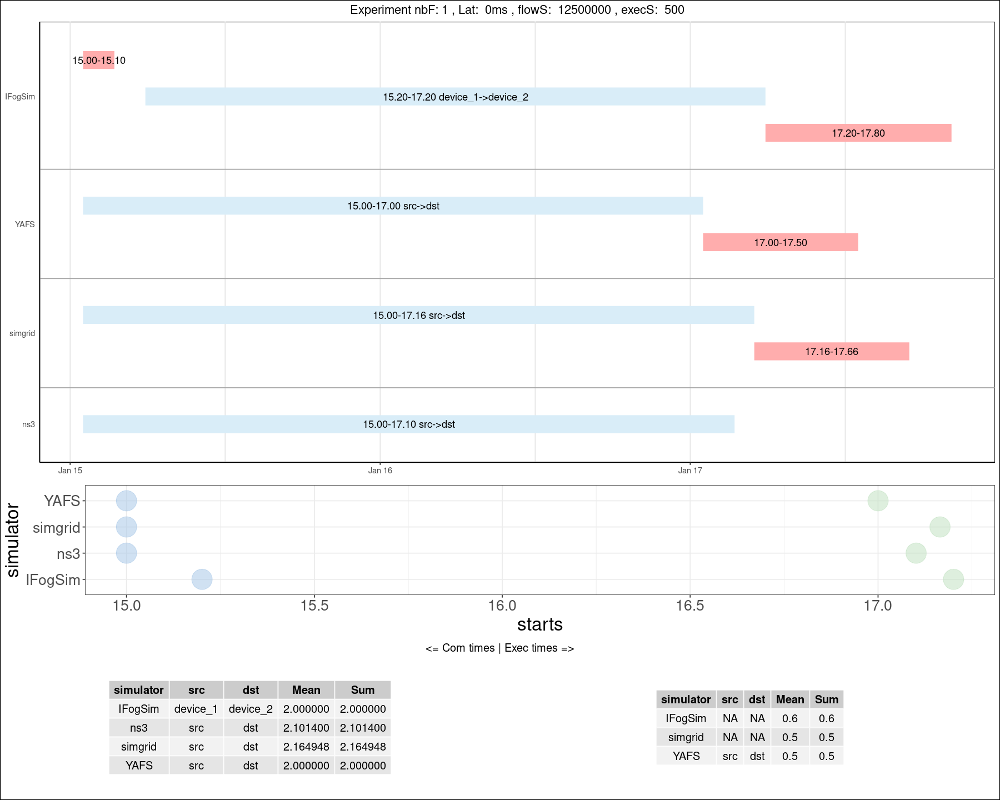

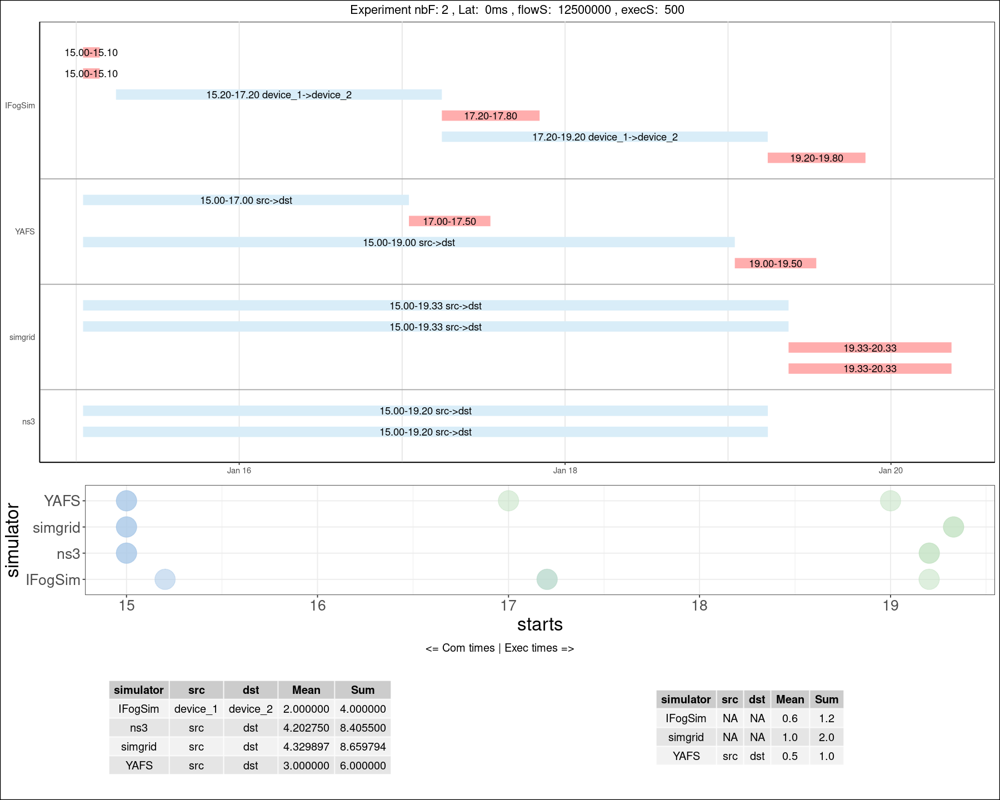

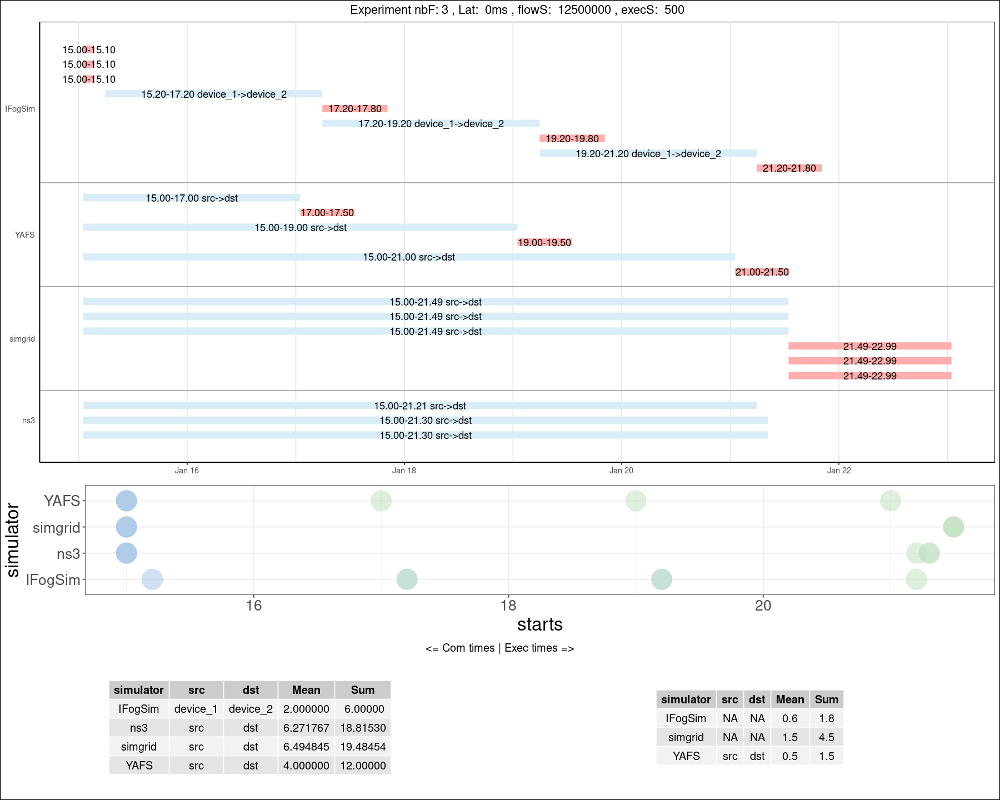

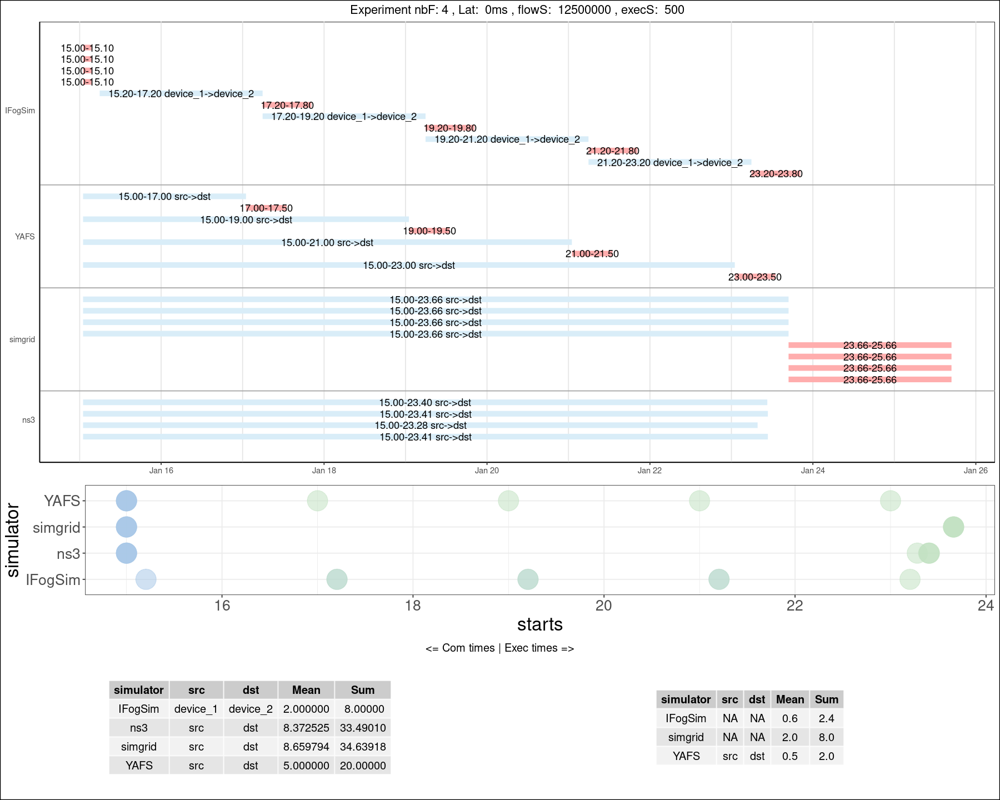

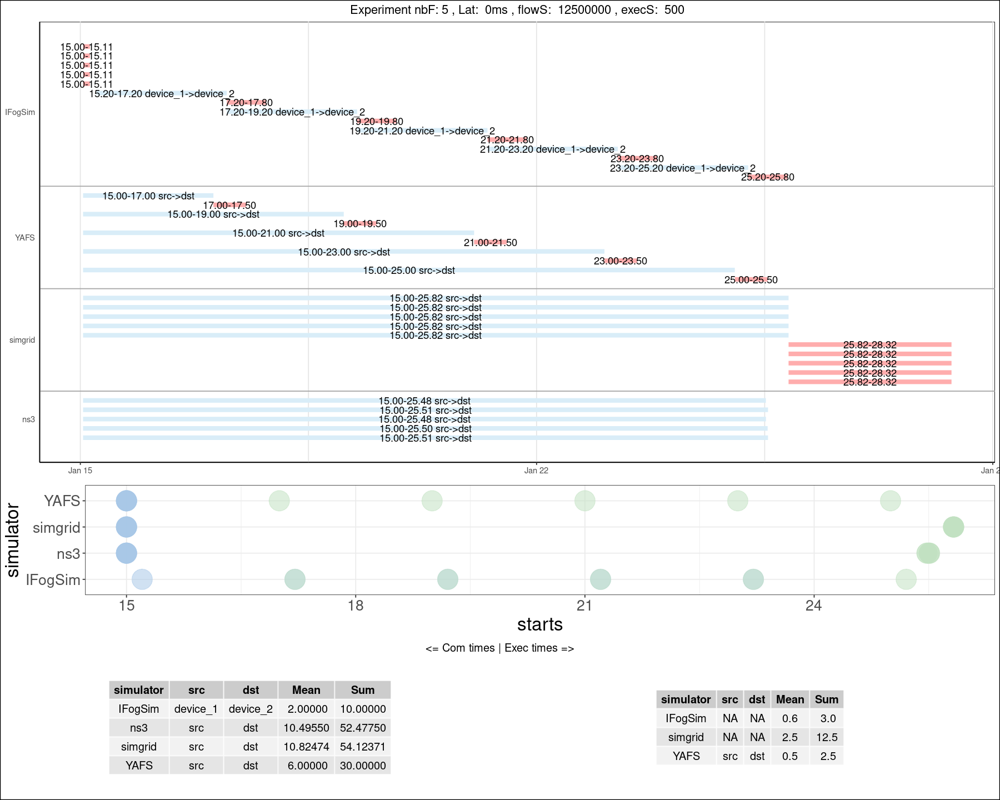

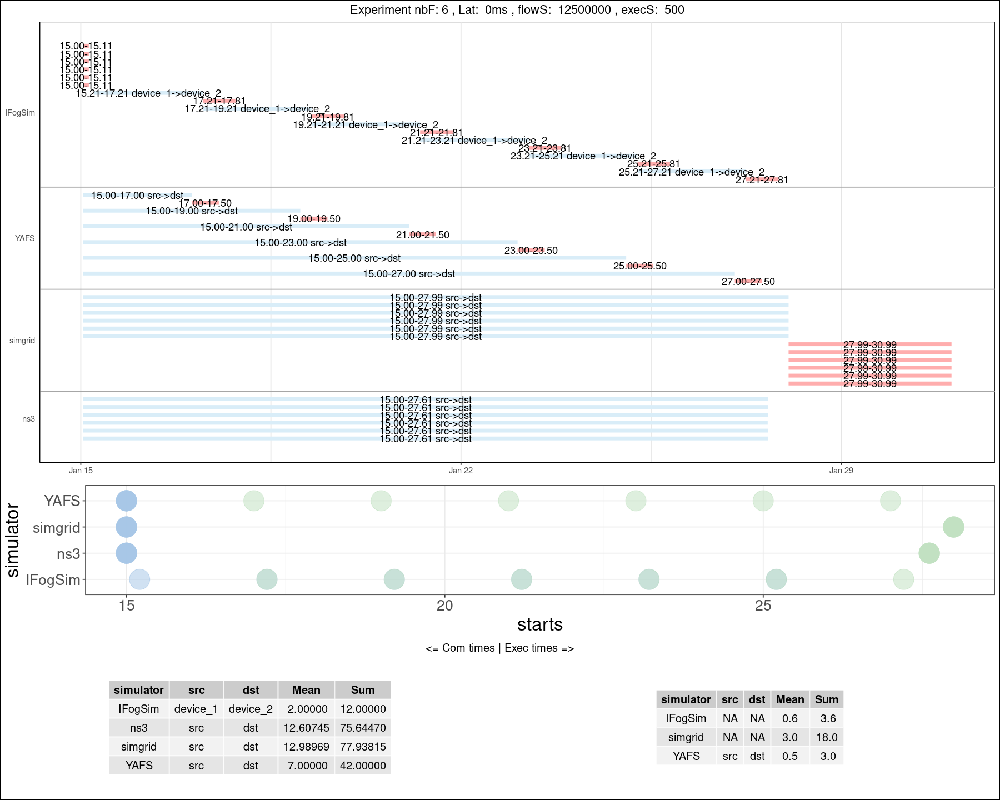

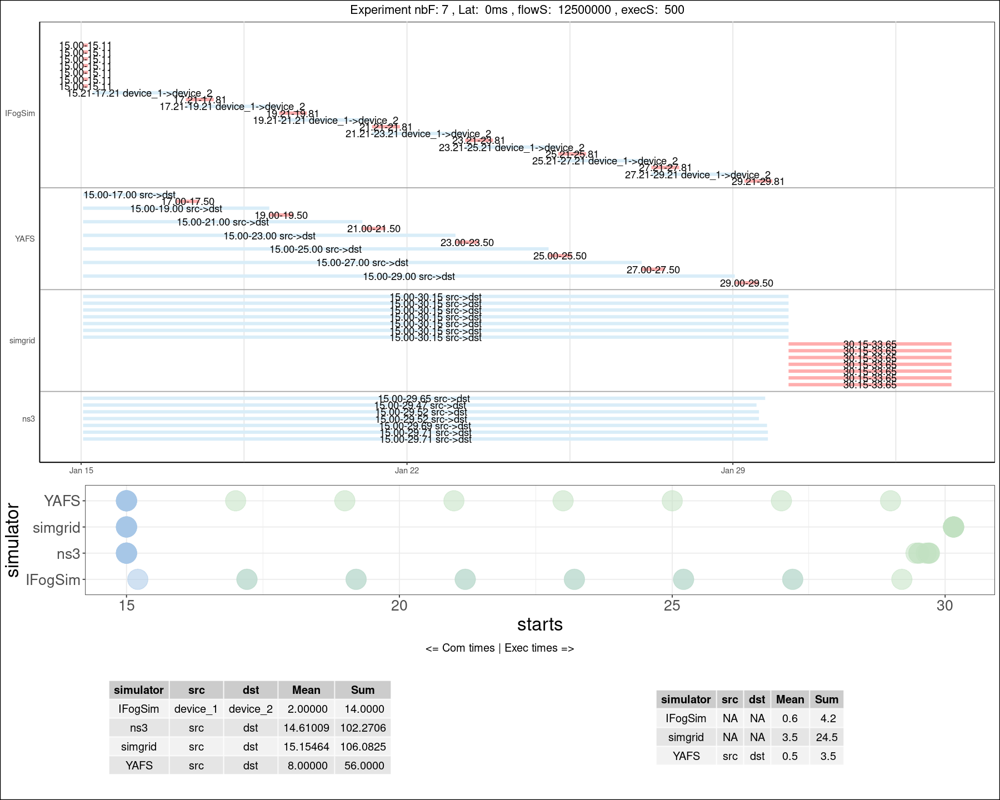

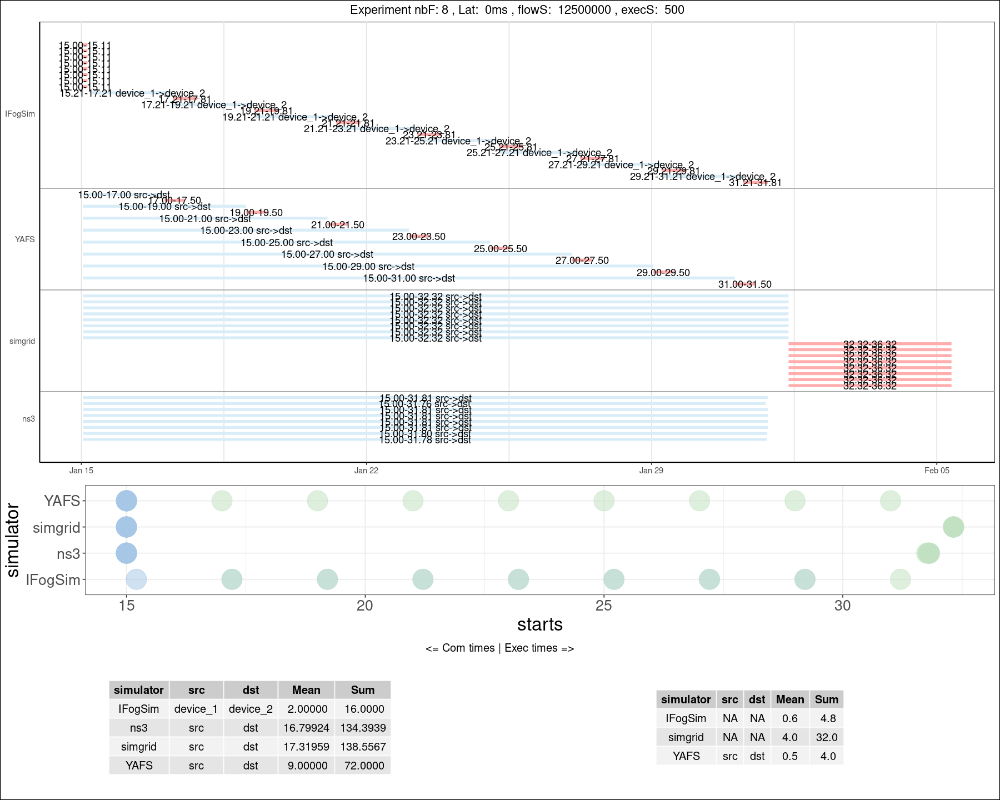

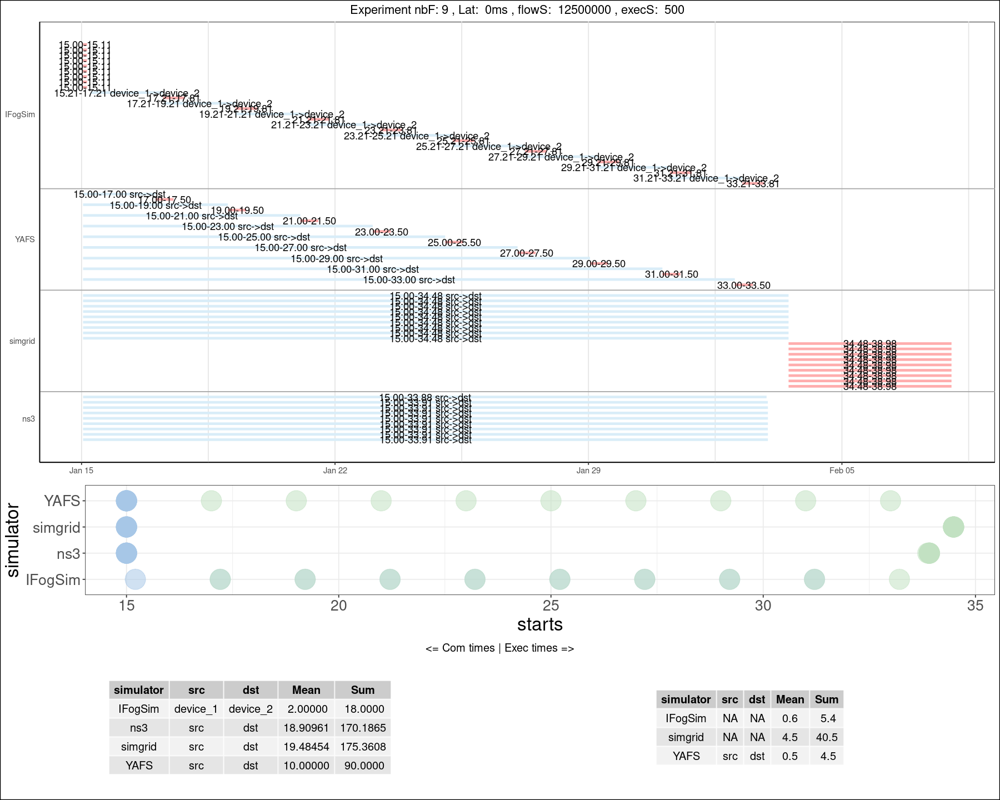

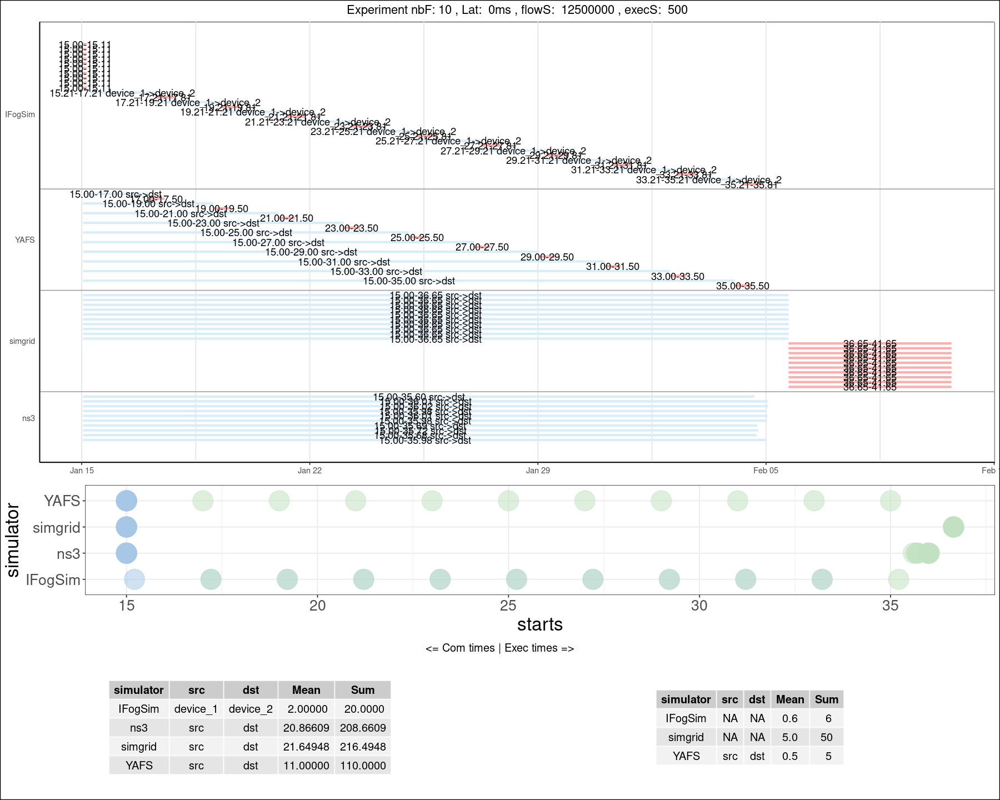

In [12]:

data <- as_tibble(read.csv("./res1Hop-net.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_2"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

<a id='1HOP_EXEC'></a>
# 1.2 1hop-exec

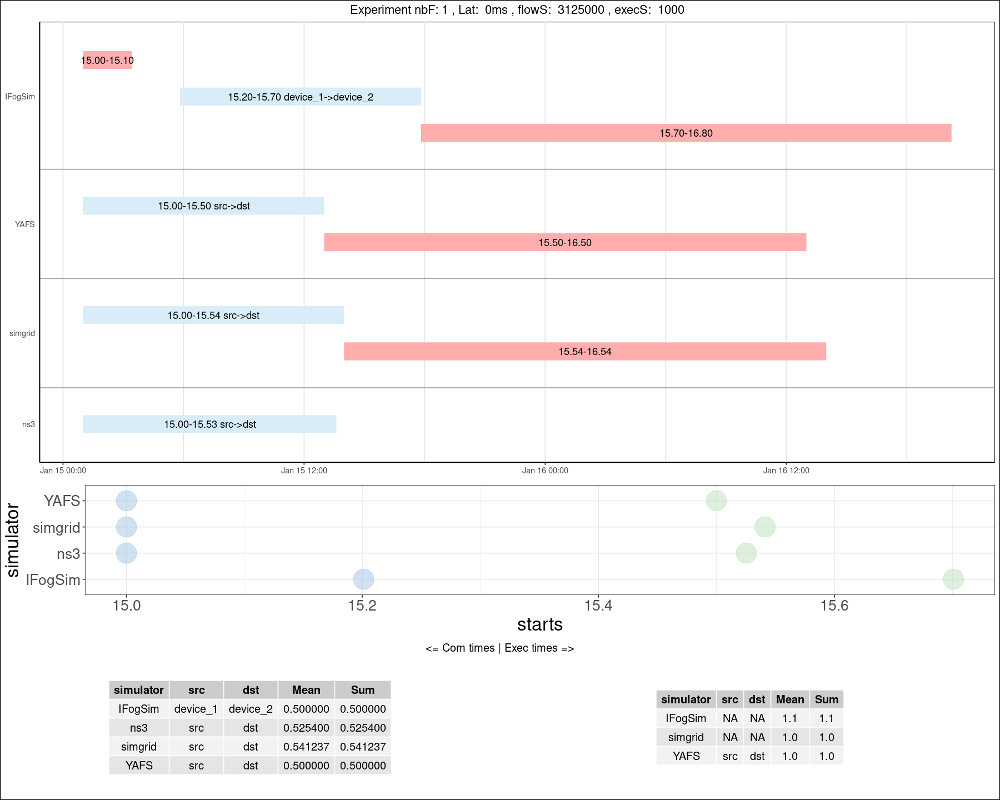

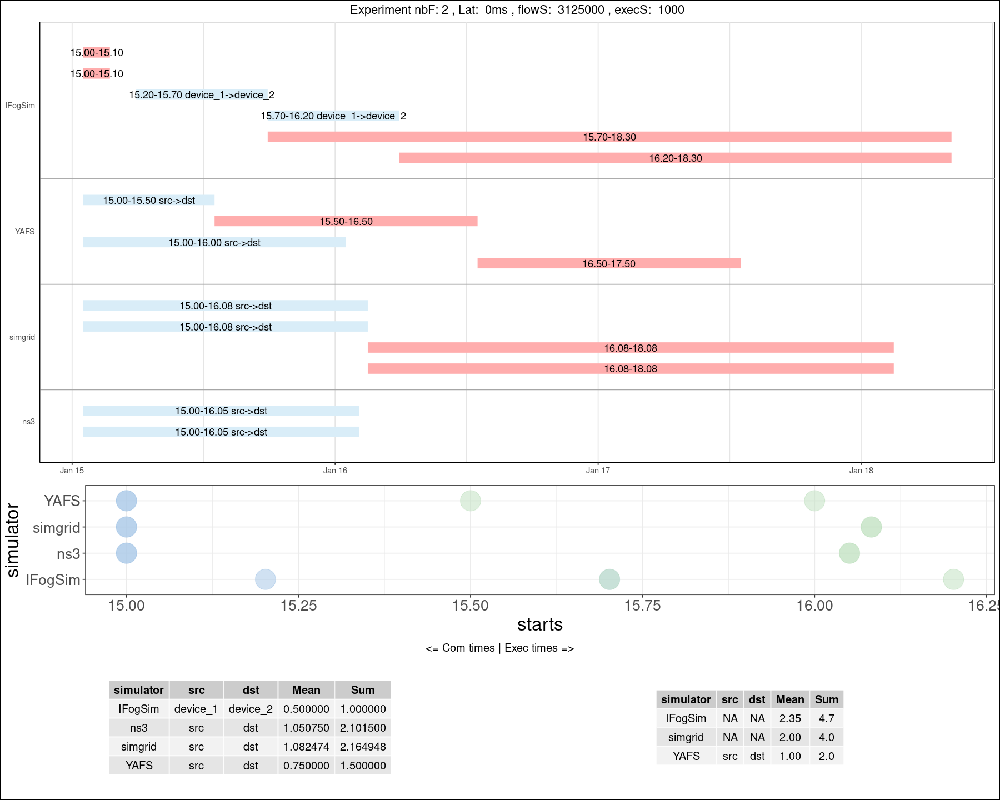

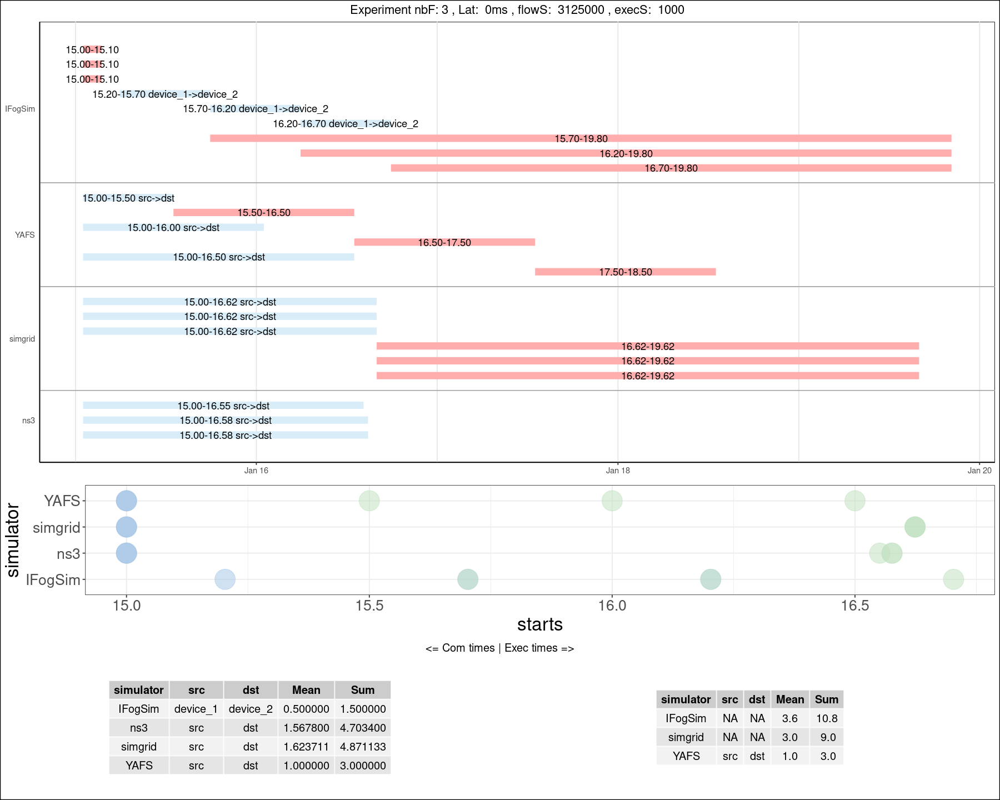

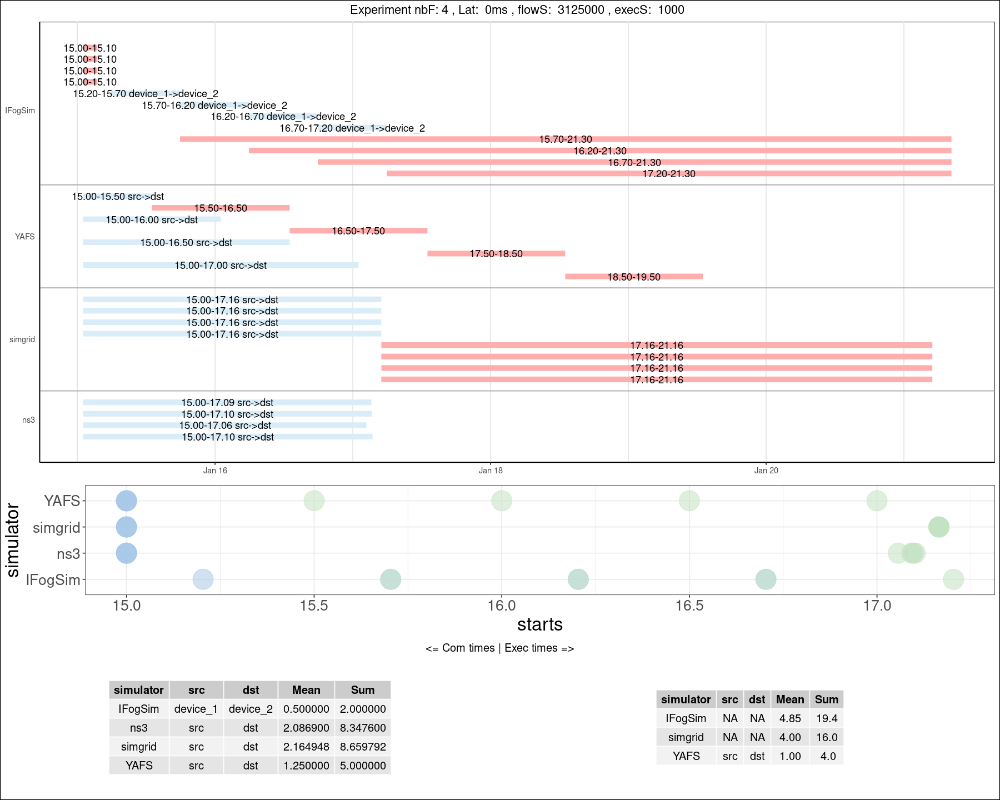

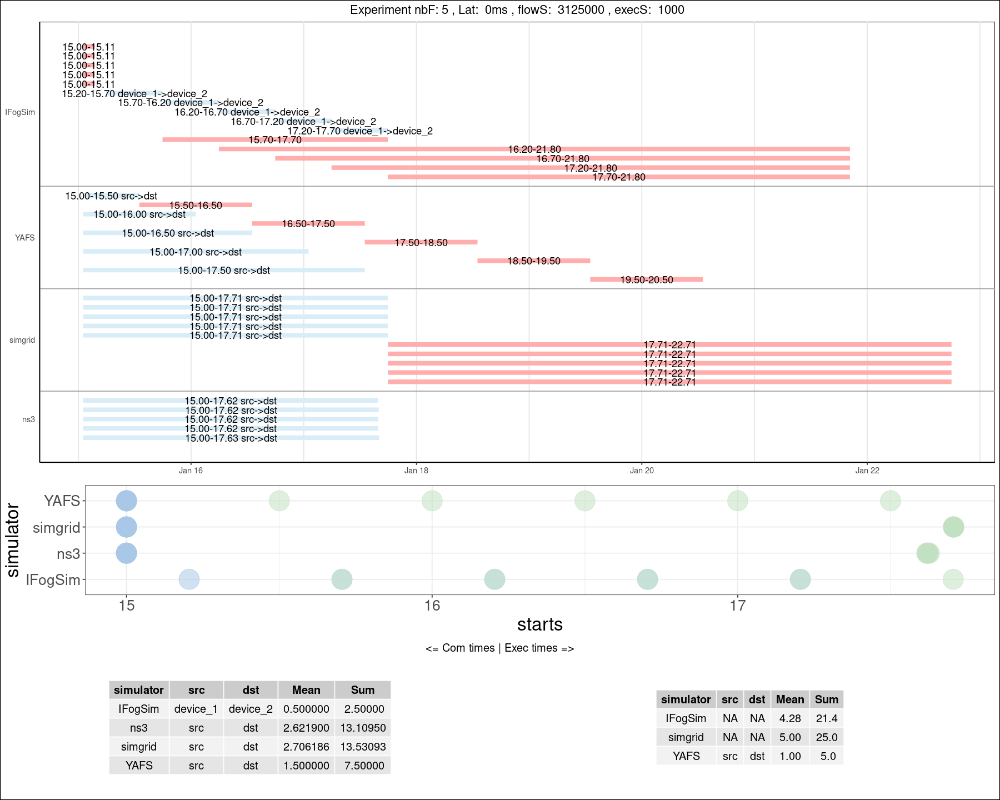

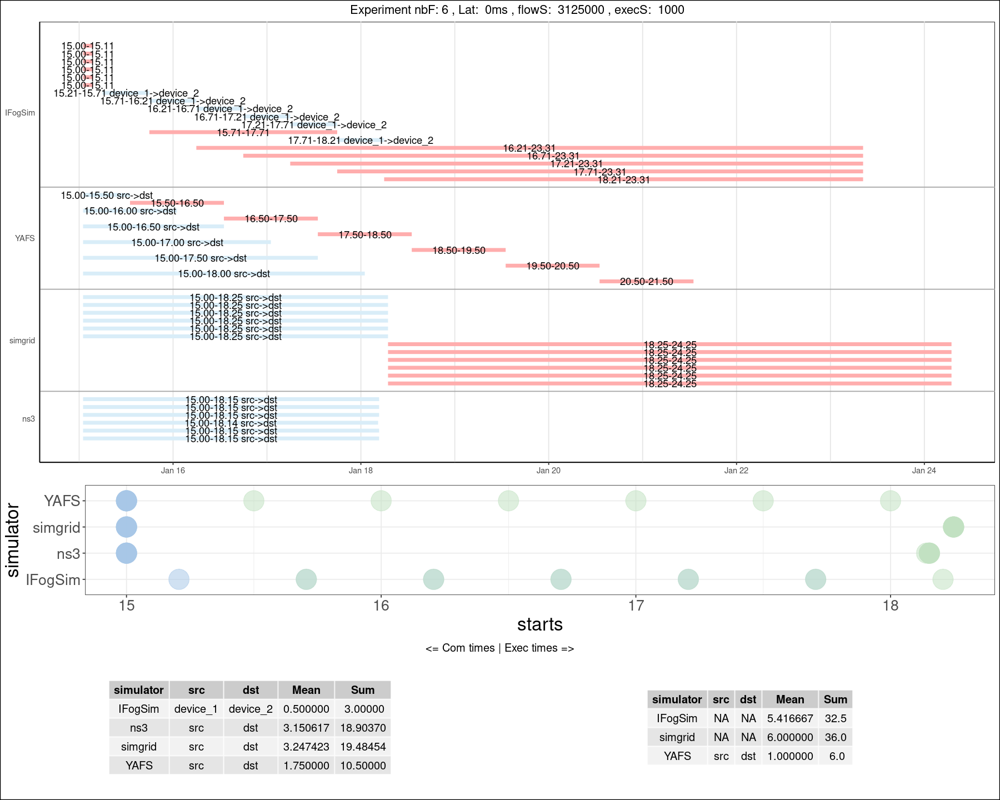

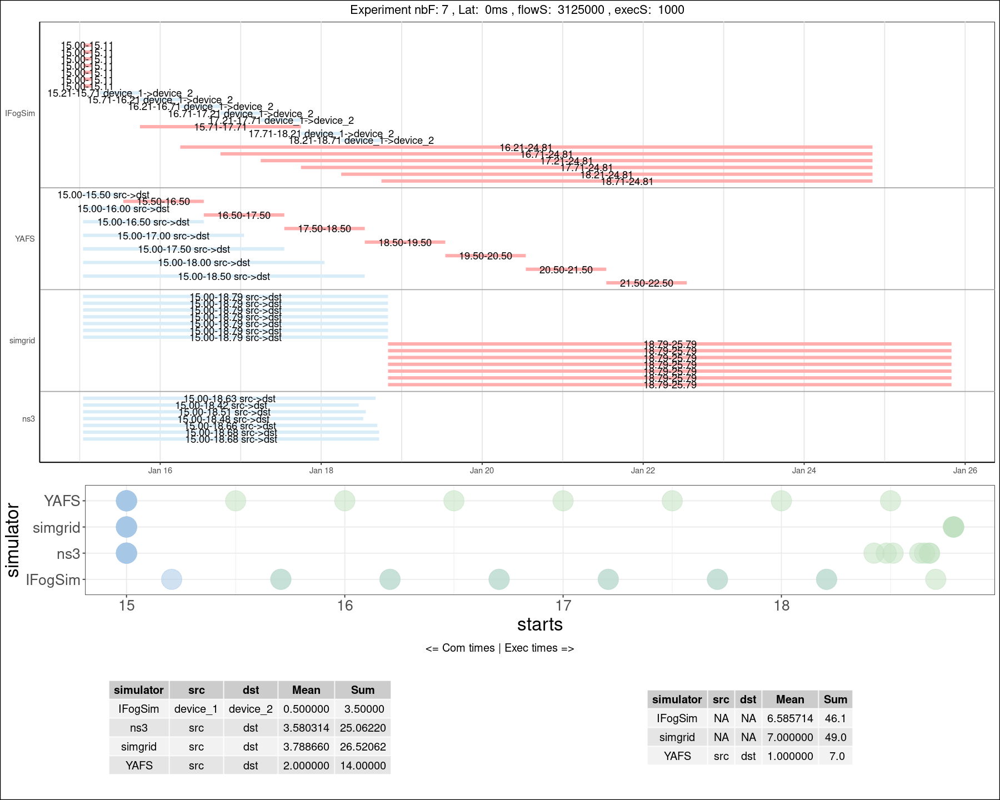

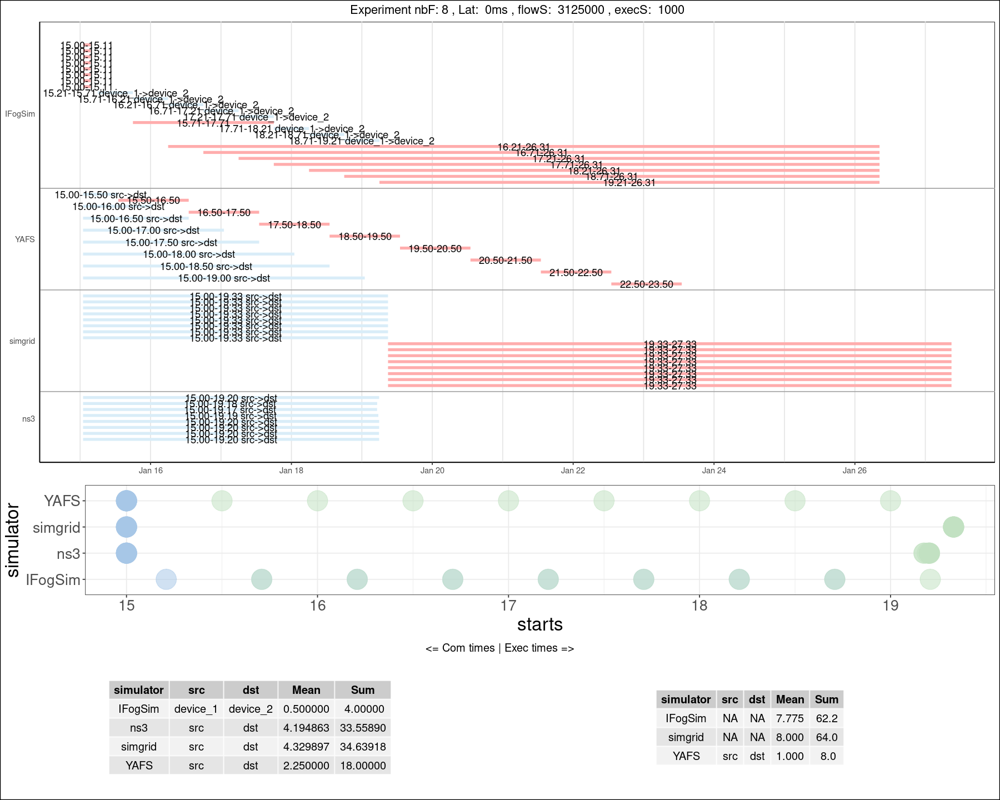

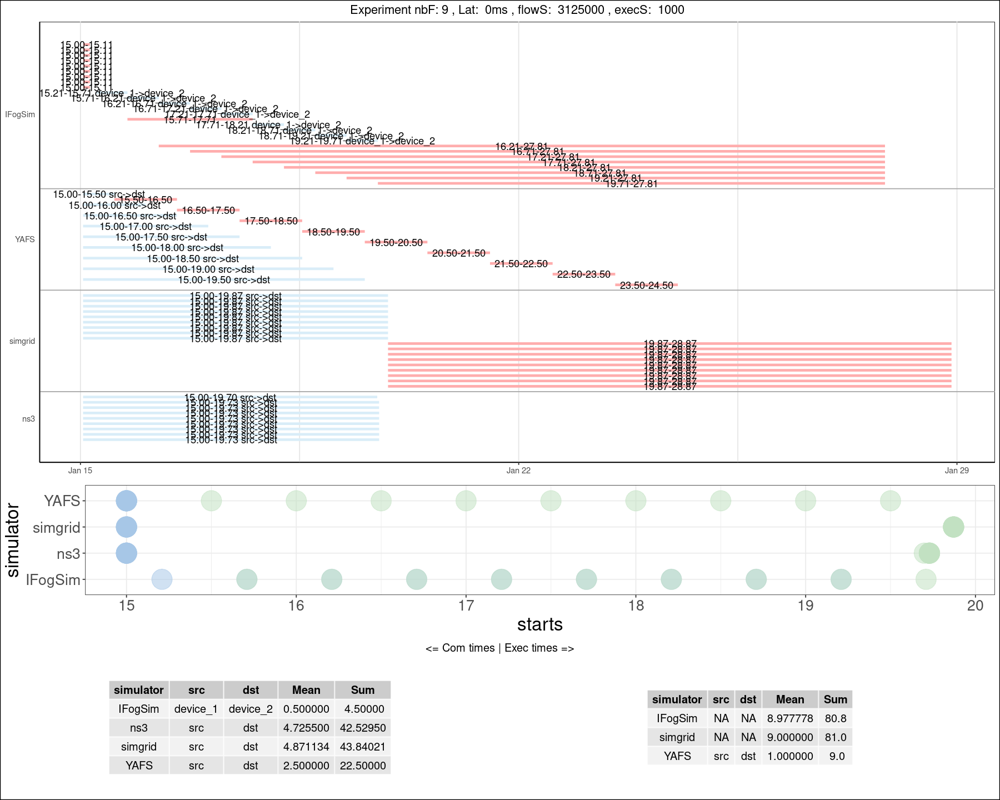

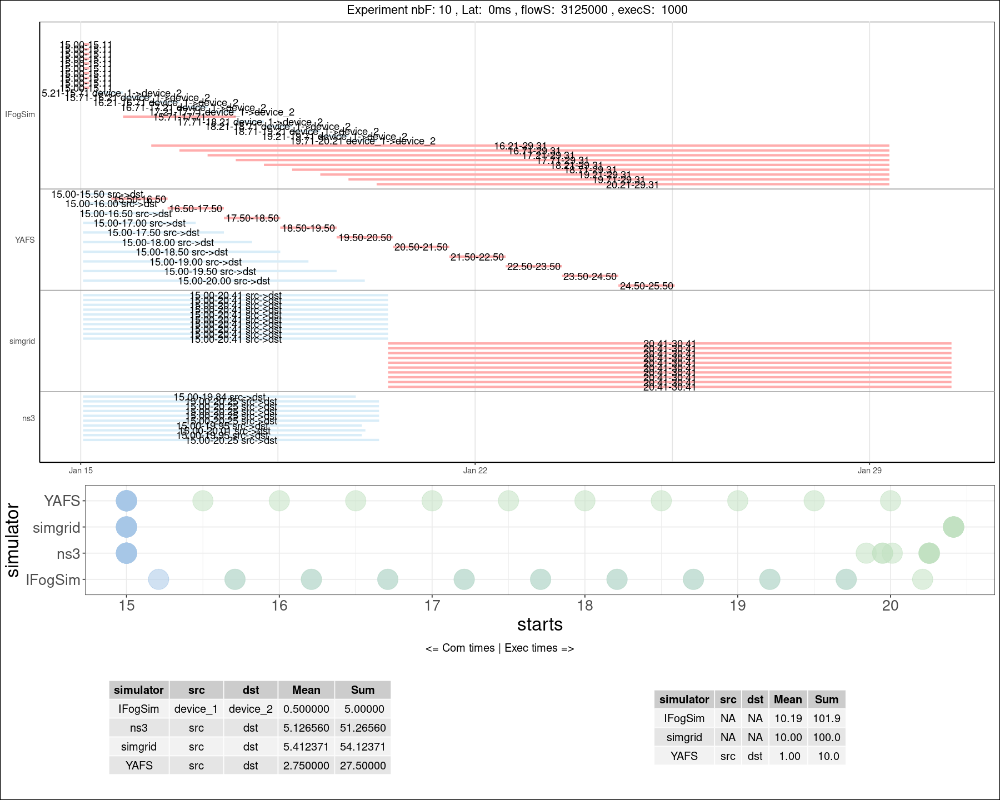

In [11]:

data <- as_tibble(read.csv("./res1Hop-exec.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_2"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

<a id='2HOPS_NET'></a>
# 2.1 2hops-net

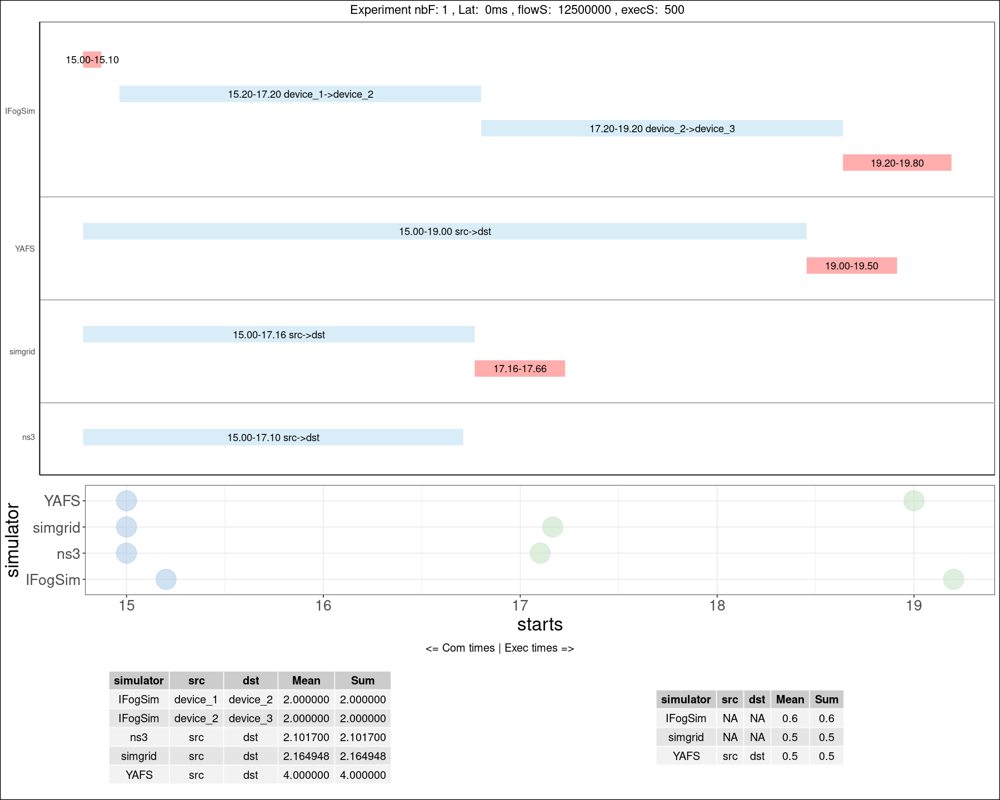

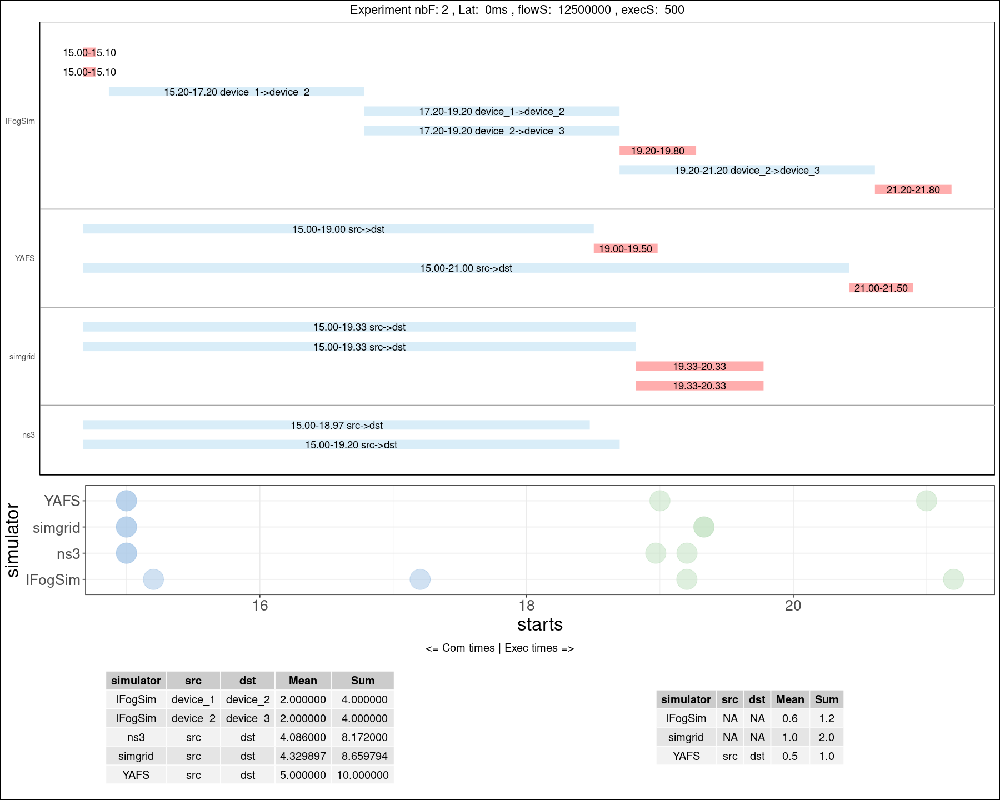

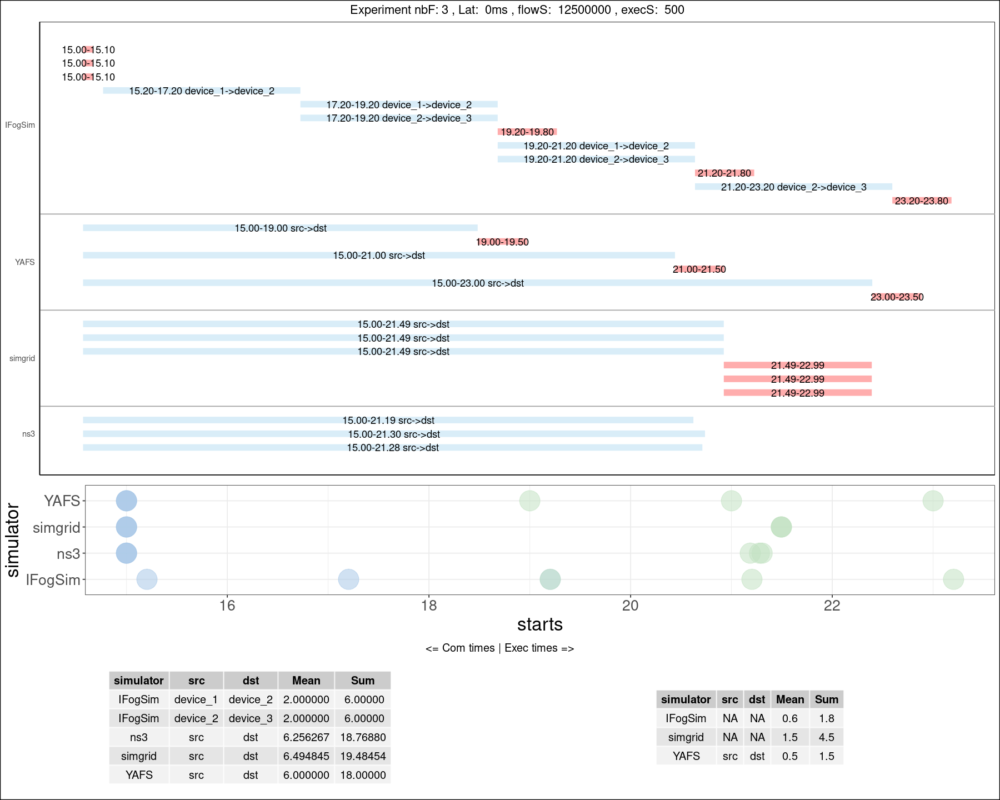

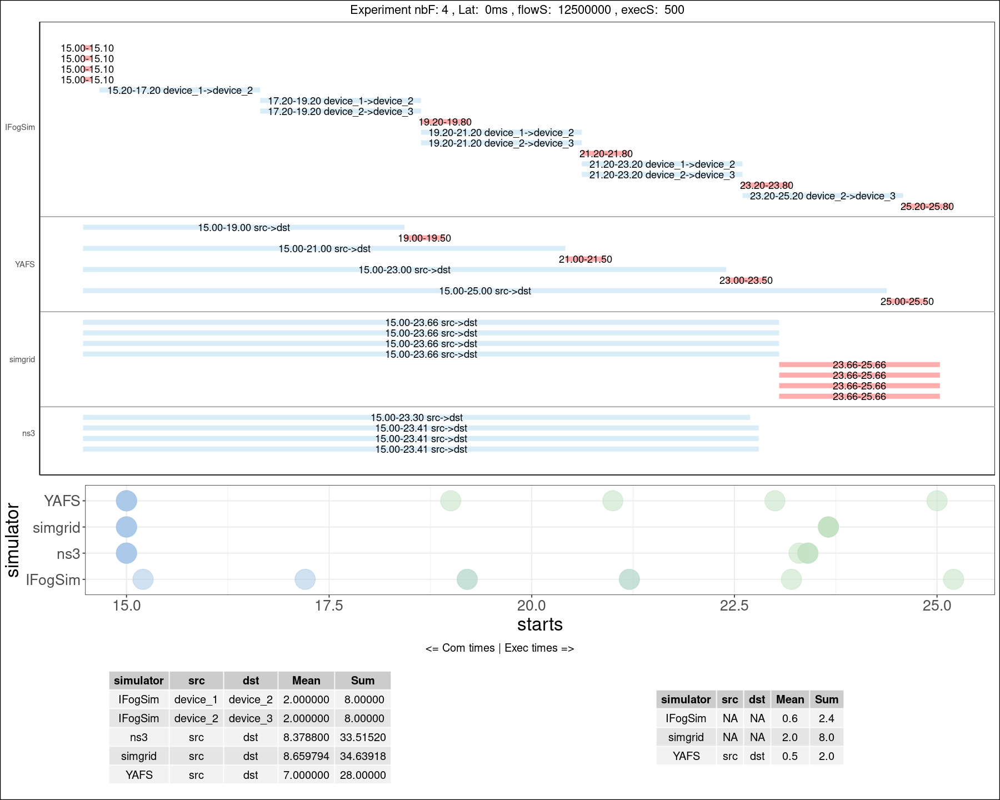

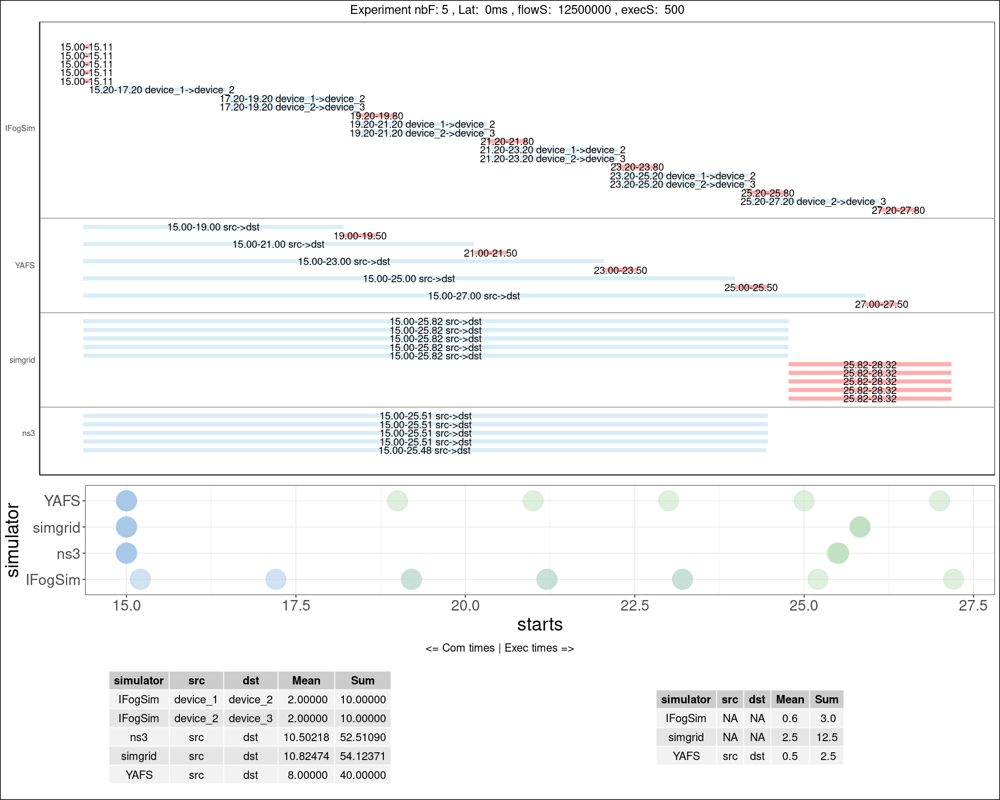

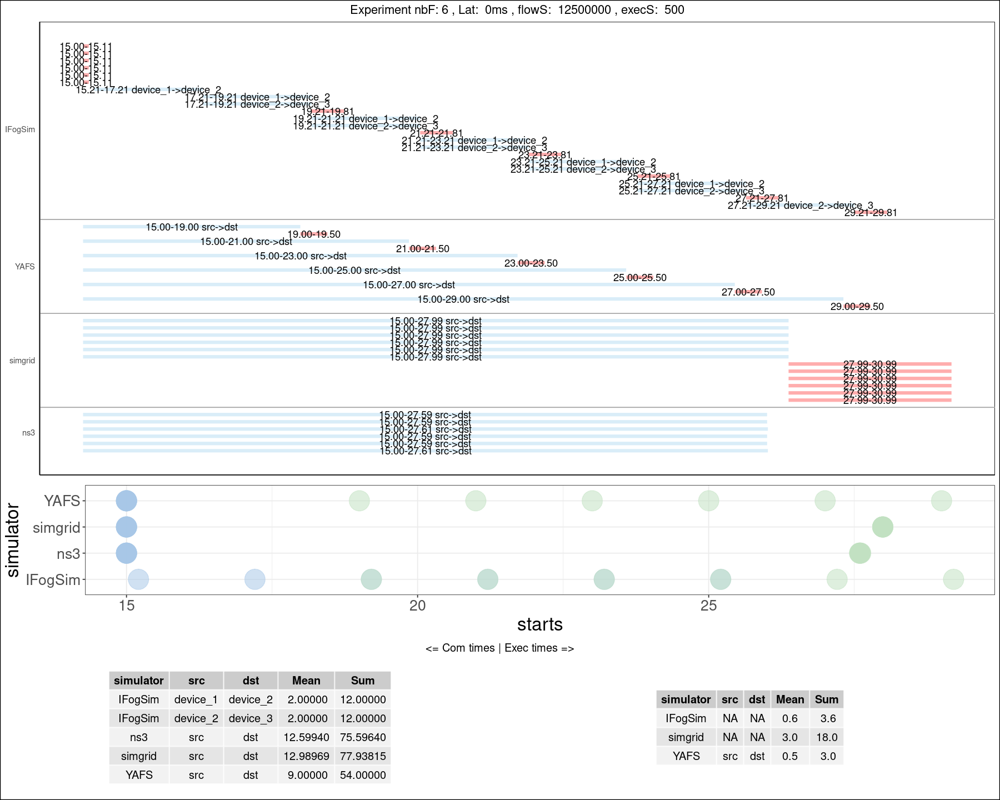

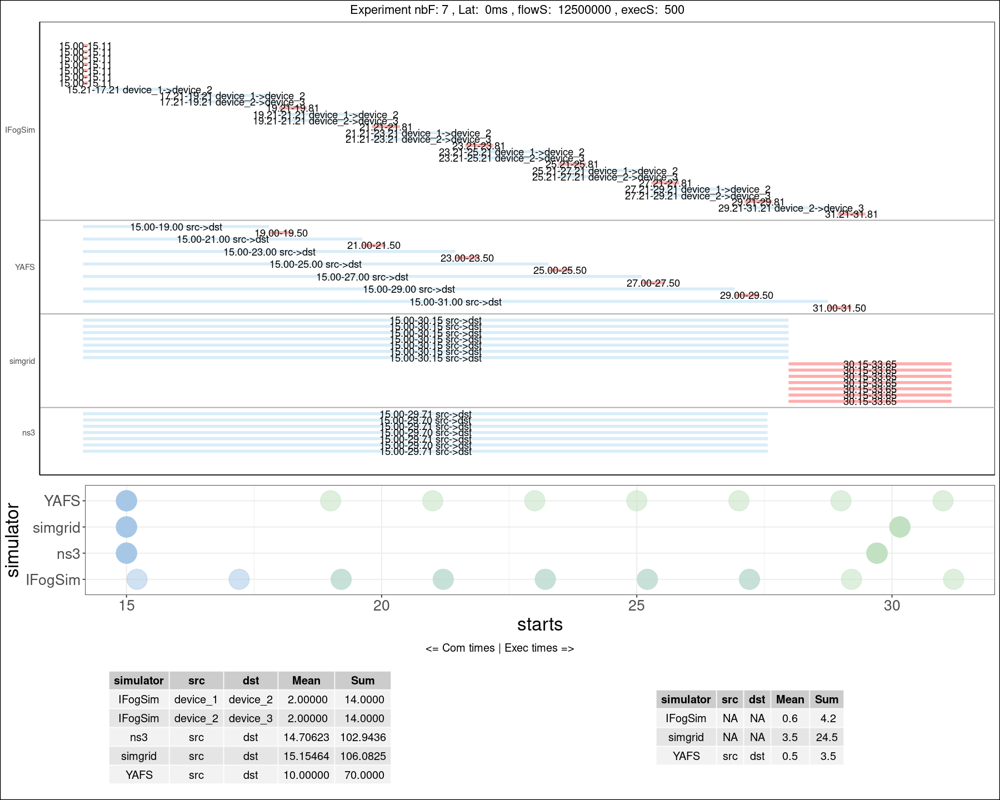

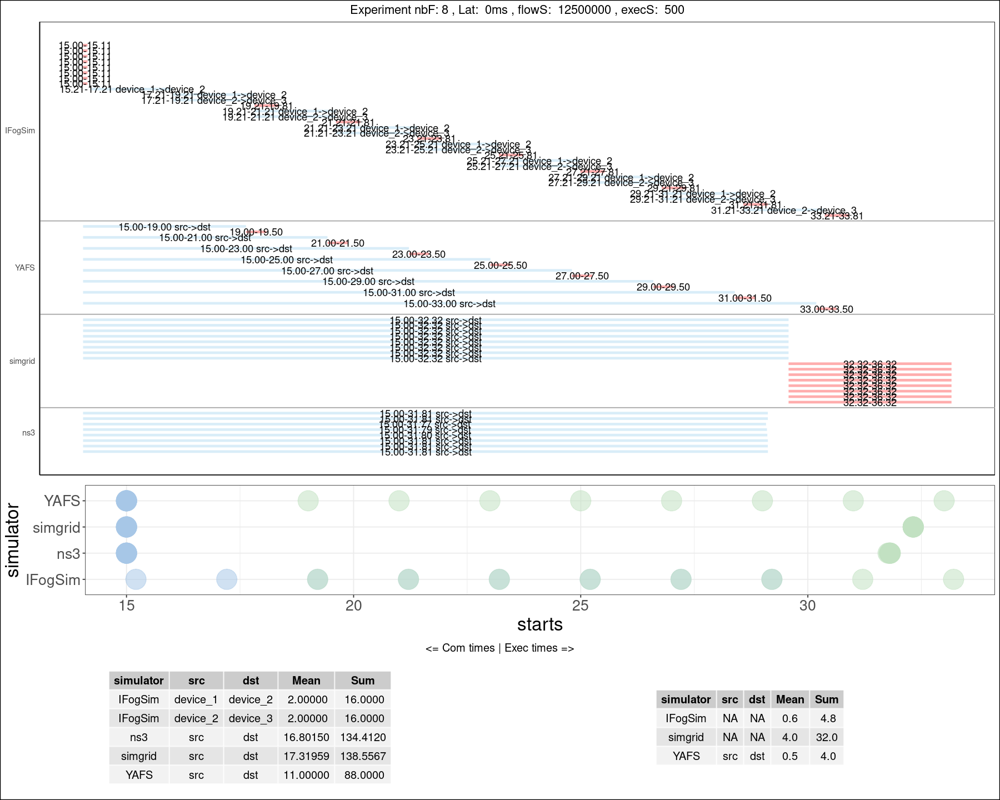

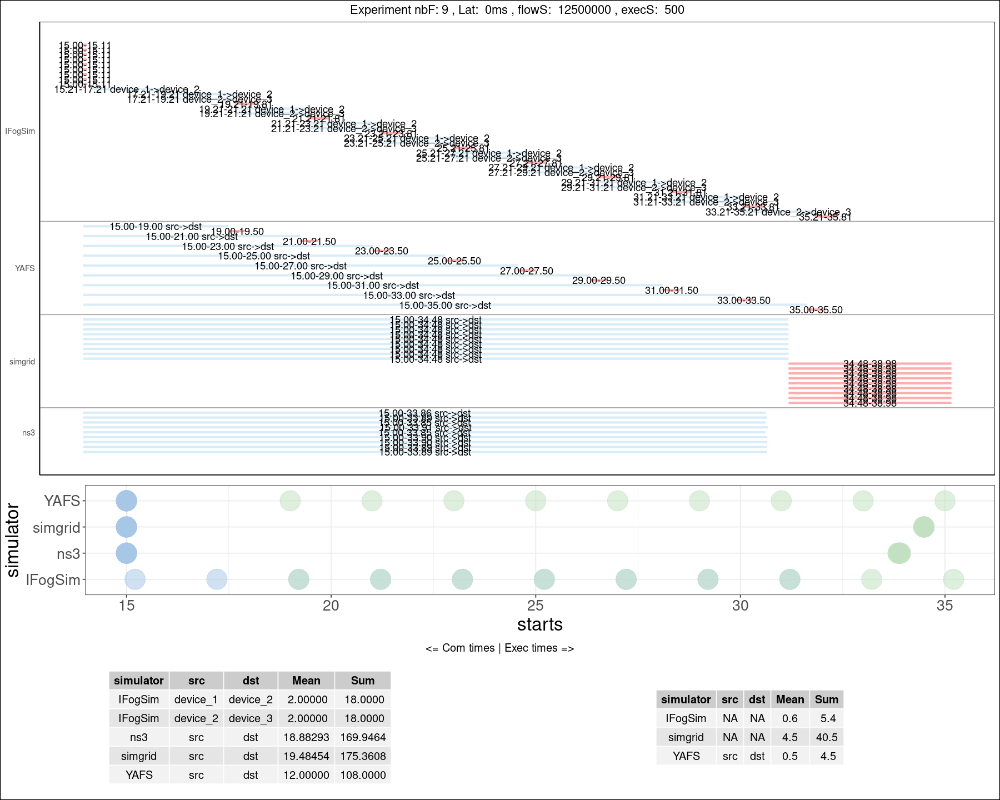

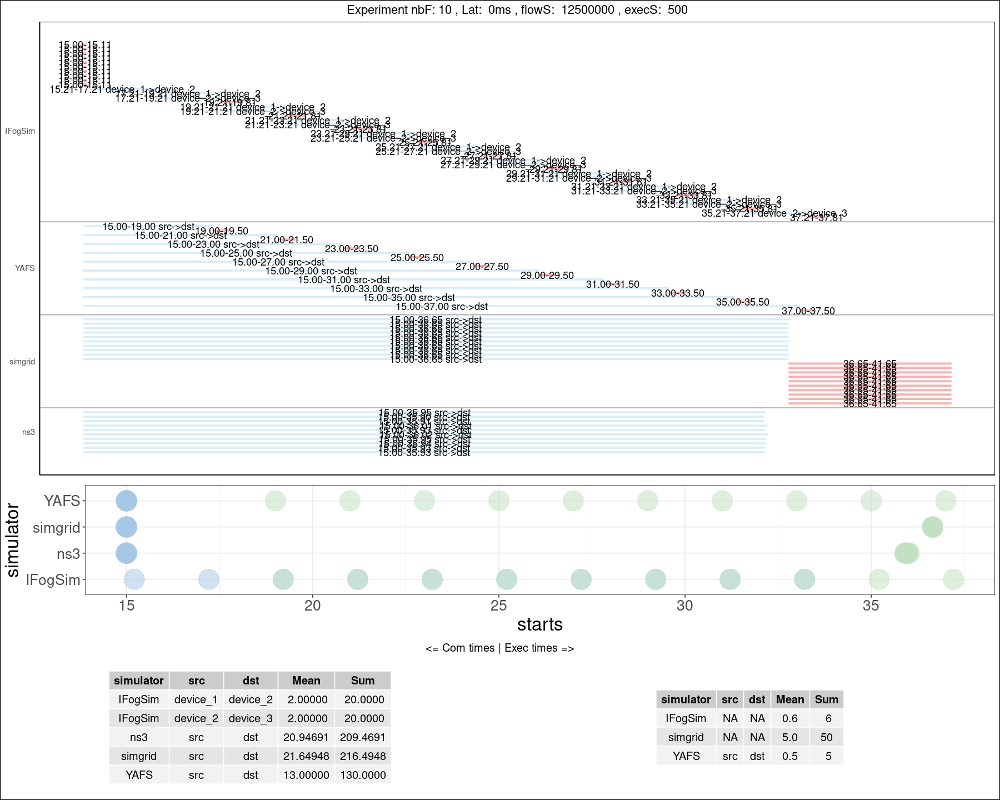

In [7]:

data <- as_tibble(read.csv("./res2Hop-net.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)
#print(data)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{

    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))+ 
        scale_x_datetime(date_breaks = "year", date_labels = "%s")
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_3"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

<a id='2HOPS_EXEC'></a>
# 2.2 2hops-exec

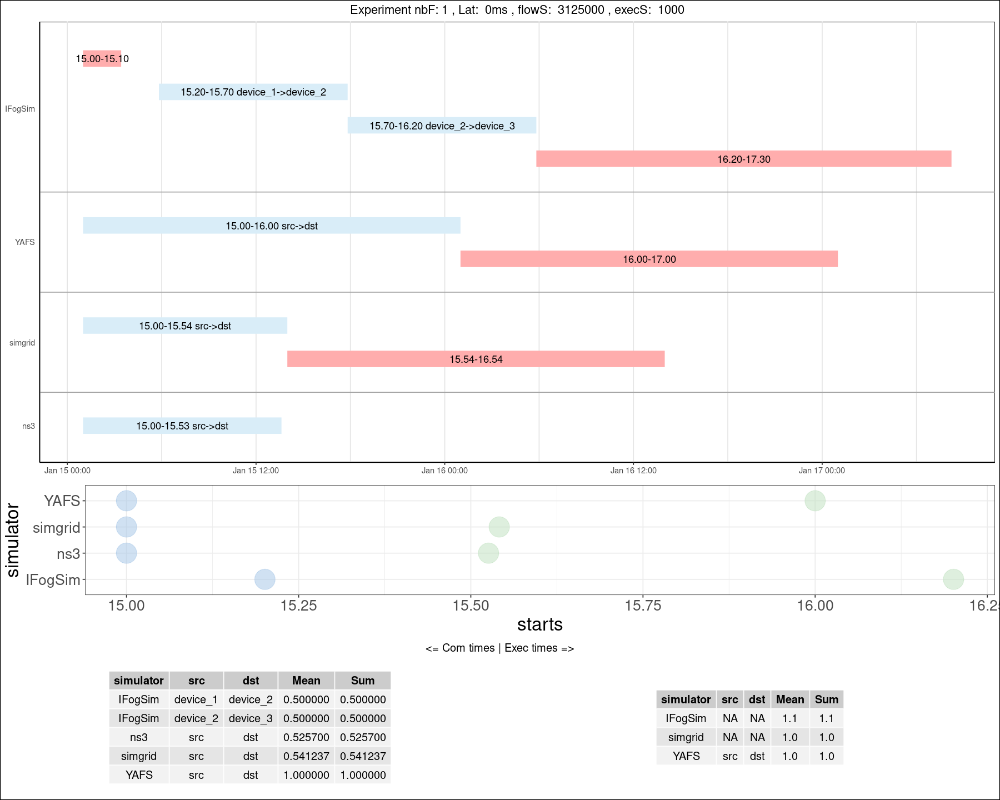

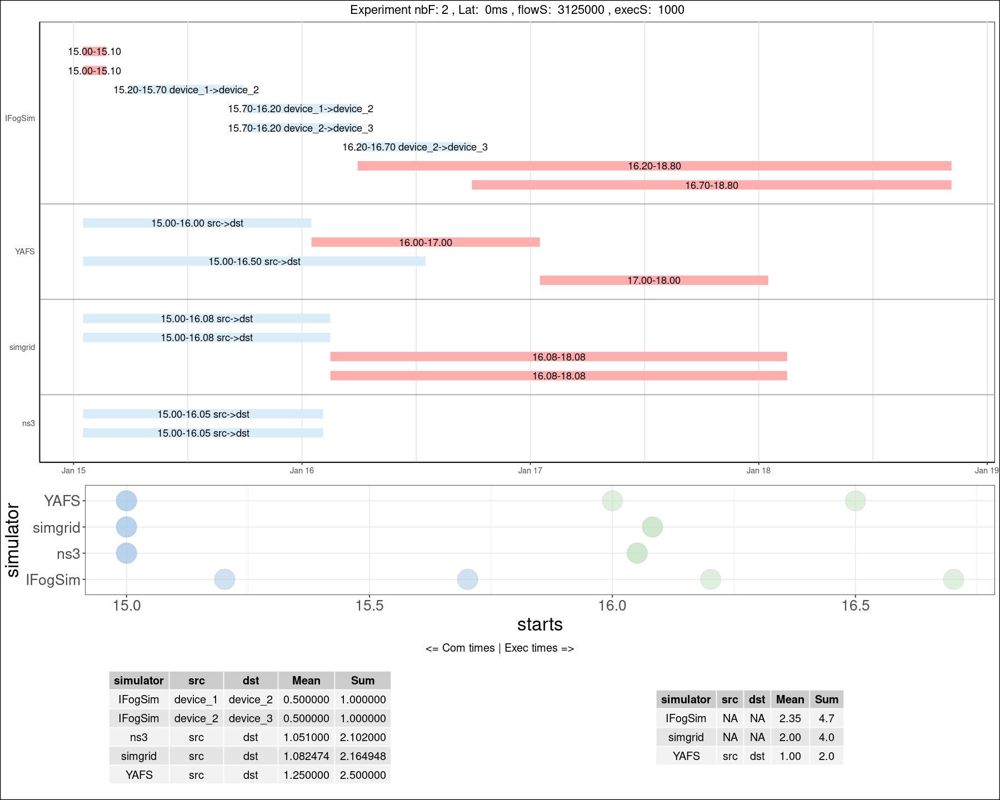

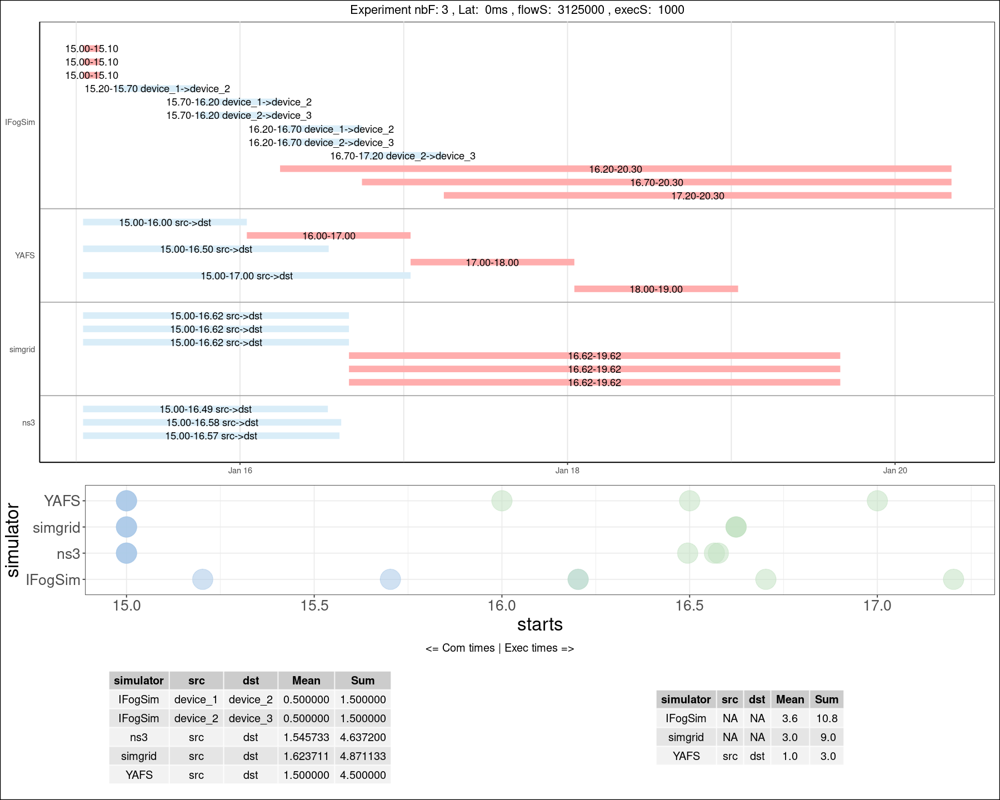

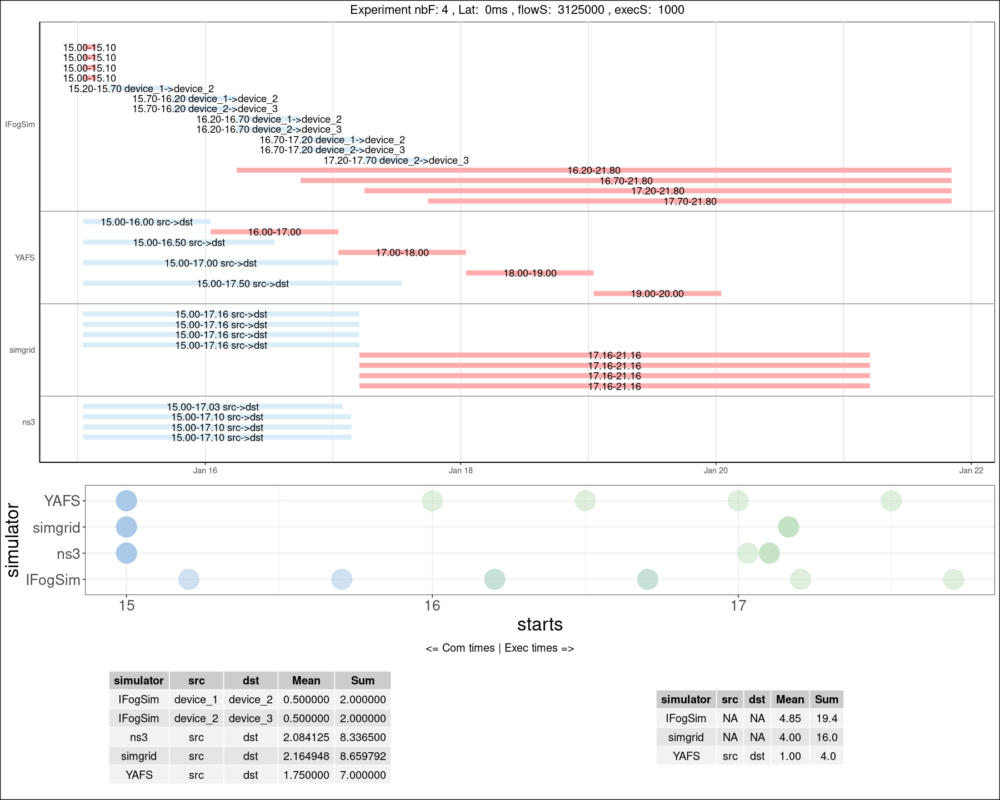

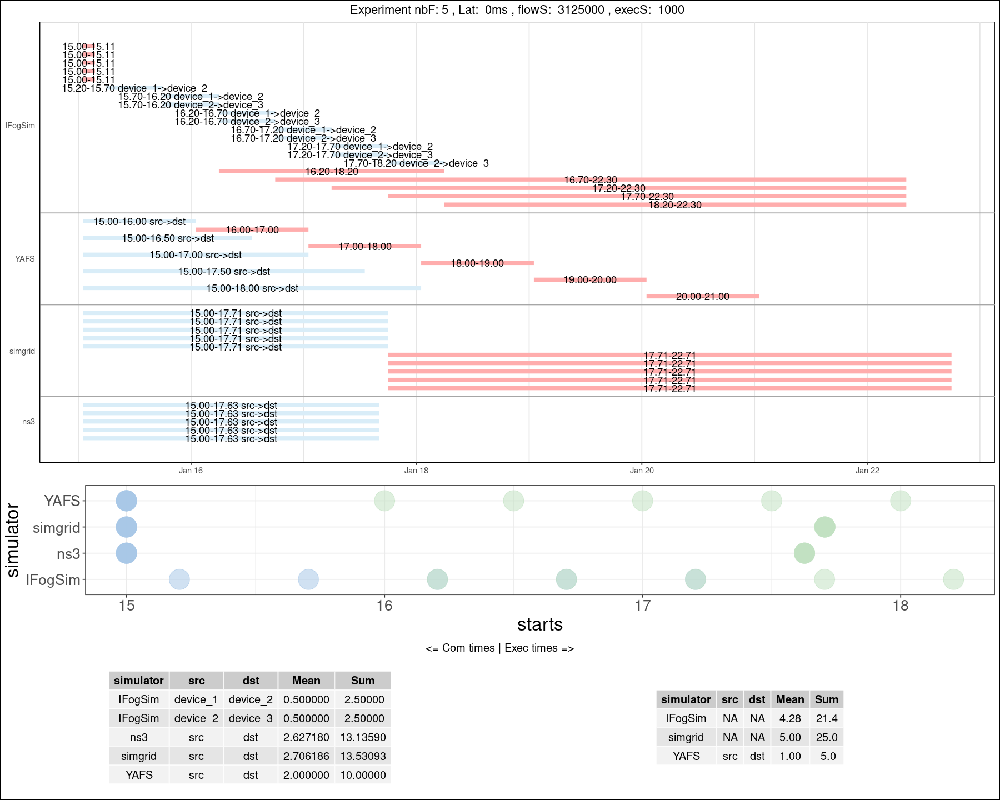

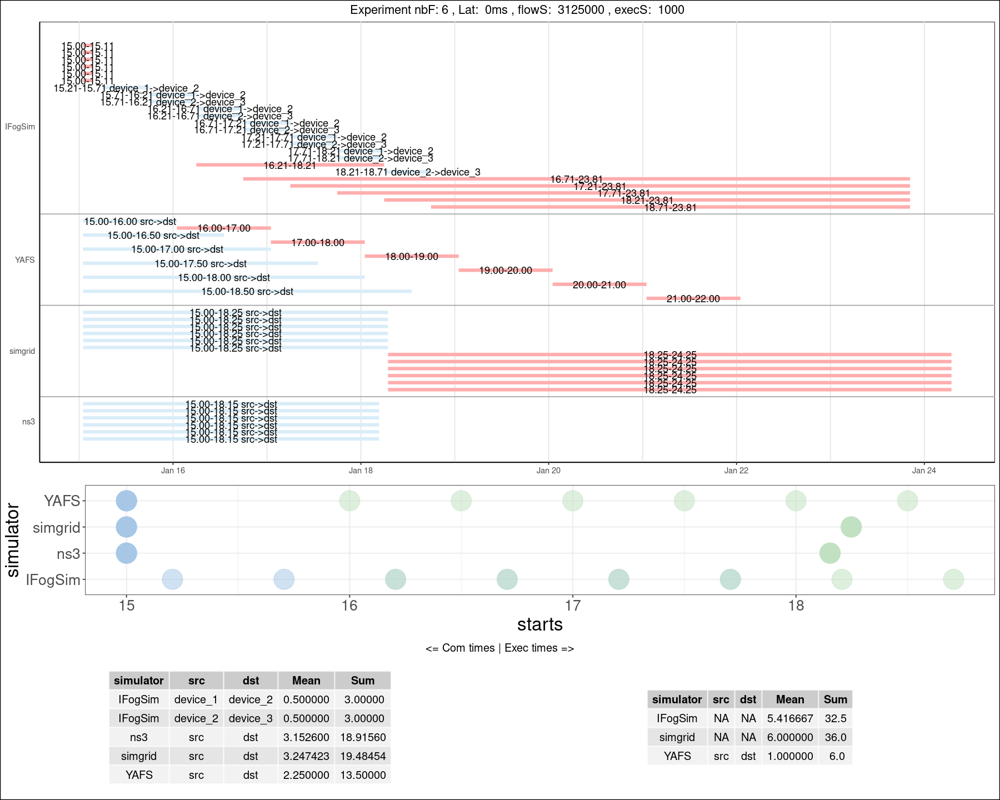

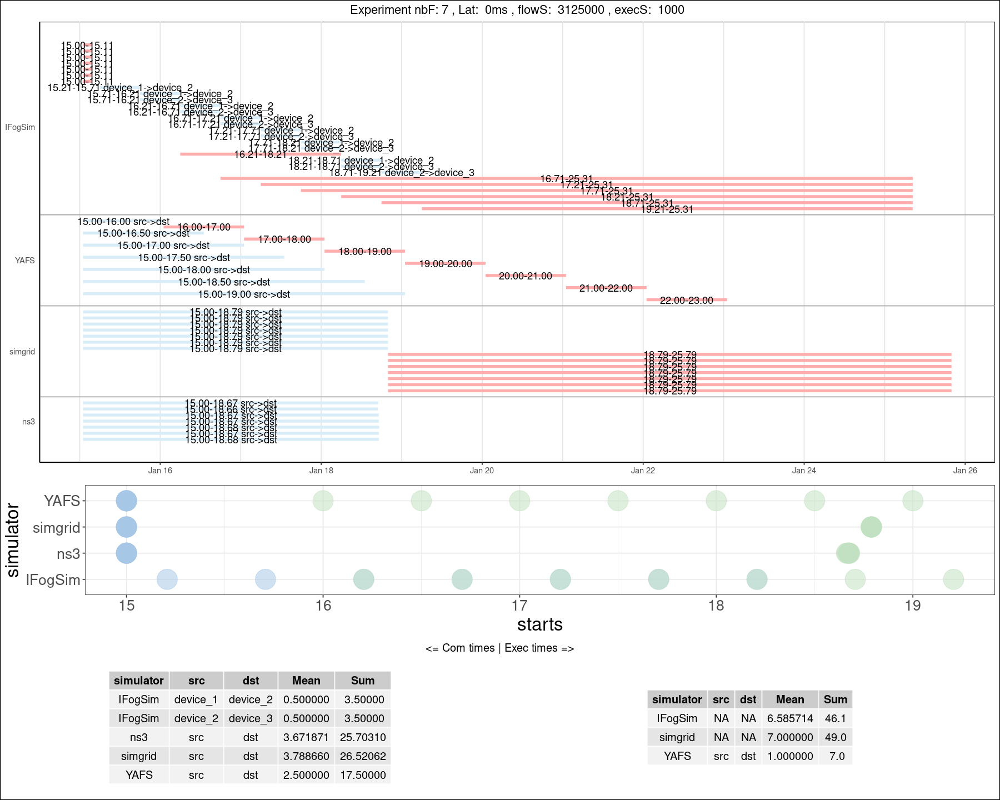

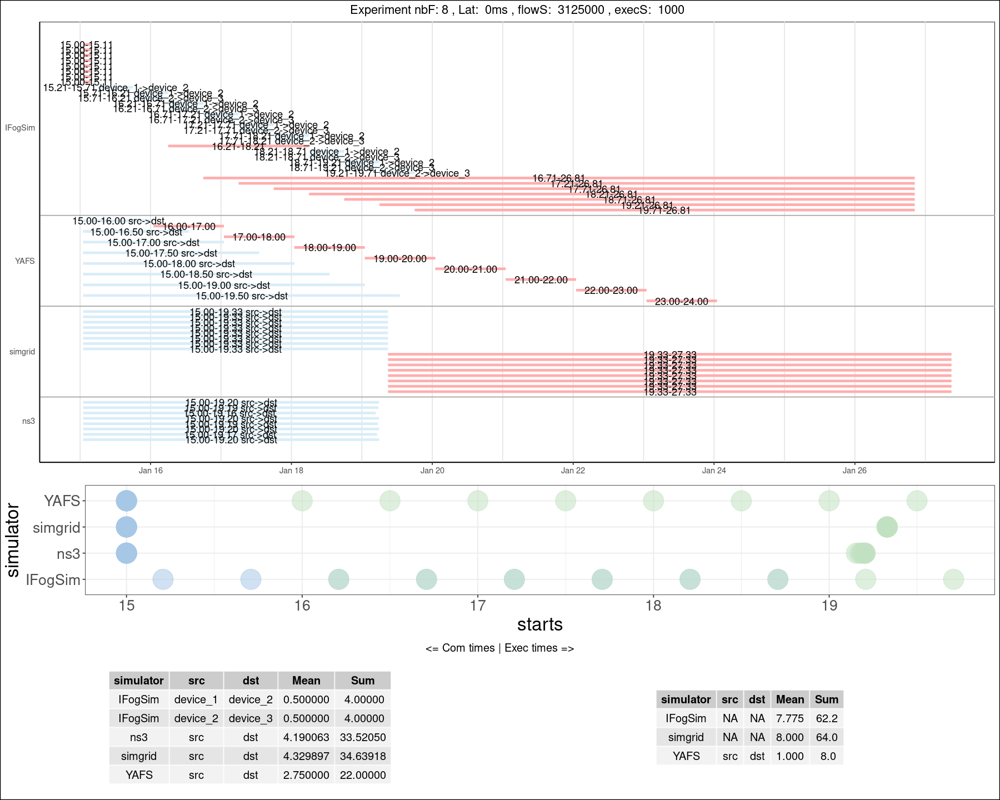

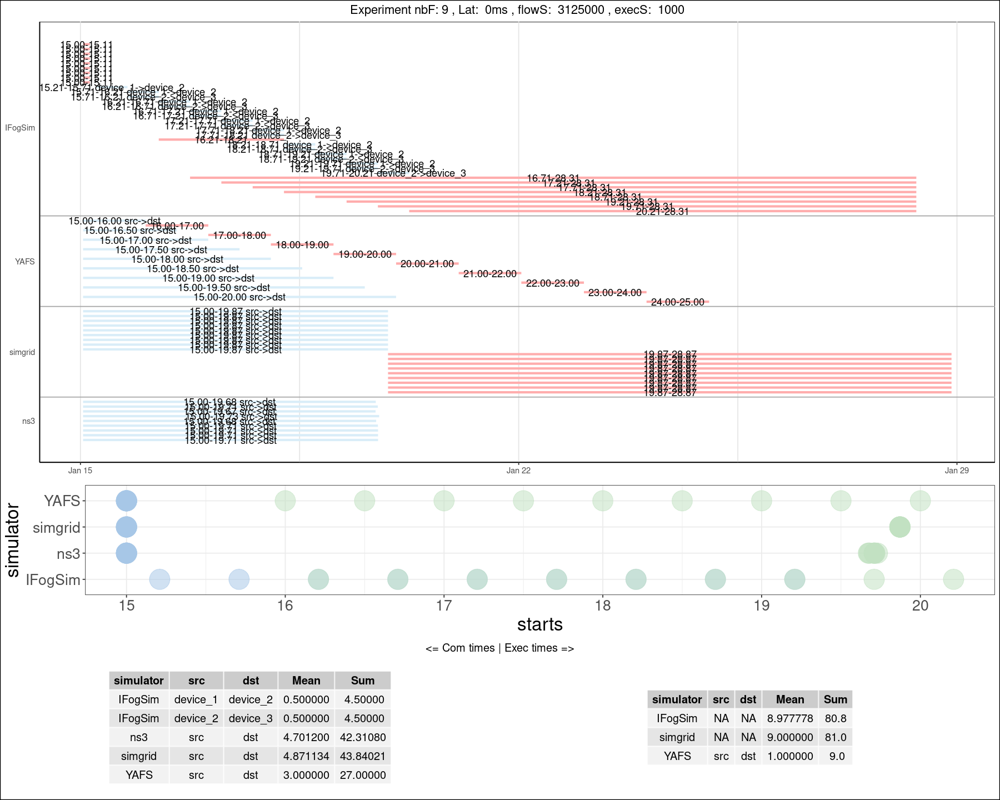

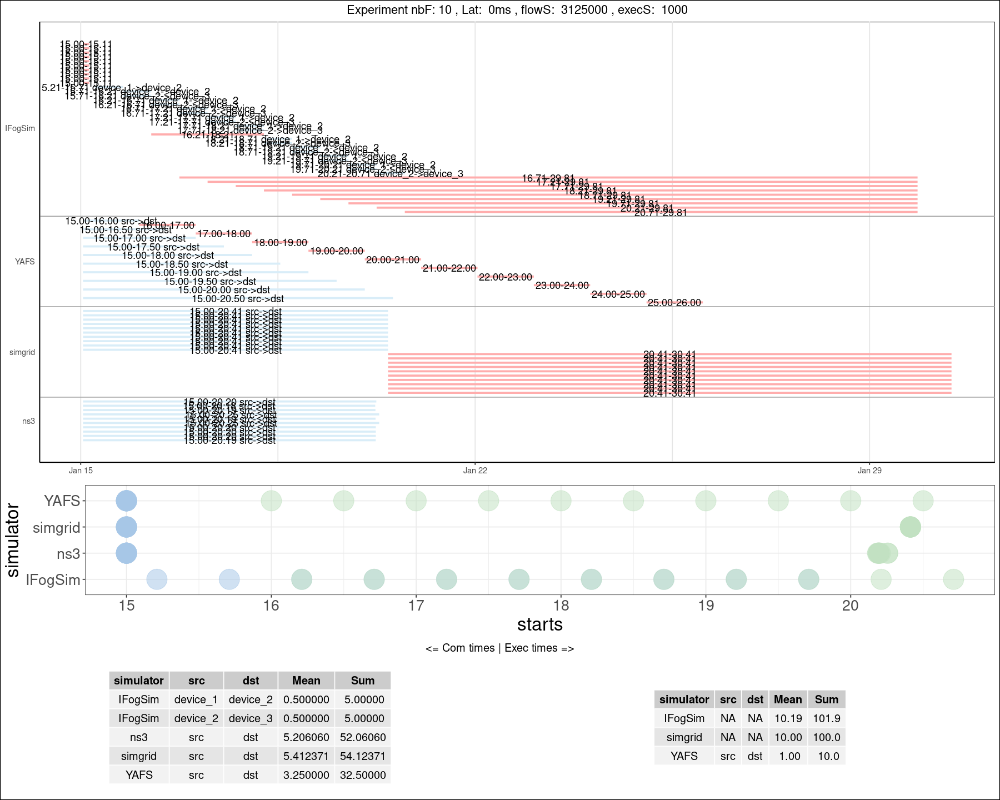

In [16]:

data <- as_tibble(read.csv("./res2Hop-exec.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)
#print(data)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{

    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_3"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

<a id='2HOPS_LAT'></a>
# 2.3 2hops-lat

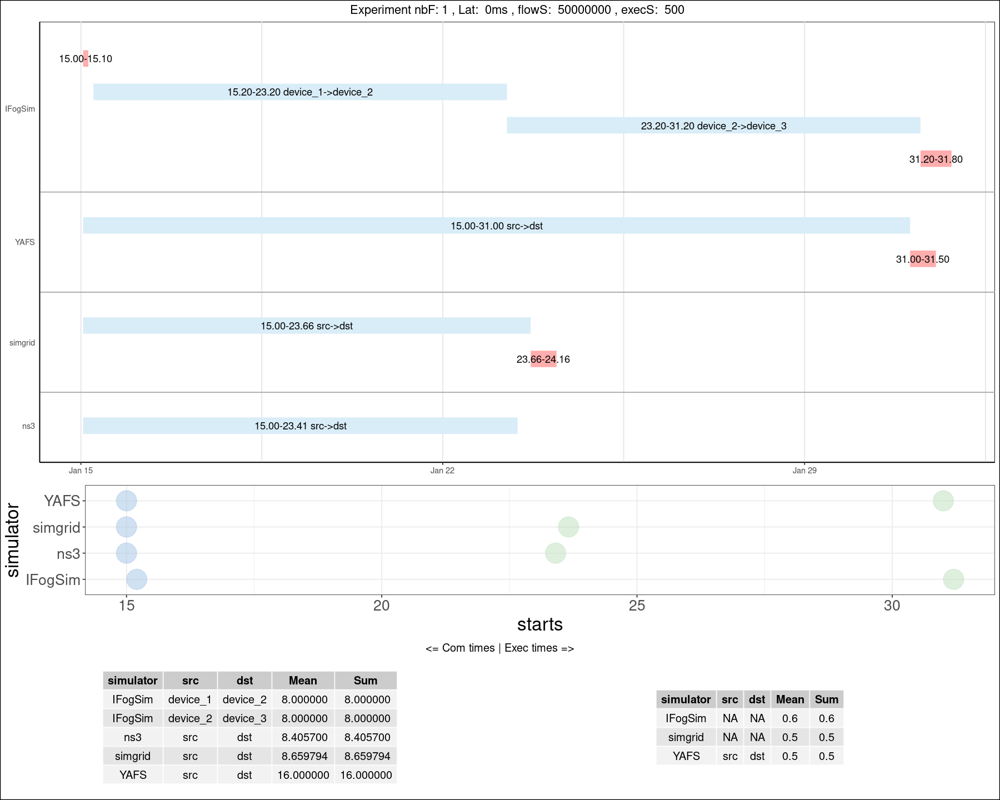

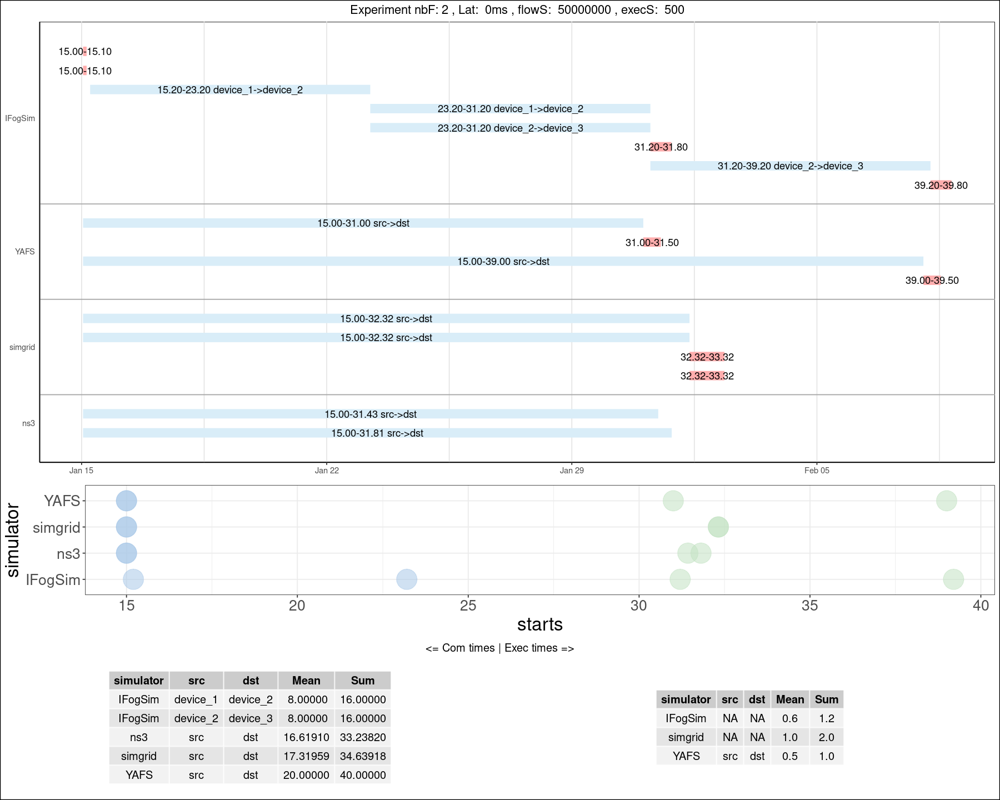

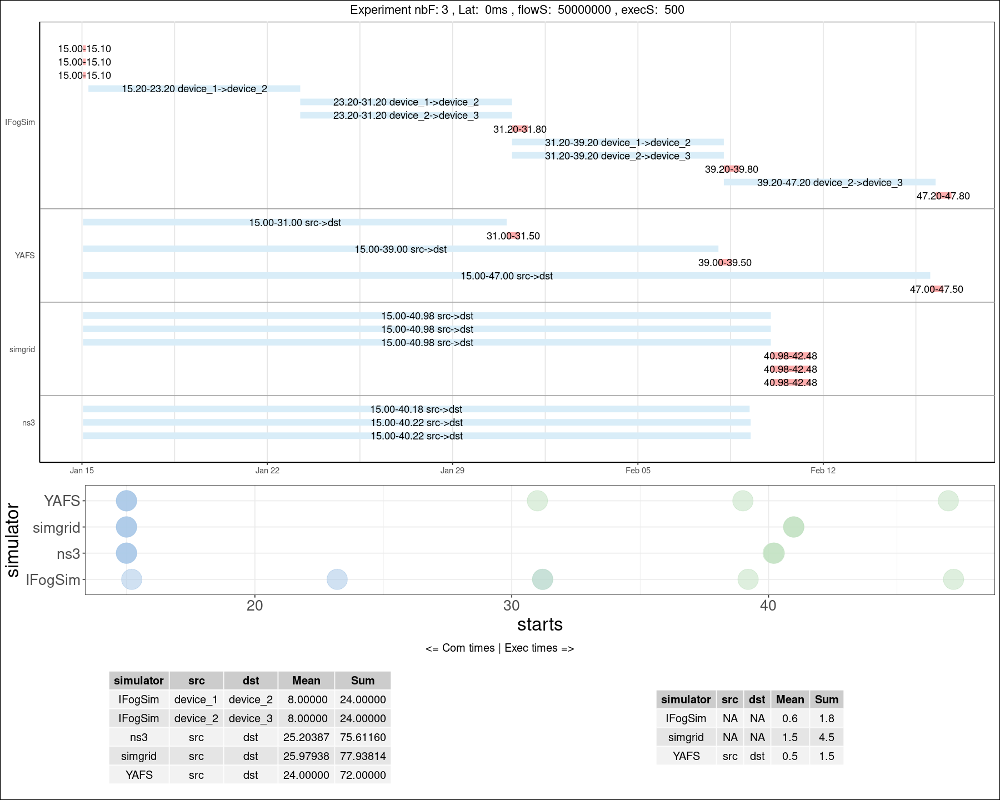

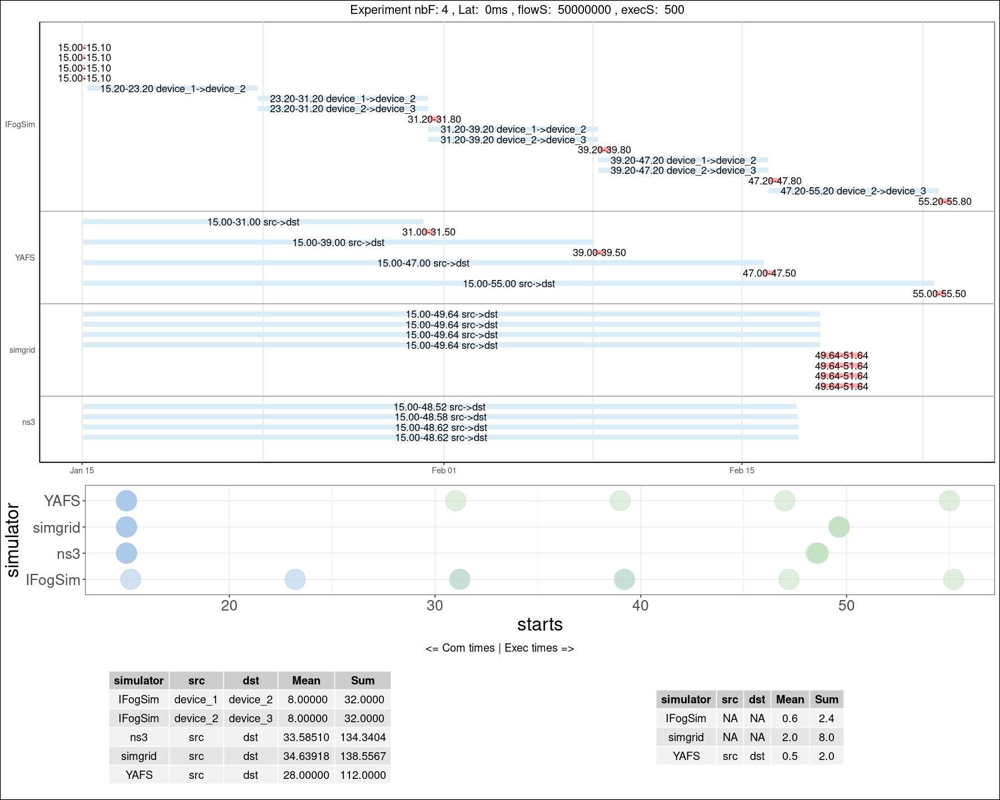

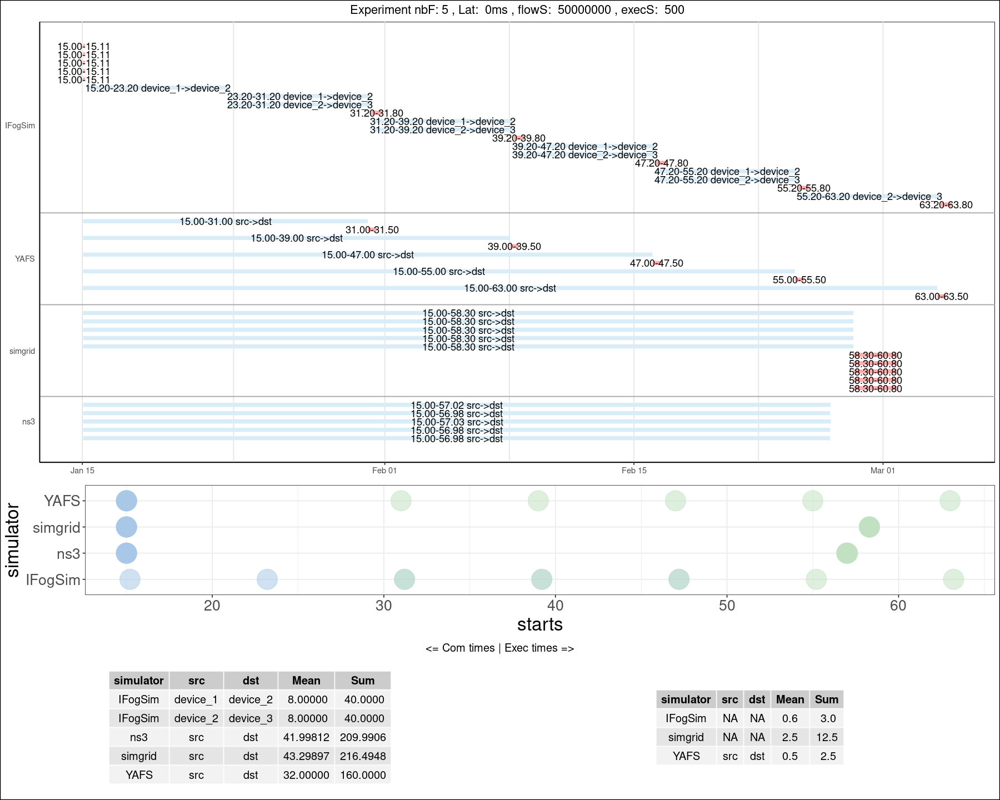

...

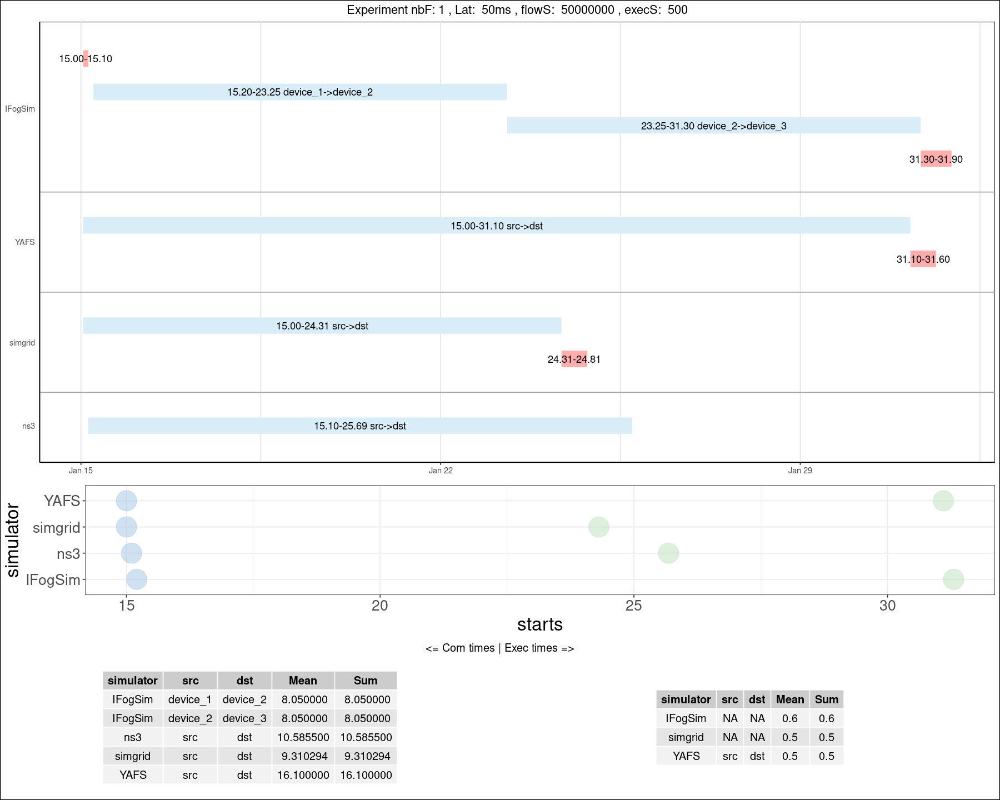

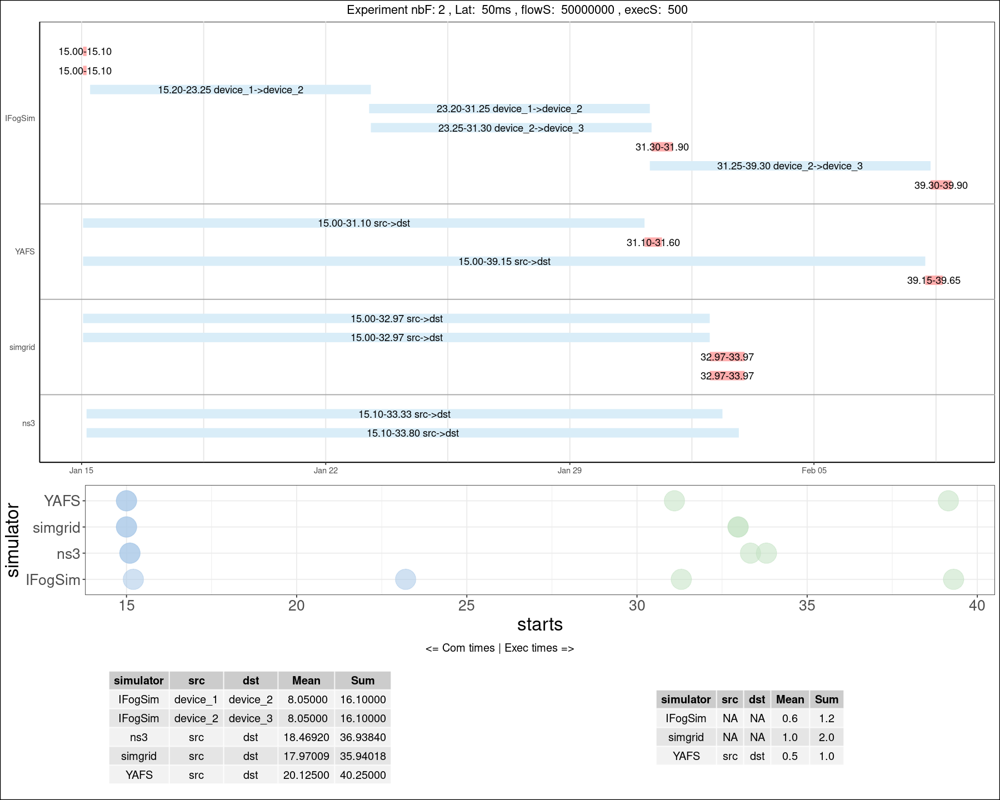

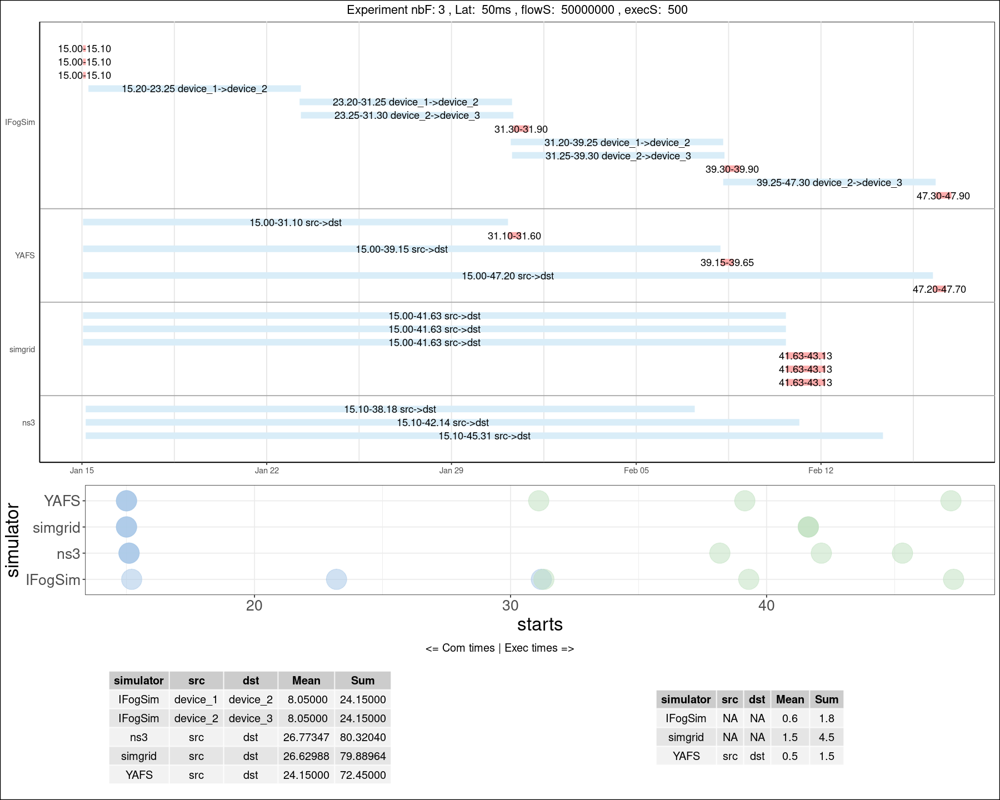

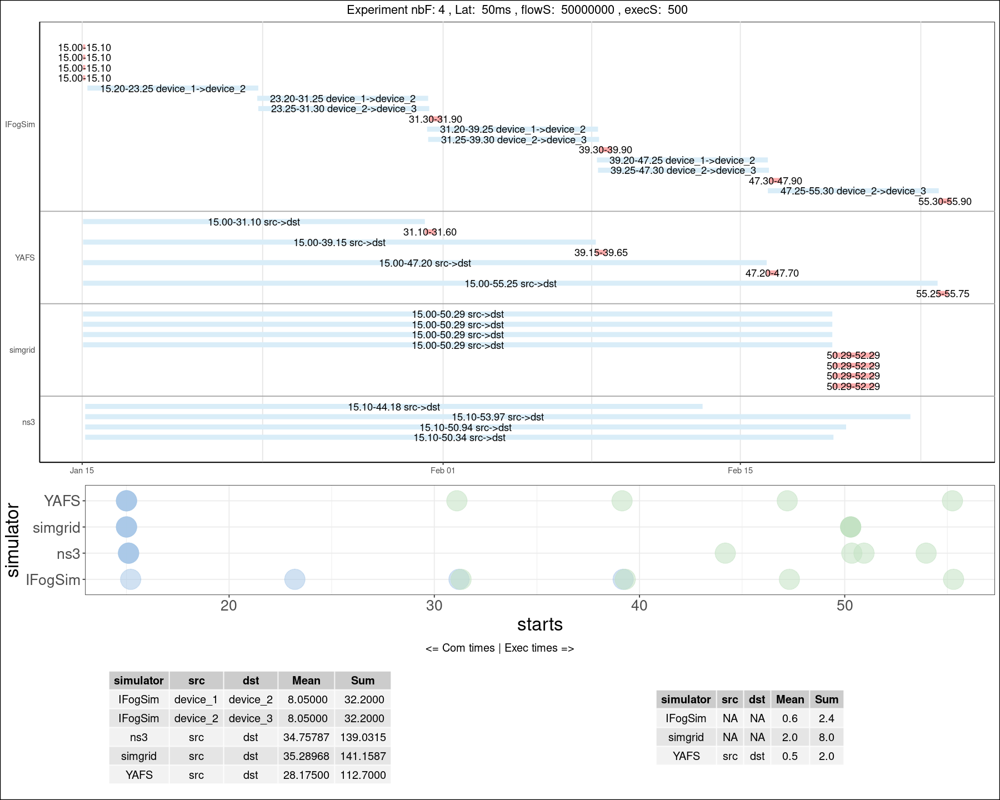

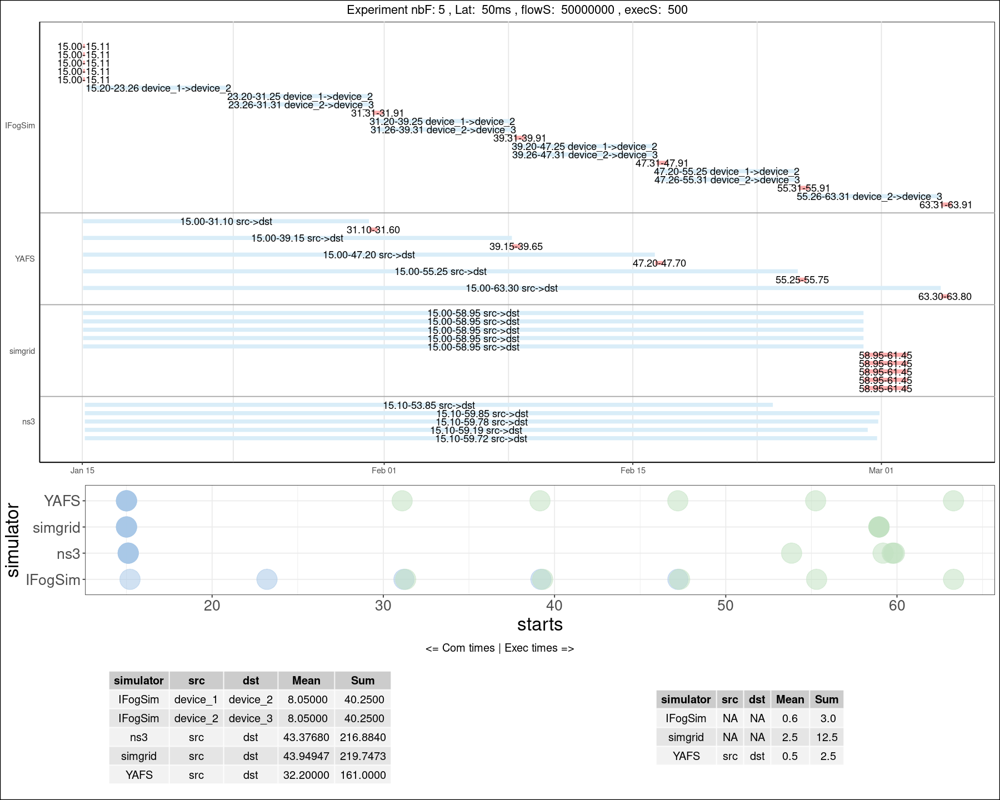

In [22]:

data <- as_tibble(read.csv("./res2Hop-lat.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_3"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

<a id='SEMI_DOGBONE'></a>
# 3. Semi-dogbone

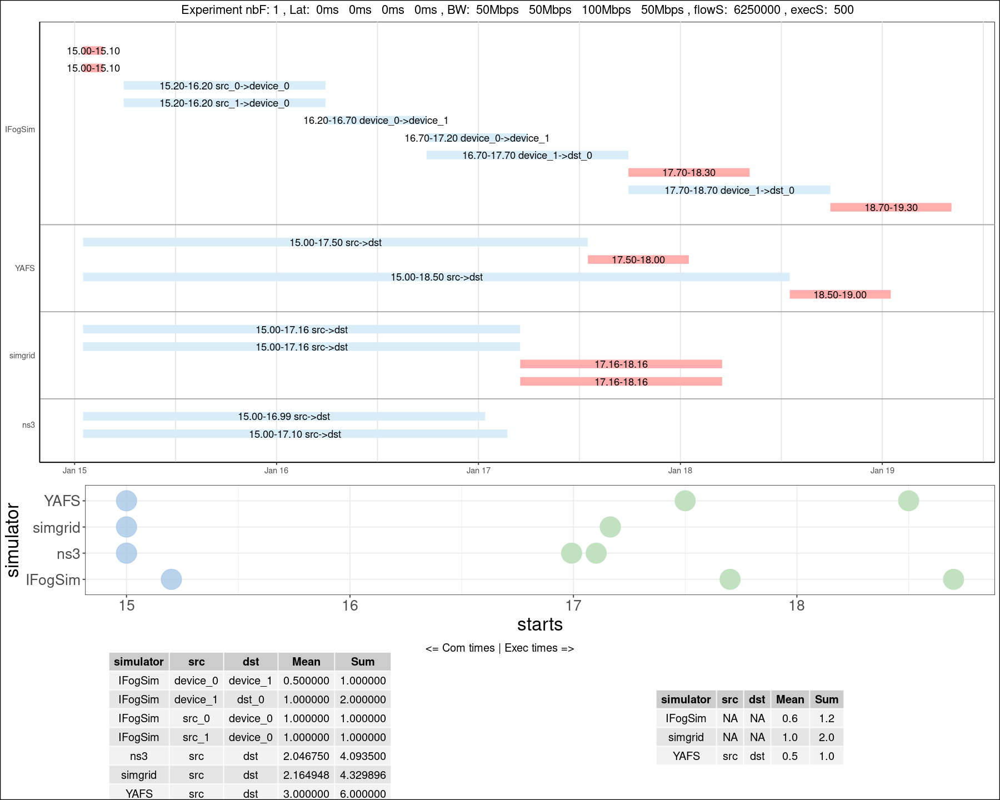

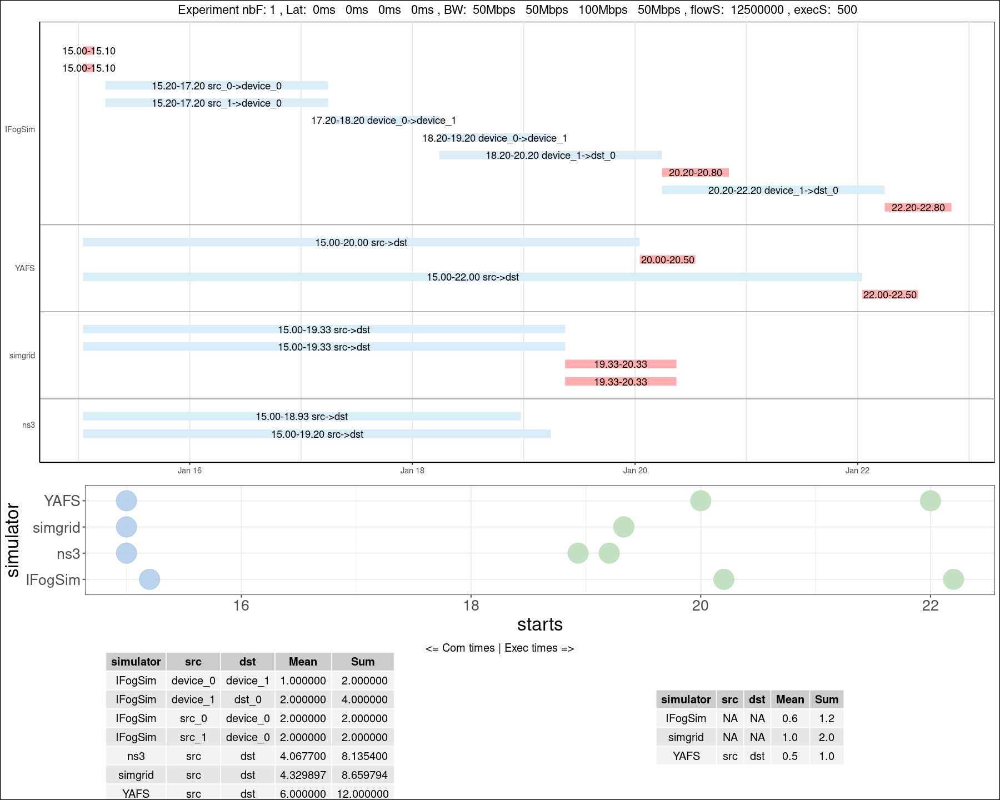

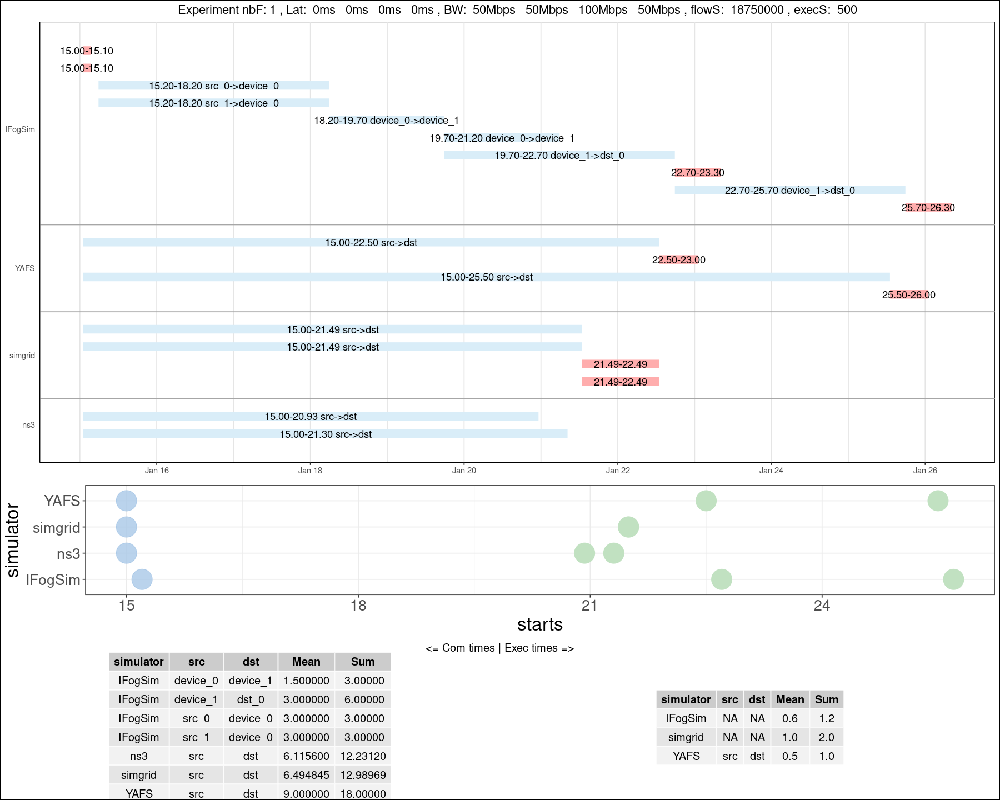

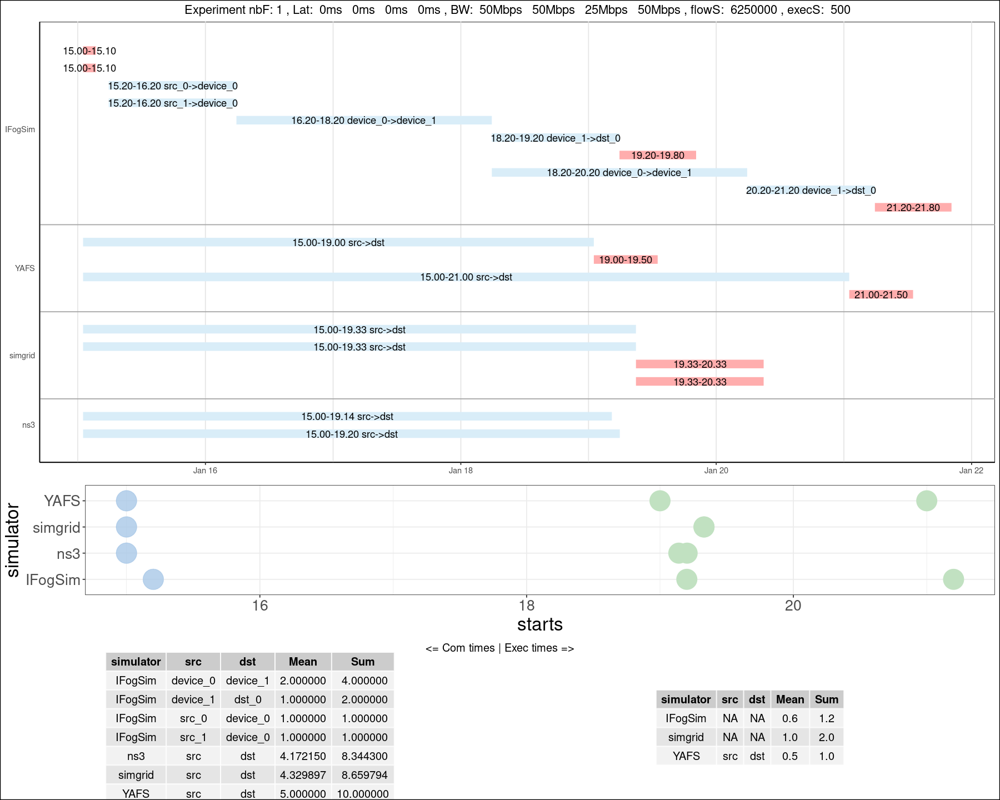

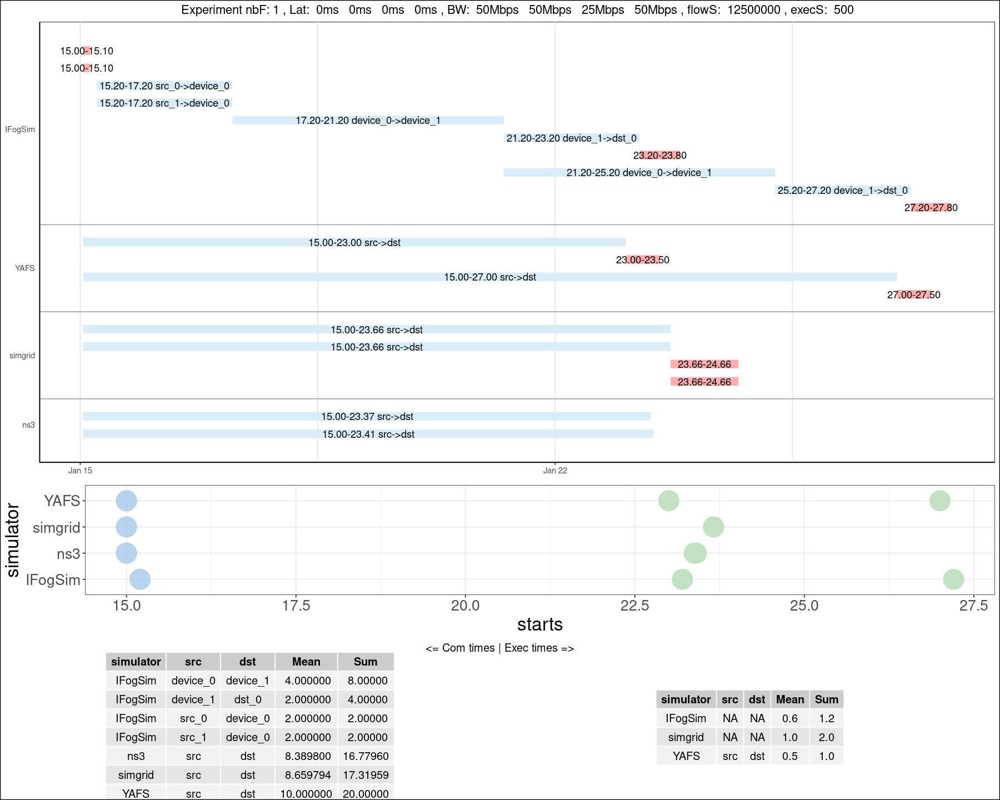

...

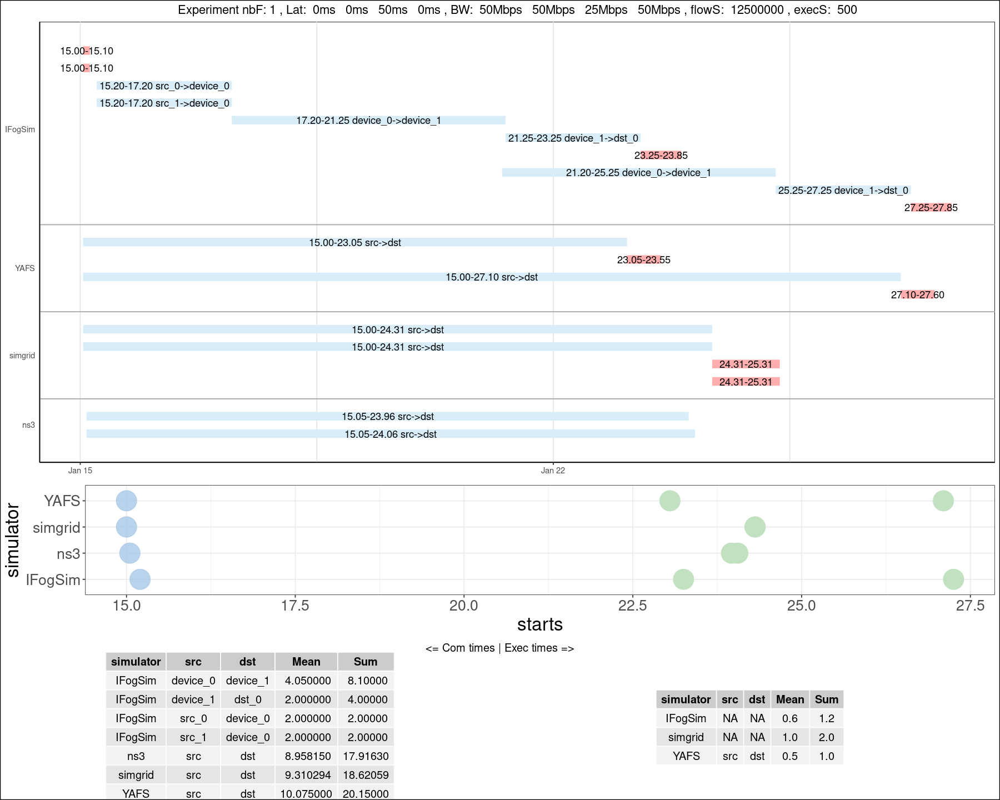

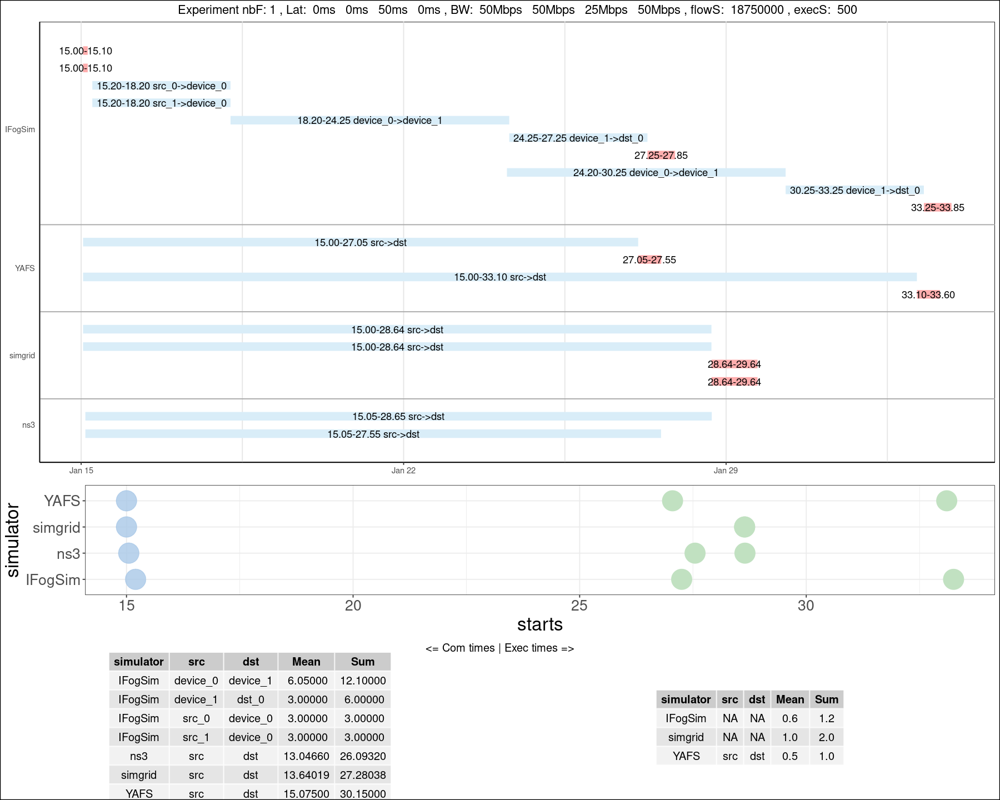

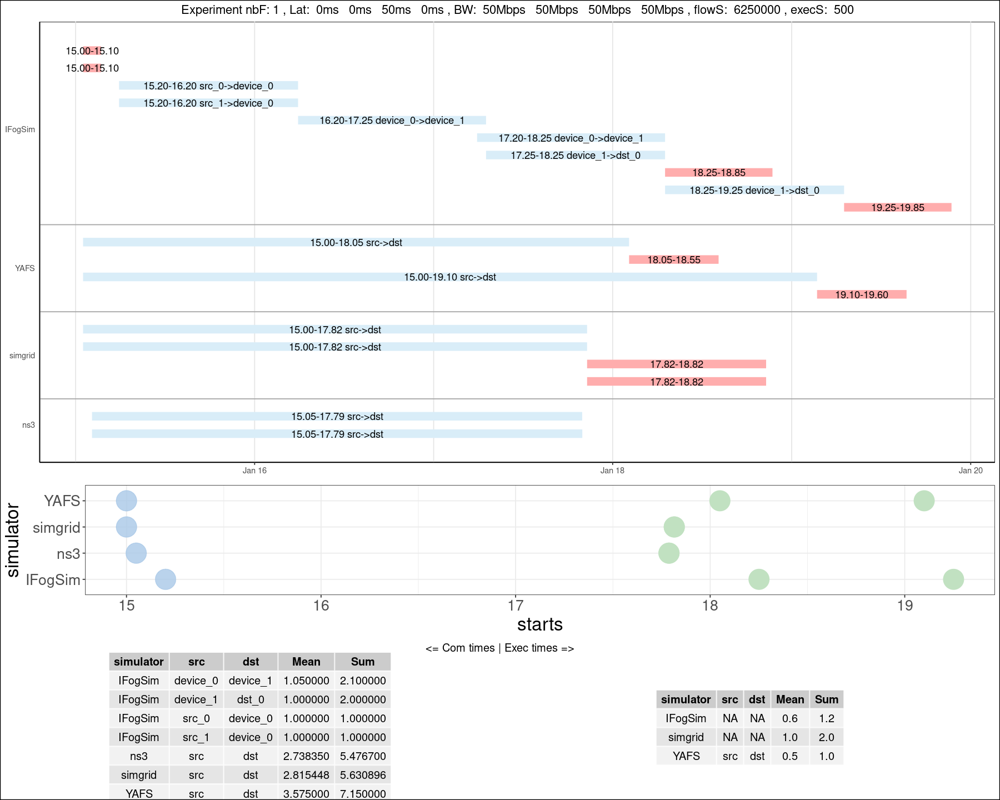

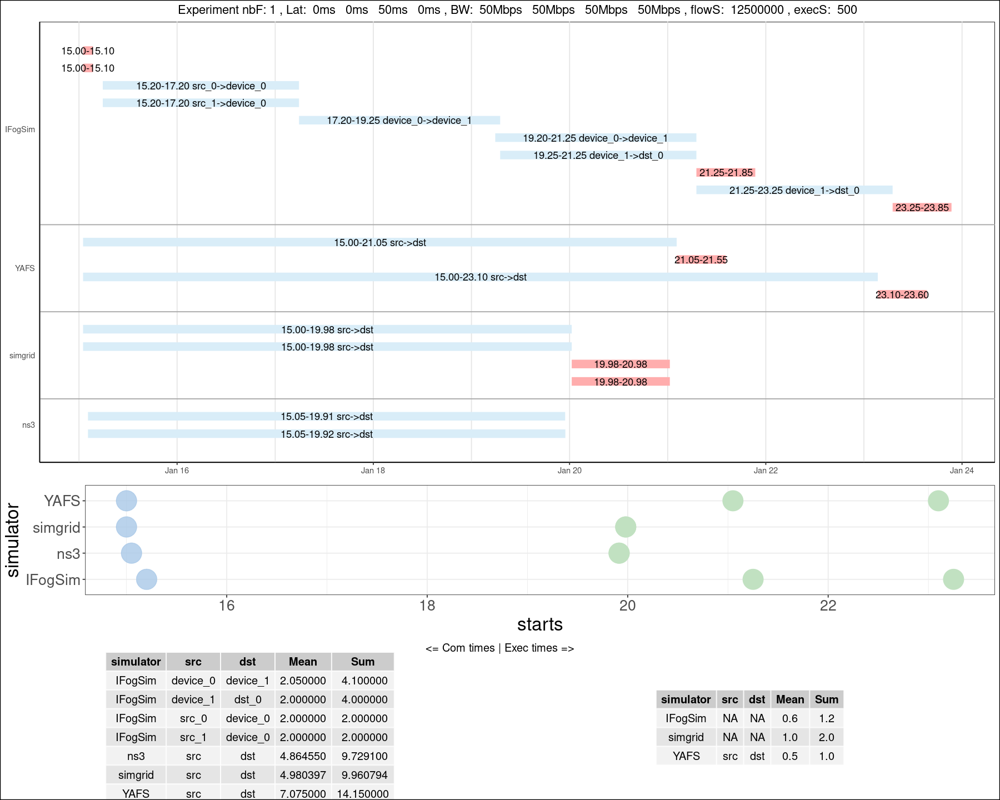

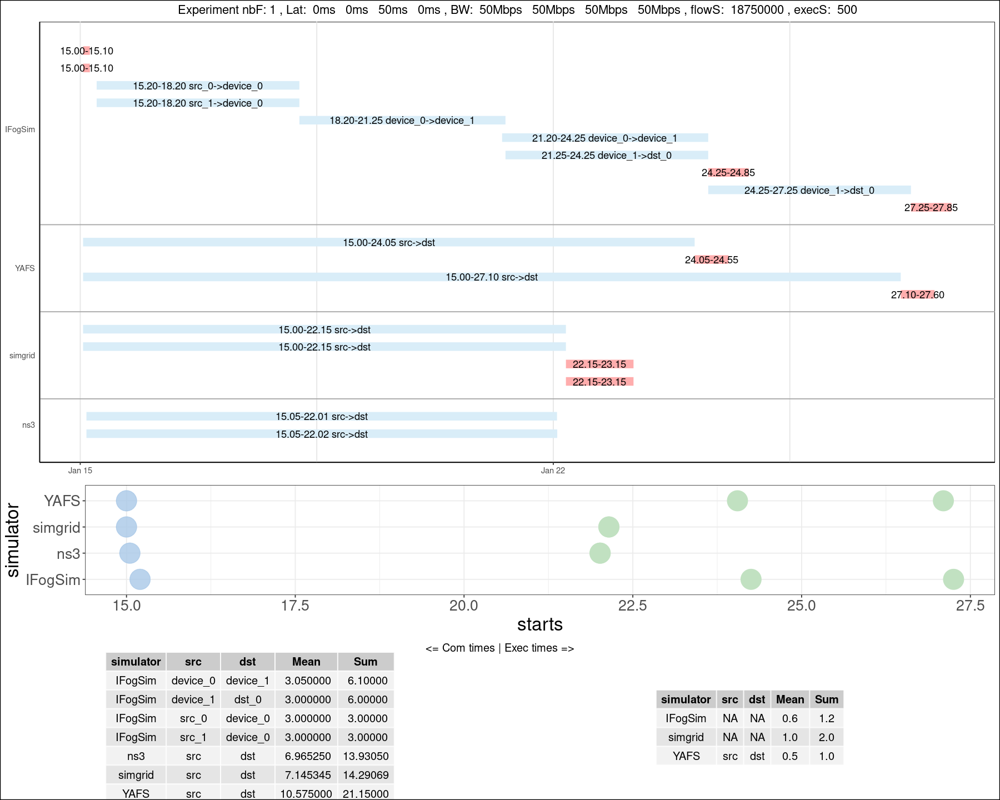

In [7]:

data <- as_tibble(read.csv("./resDogbone.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1" | type=="exec")

#data
dataS <- data %>% group_by(lat1,lat2,lat3,lat4,bw1,bw2,bw3,bw4,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    #print(ds)
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat1"]," ",ds[1,"lat2"]," ",ds[1,"lat3"]," ",ds[1,"lat4"],
                    ", BW: ",ds[1,"bw1"]," ",ds[1,"bw2"]," ",ds[1,"bw3"]," ",ds[1,"bw4"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))

    # stats com
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="src_0" | src=="src_1"),
                                                           simulator!="IFogSim" ~ src=="src"))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="dst_0"),
                                                       simulator!="IFogSim" ~ src=="src"))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C1", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}
#dev.off() 
#print(lplots)
#cowplot::plot_grid(plotlist = lplots,n = )
#arrange <- ggarrange(plotlist=lplots, ncol = 1)
#arrange

# Playground
<a id='PLAYGROUND'></a>


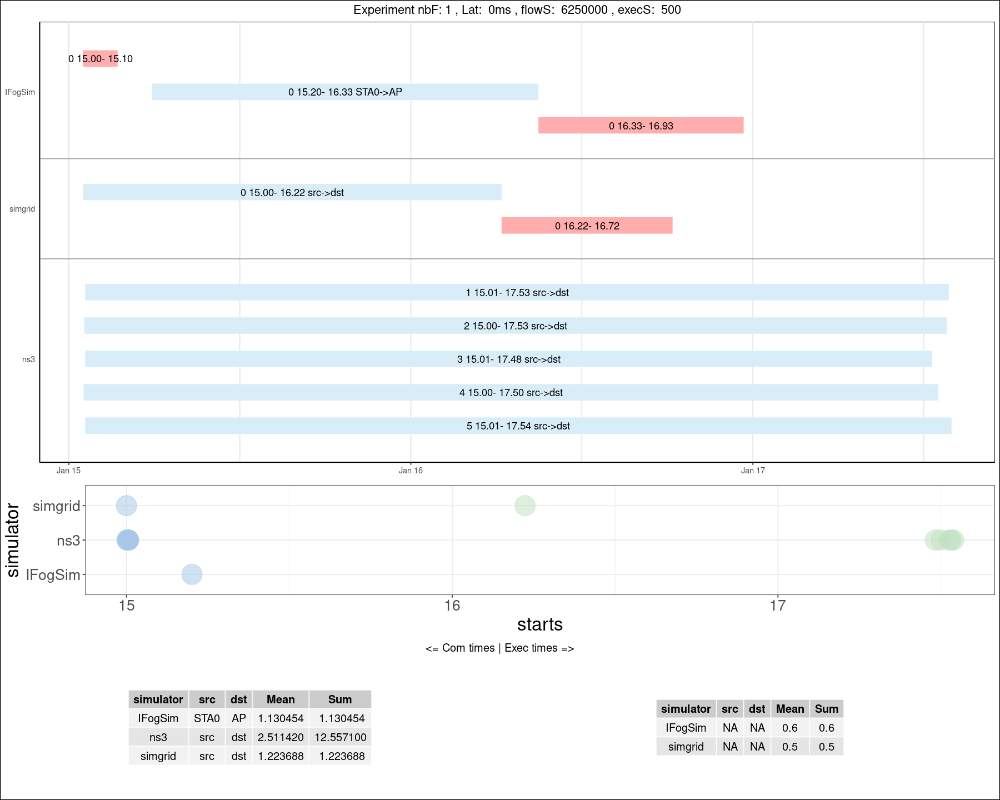

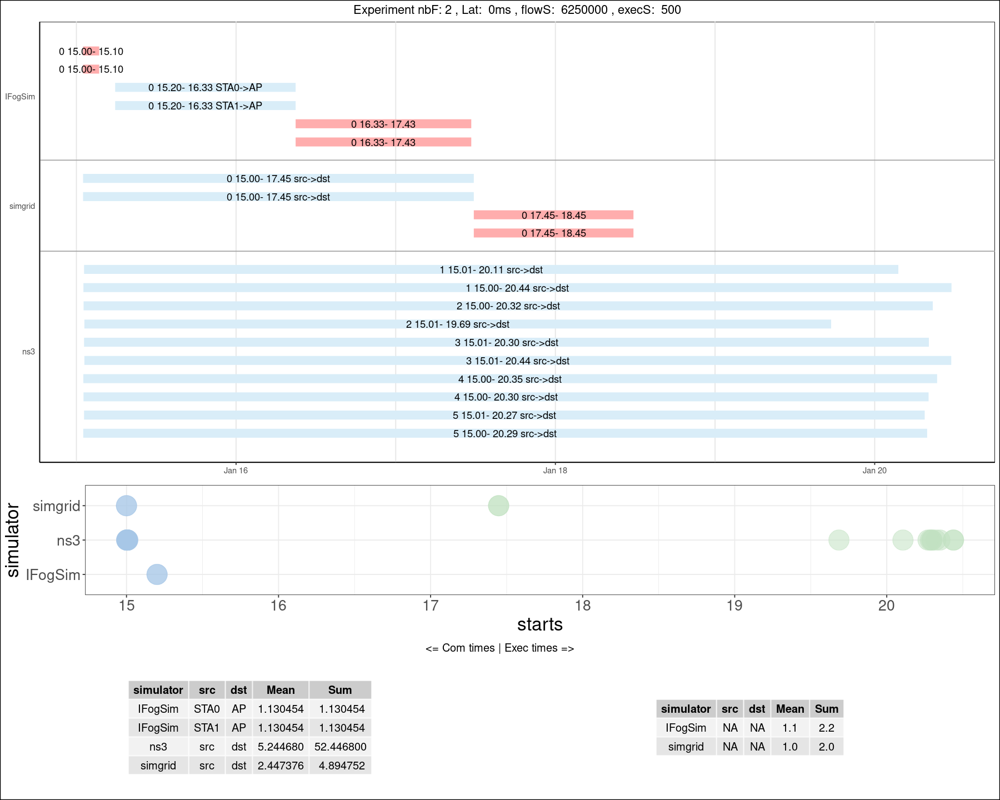

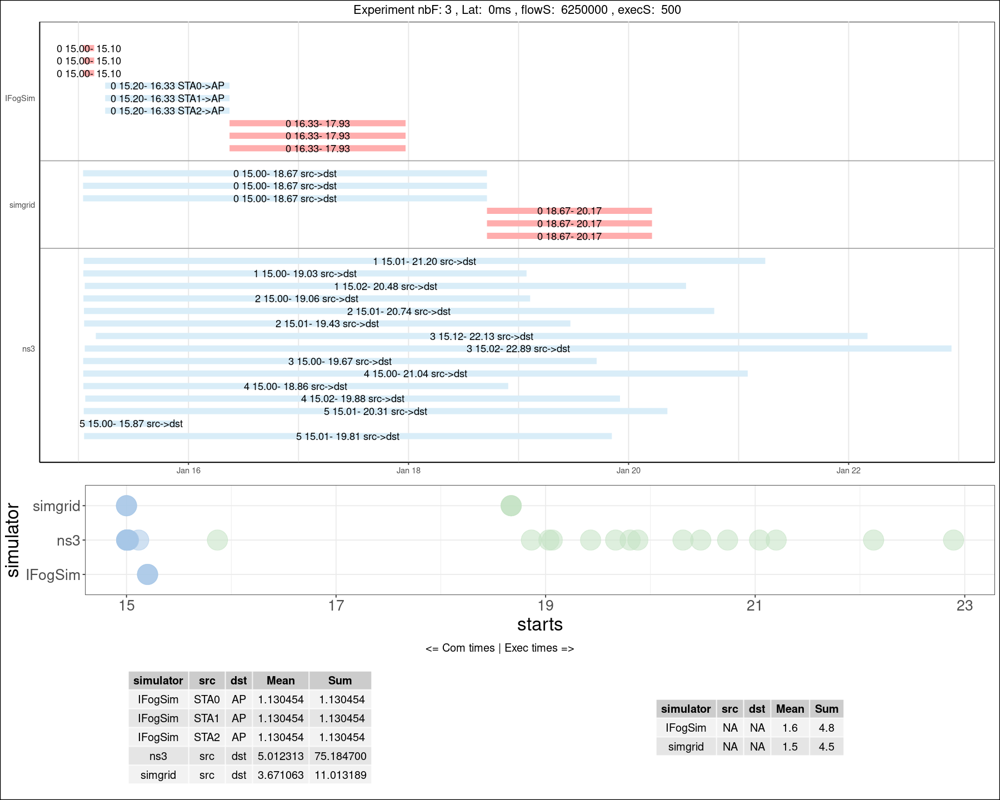

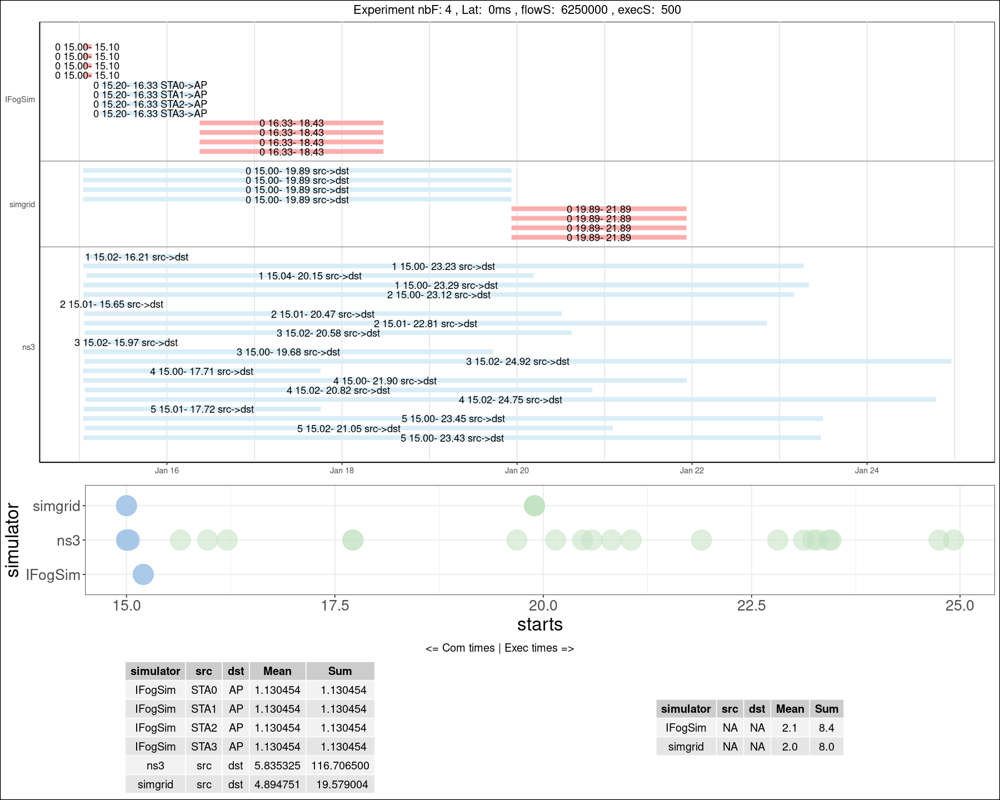

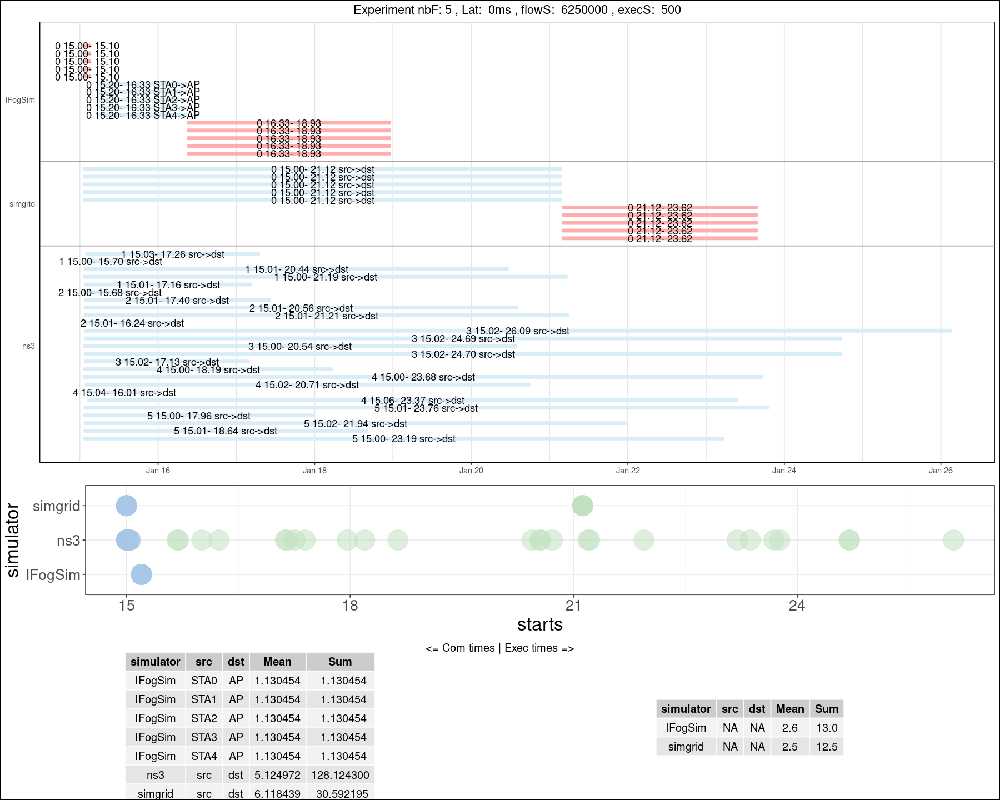

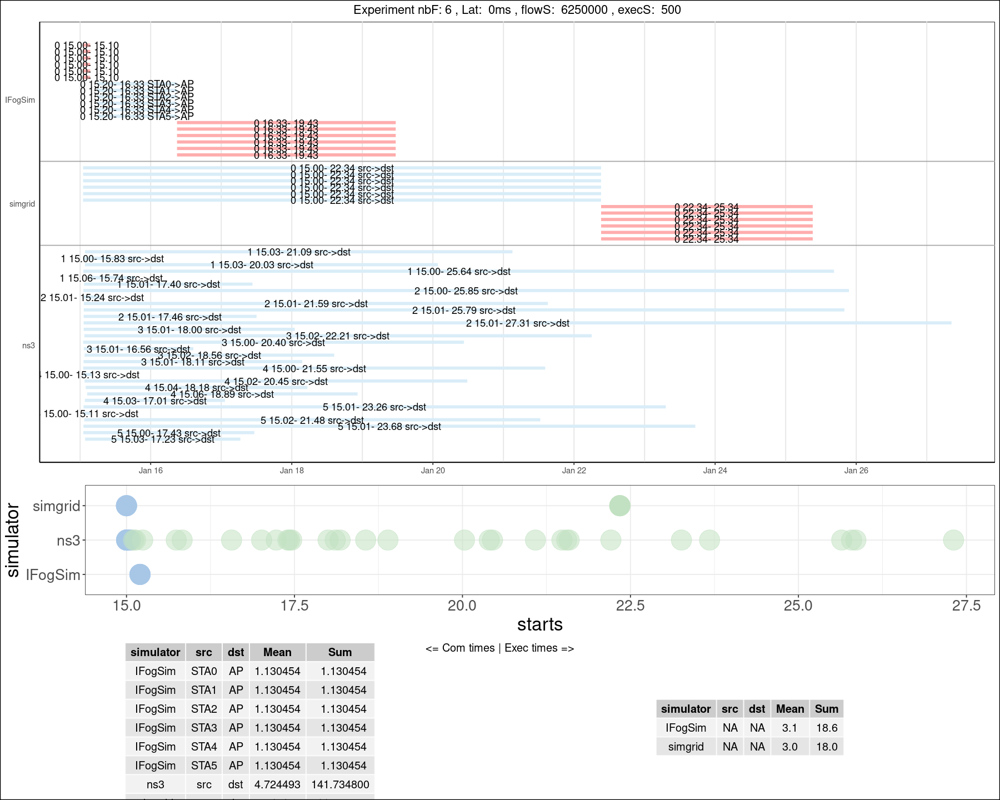

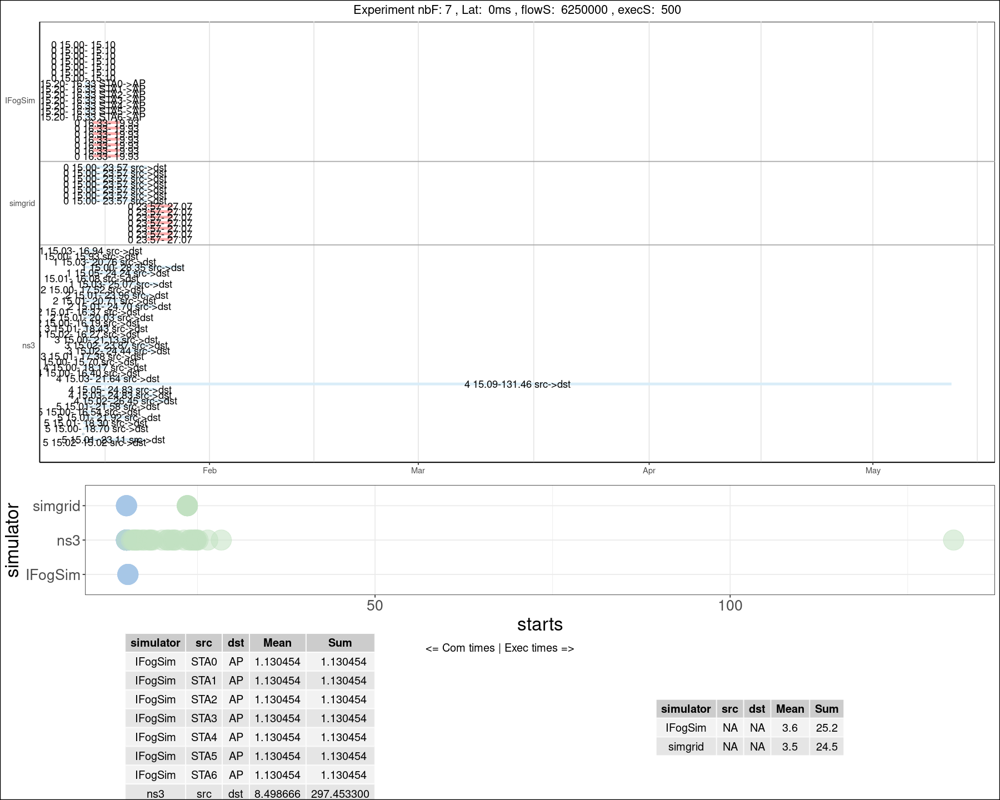

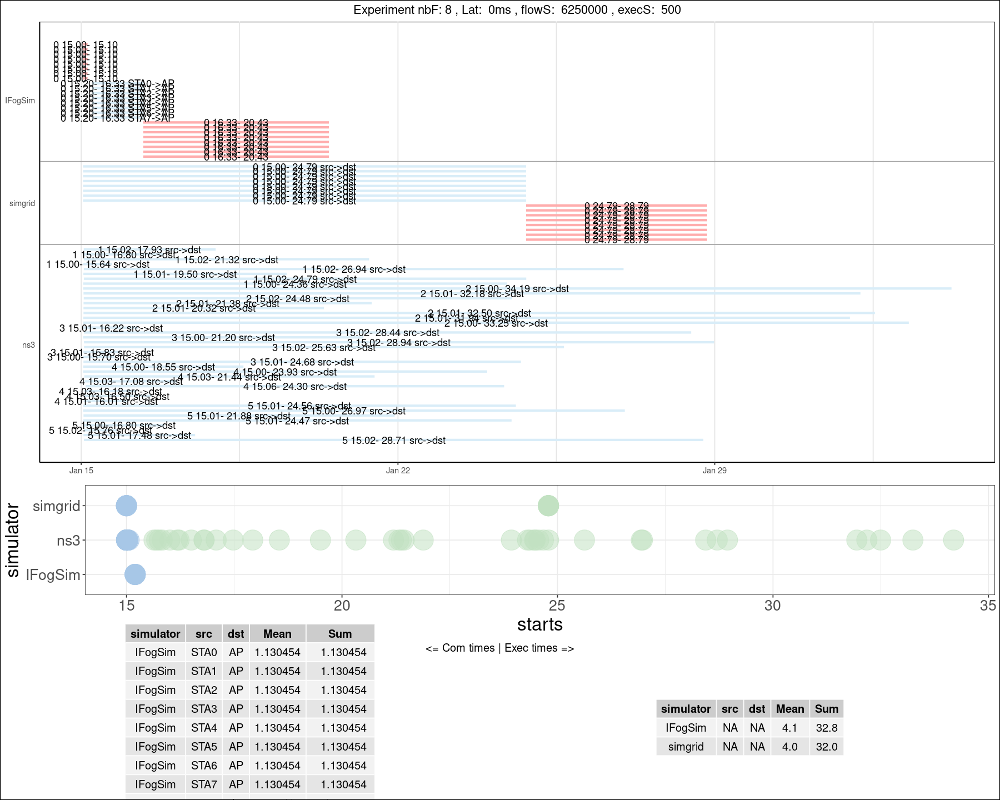

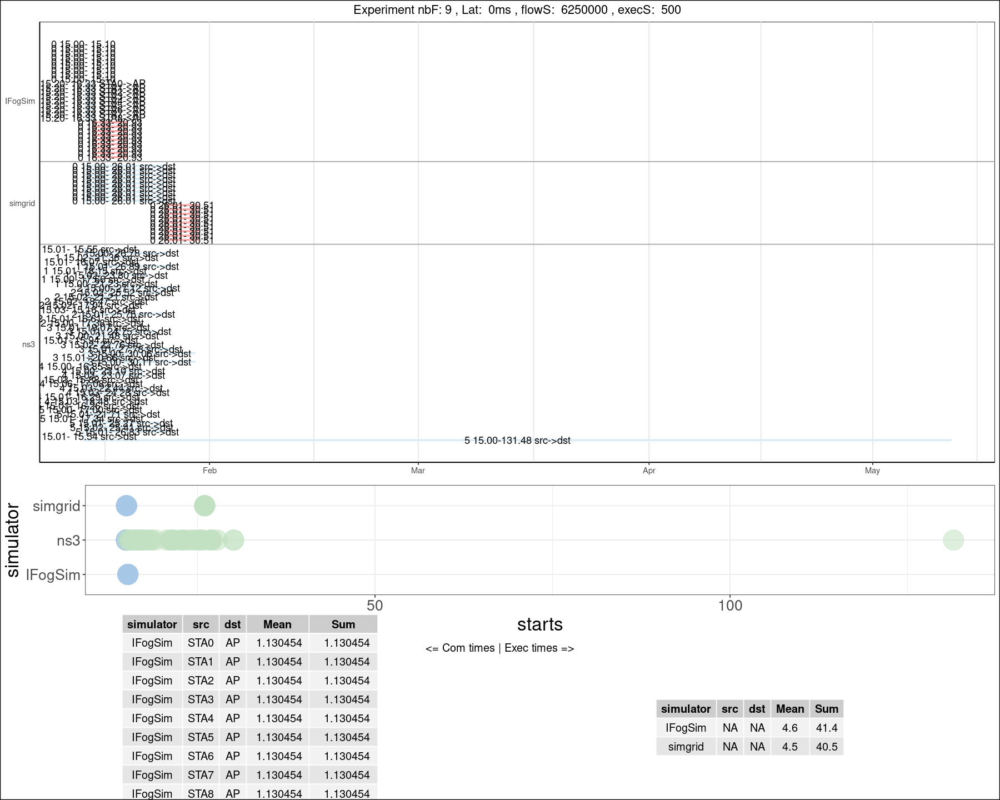

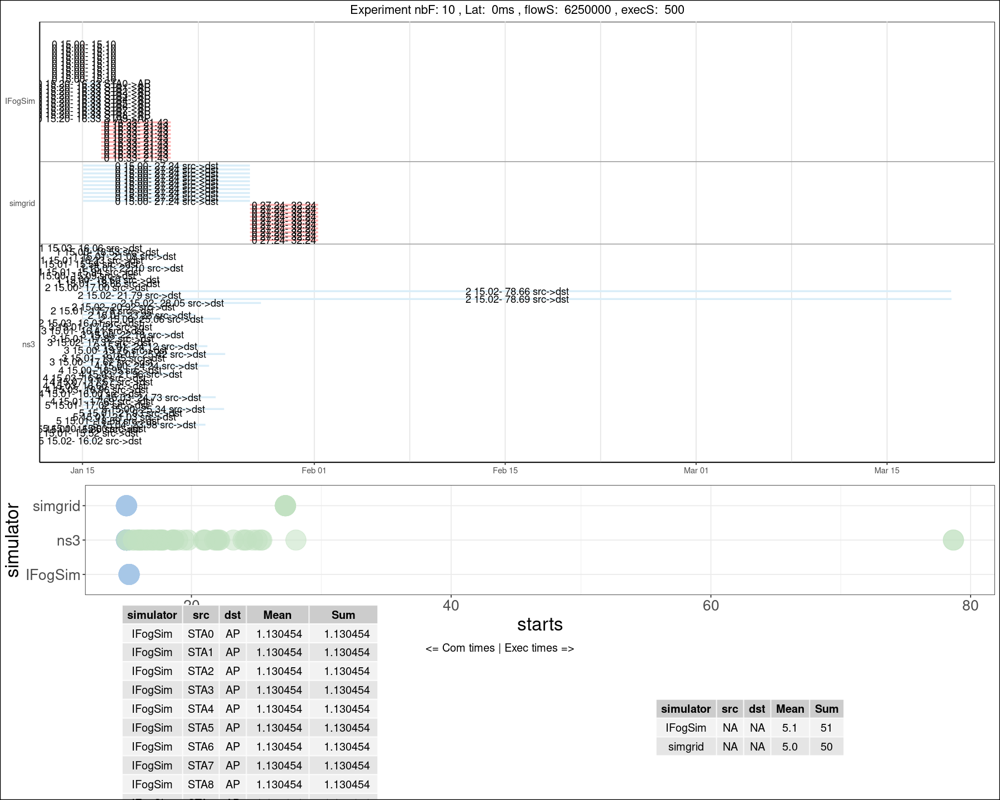

In [22]:

data <- as_tibble(read.csv("./resWiFi-net.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(seed," ",format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(seed," ",format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (grepl("STA", src, fixed=TRUE)),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (grepl("OUT", dst, fixed=TRUE)),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

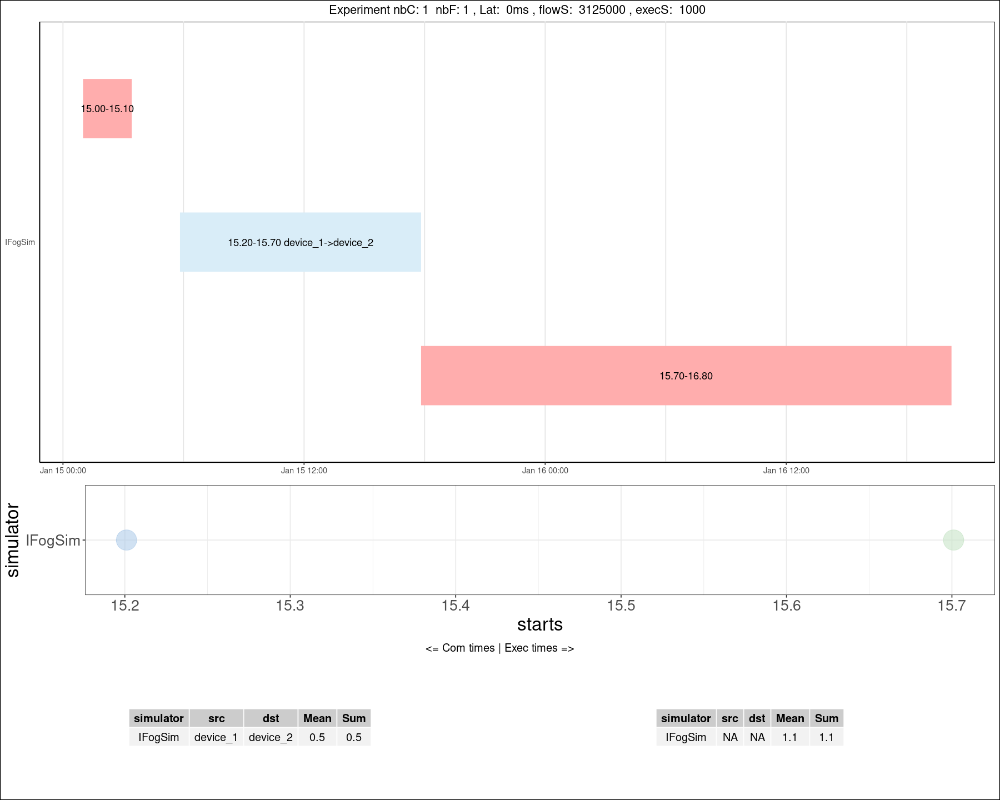

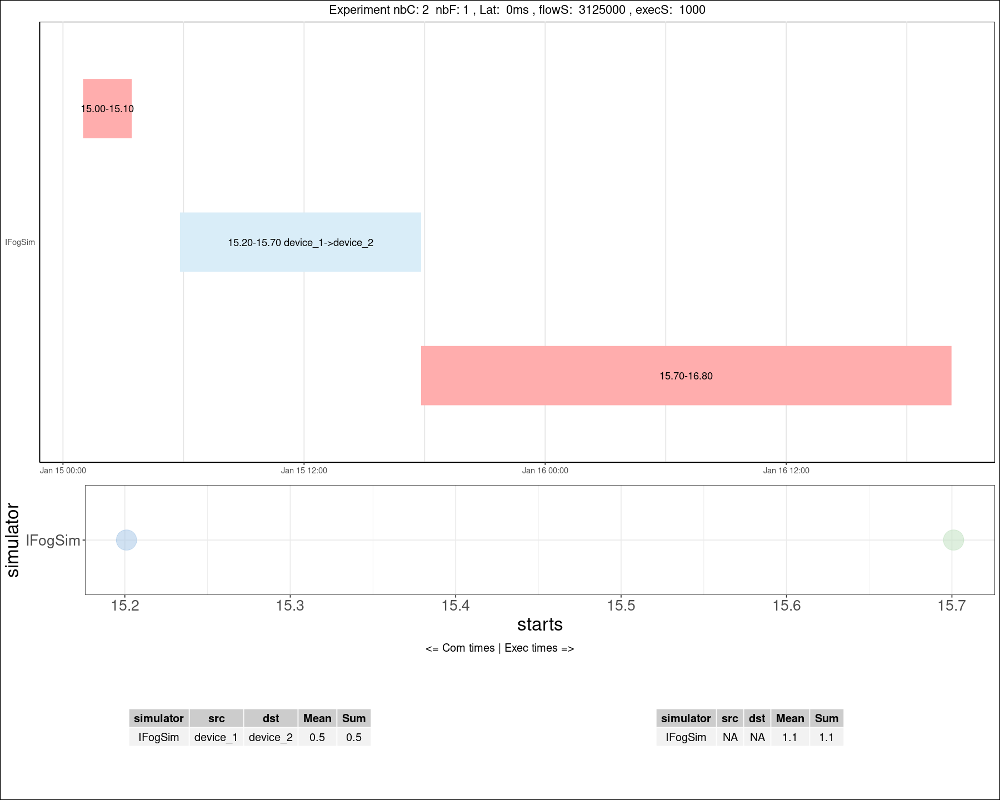

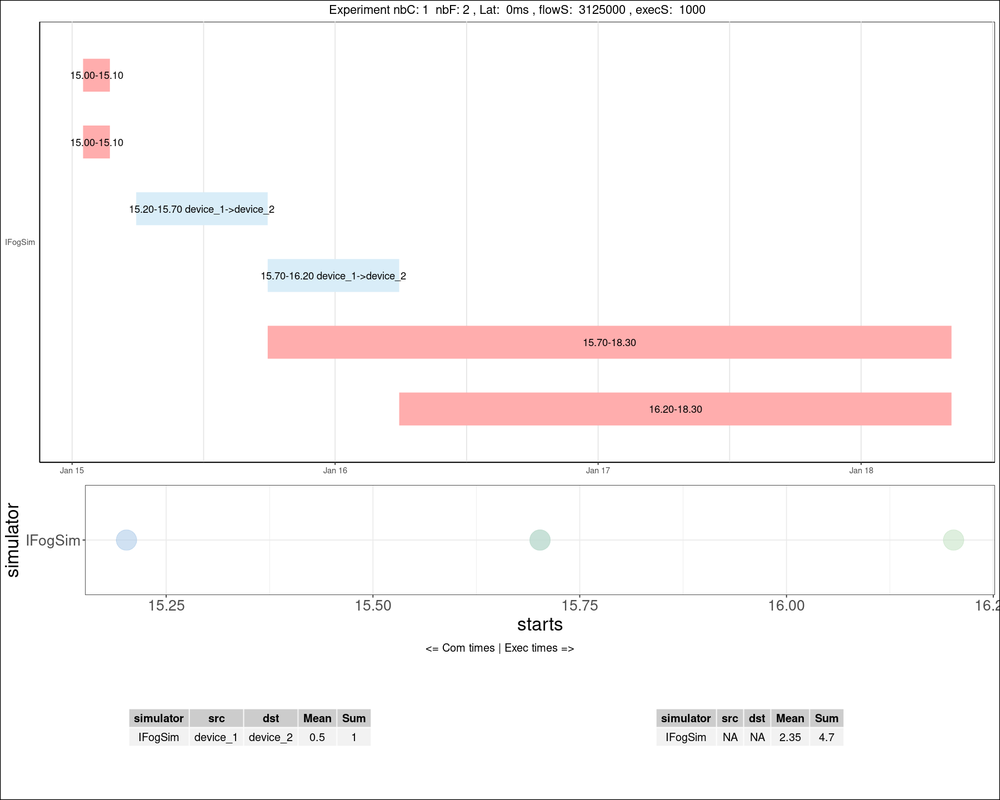

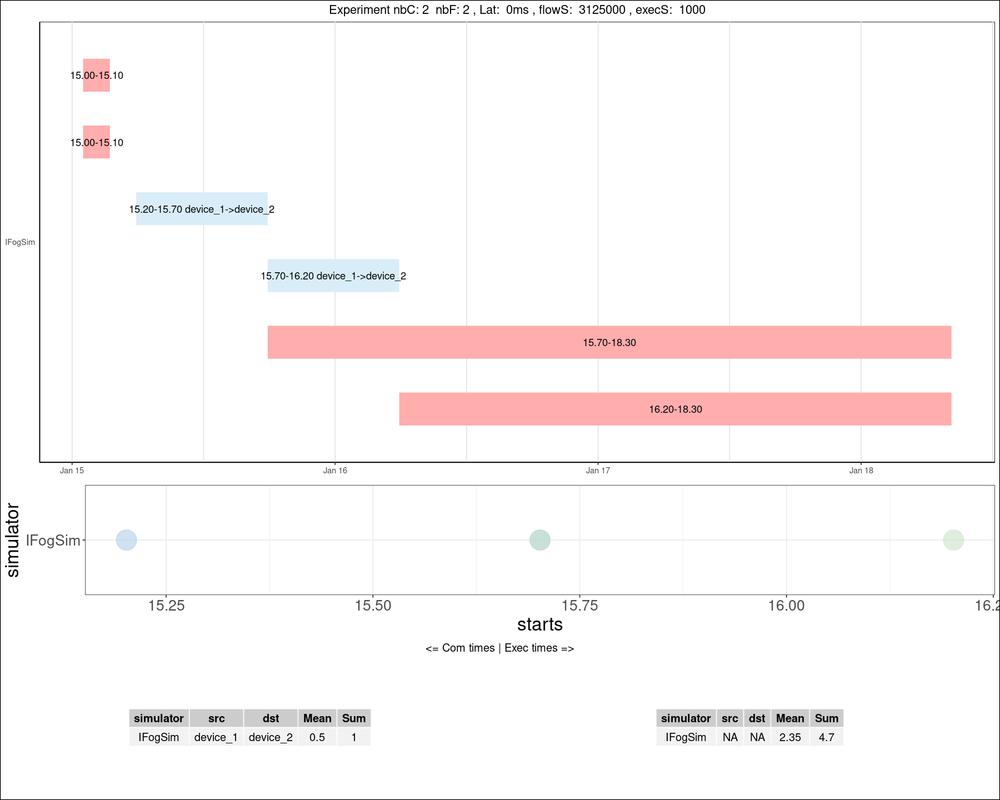

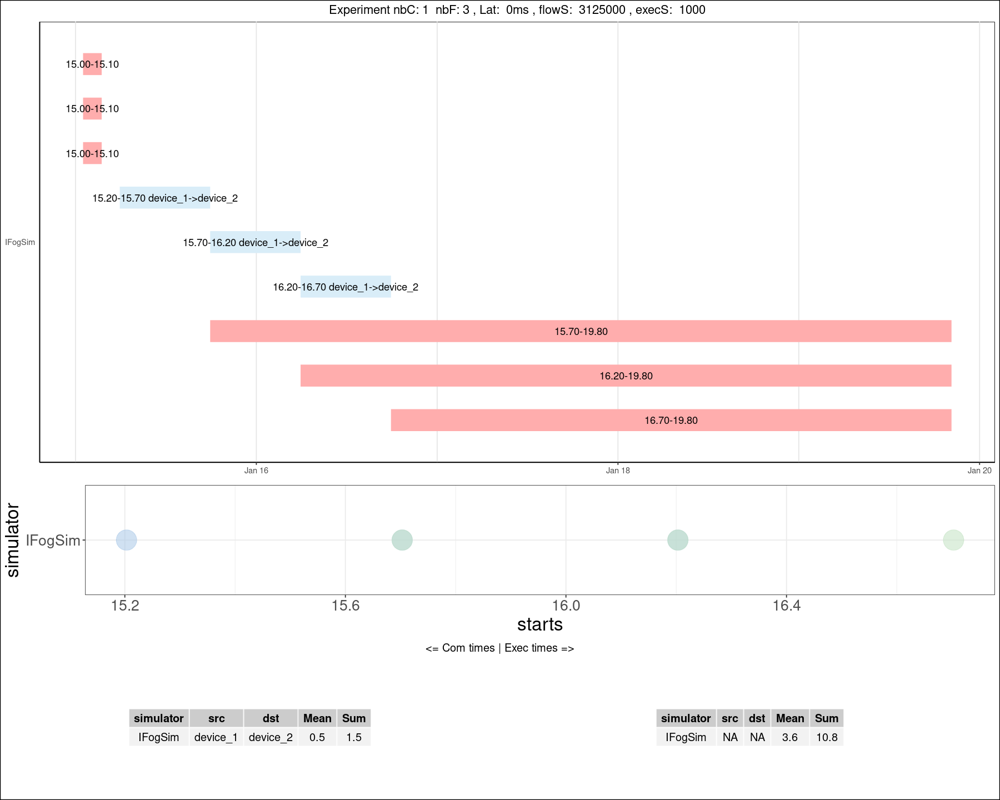

...

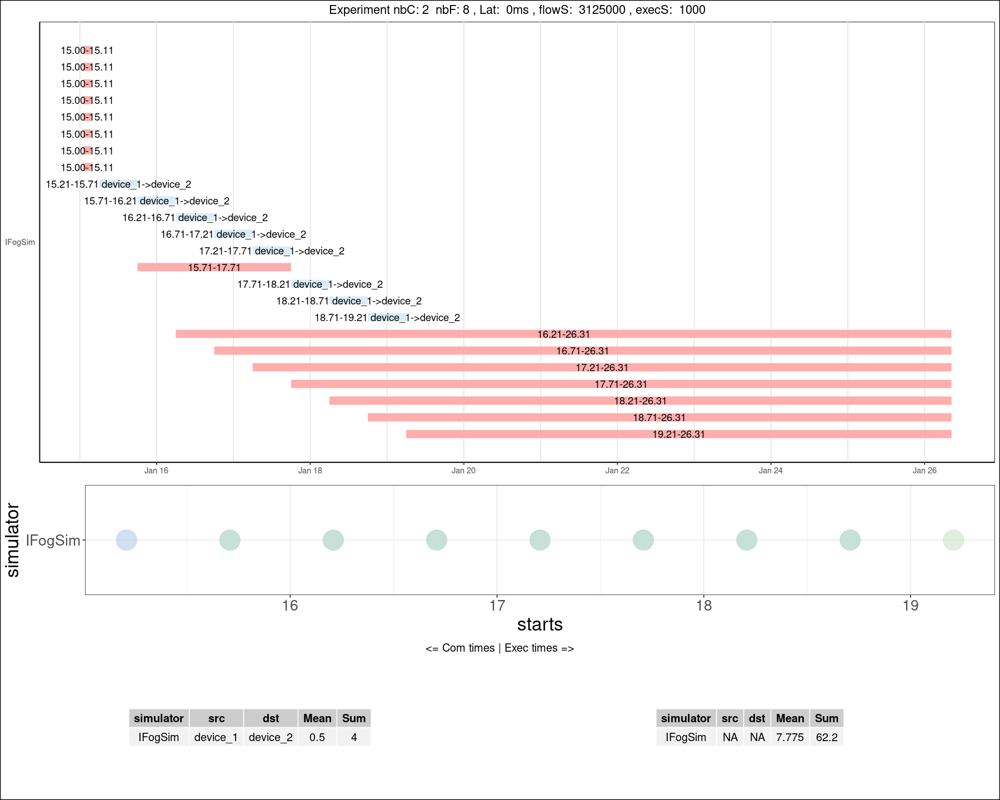

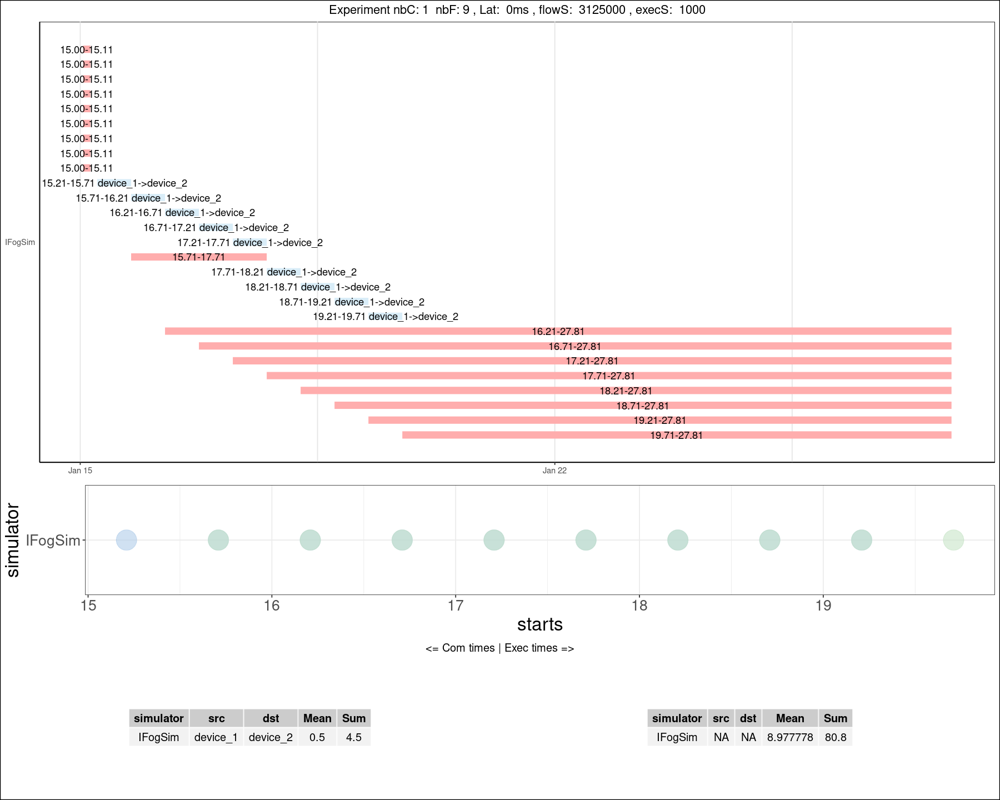

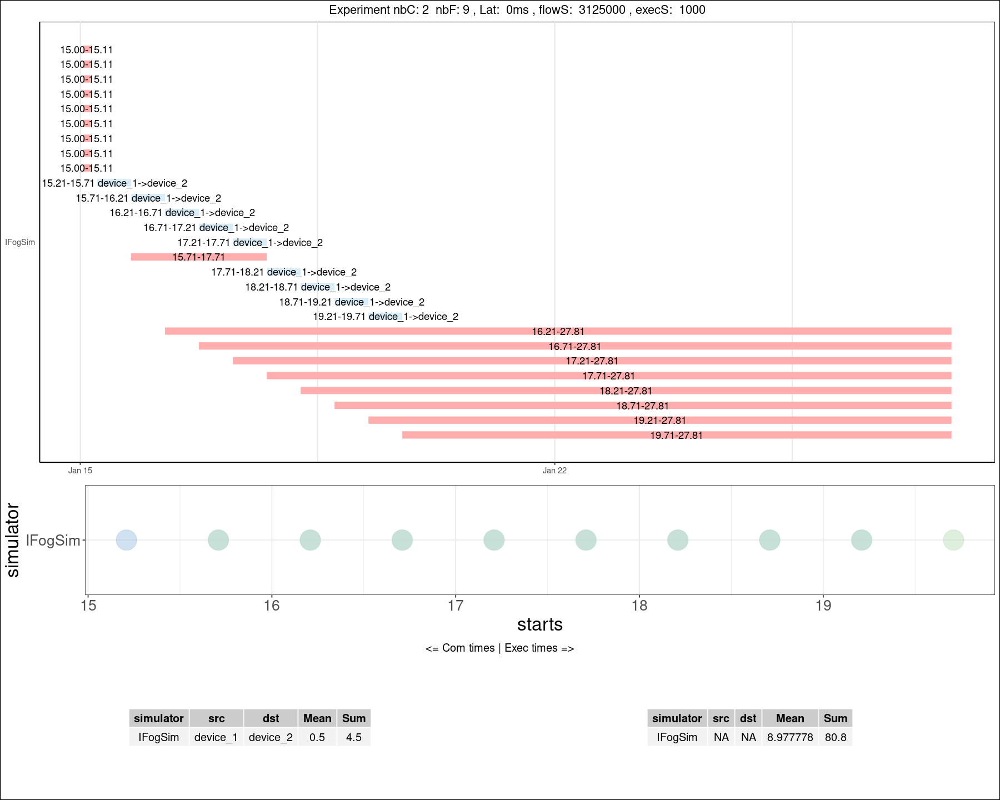

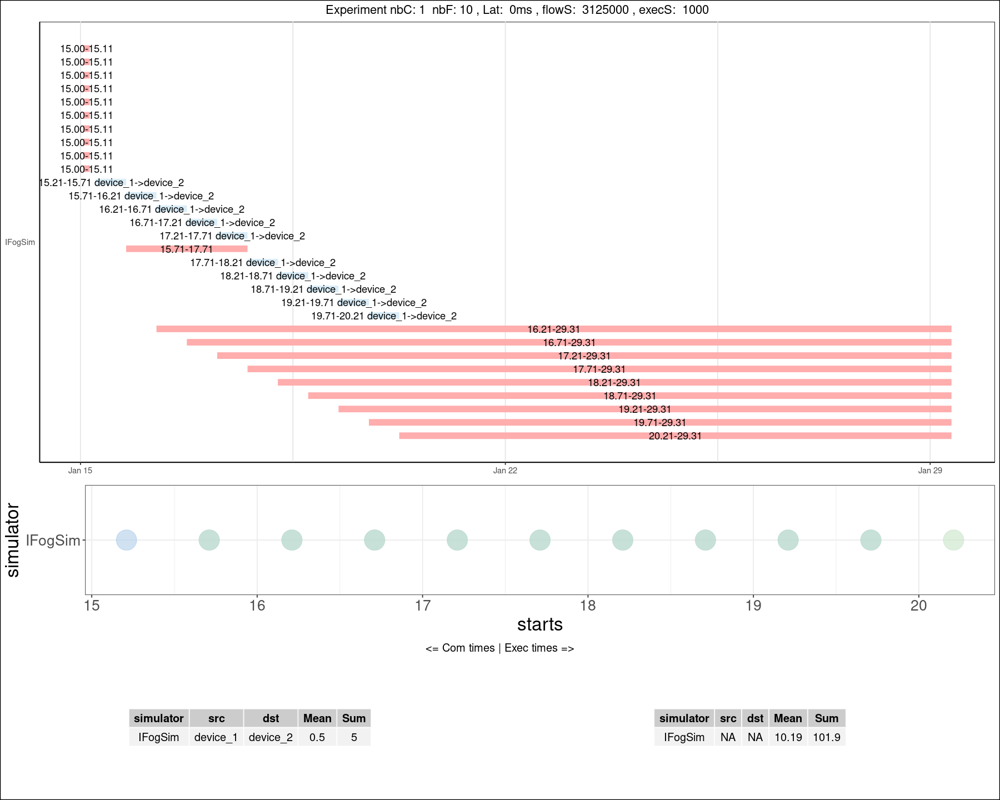

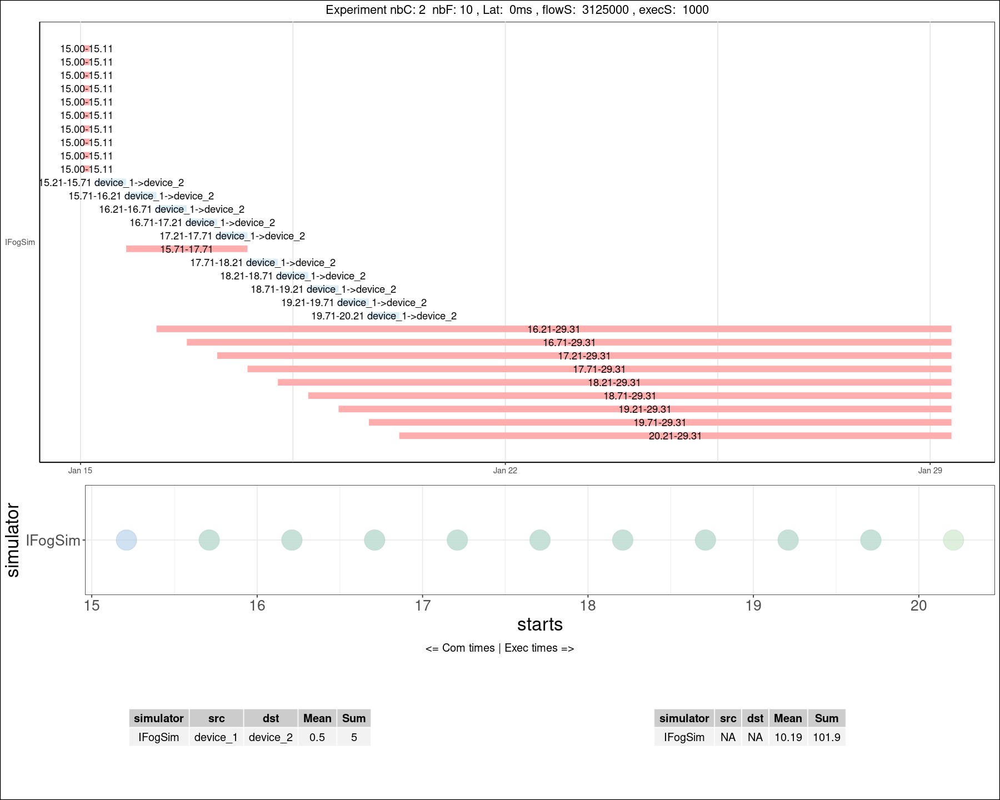

In [3]:

data <- as_tibble(read.csv("./res1Hop-multicore.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF,nbCore)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbC:",ds[1,"nbCore"]," nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_2"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}

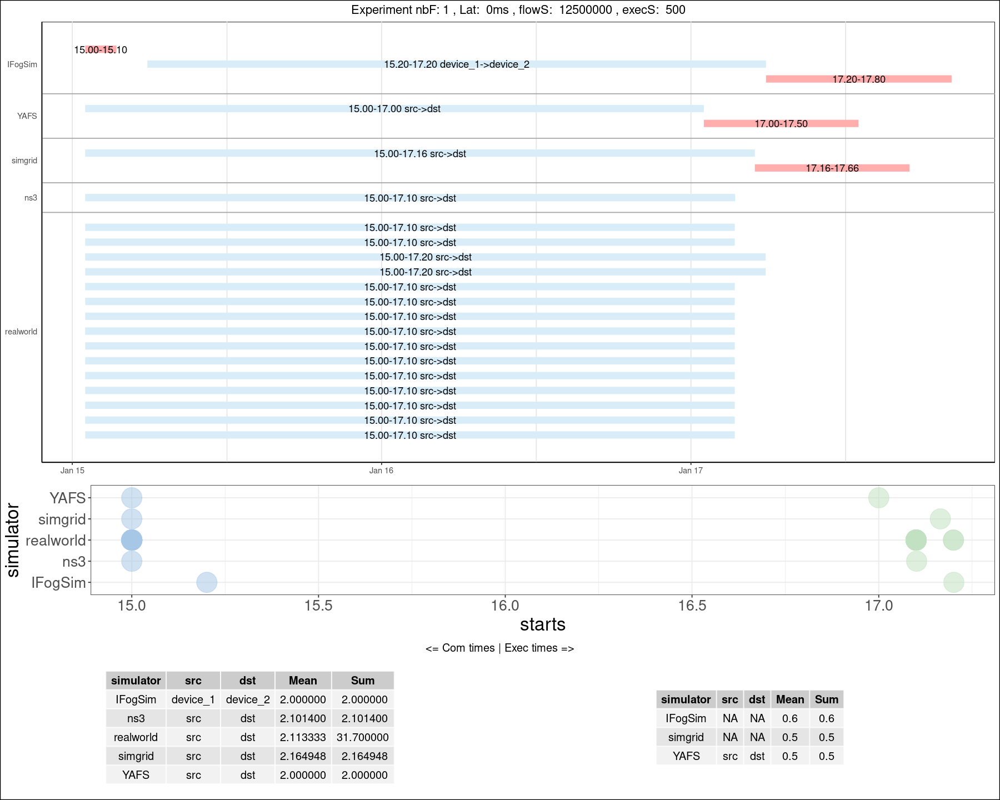

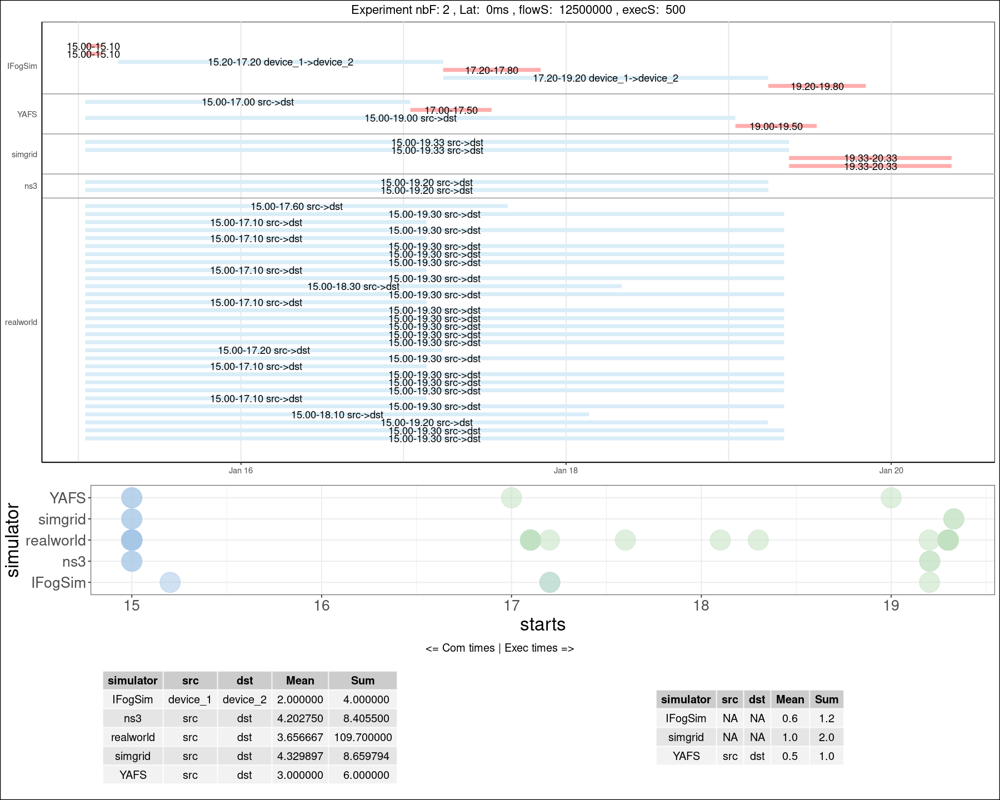

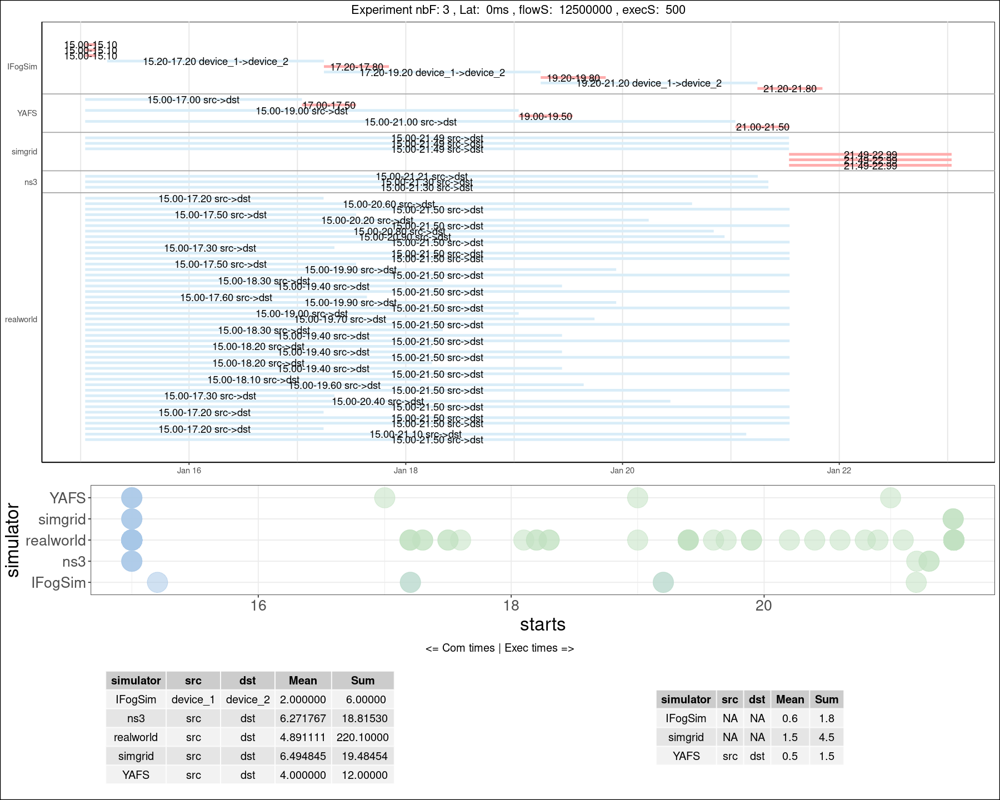

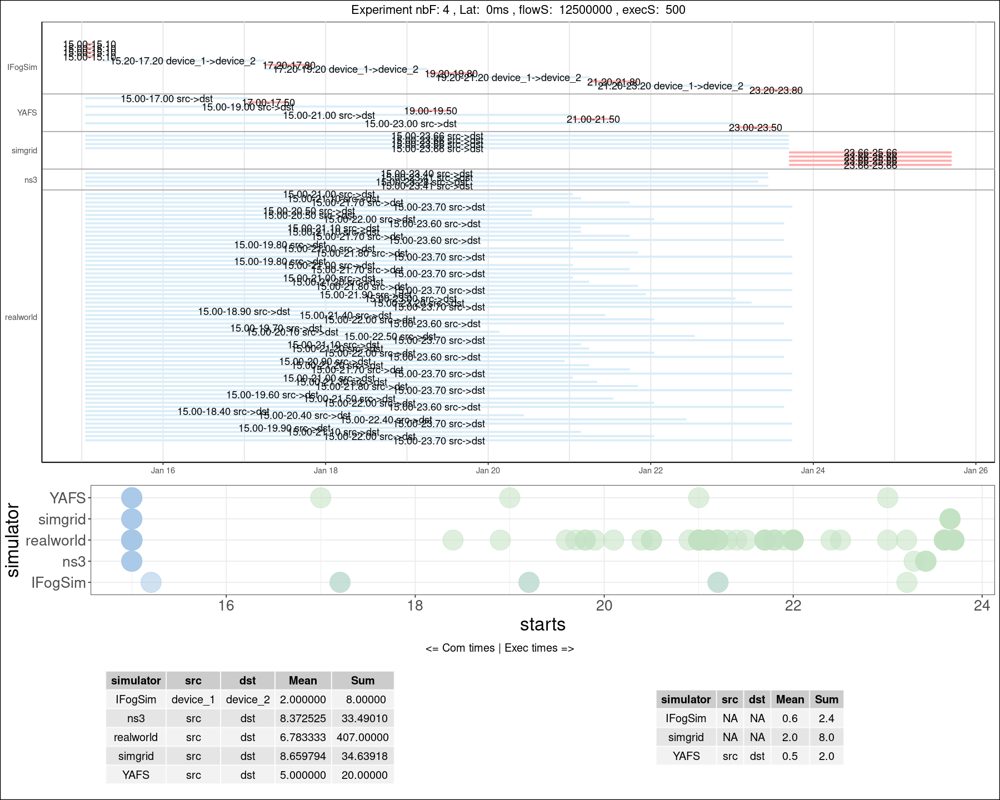

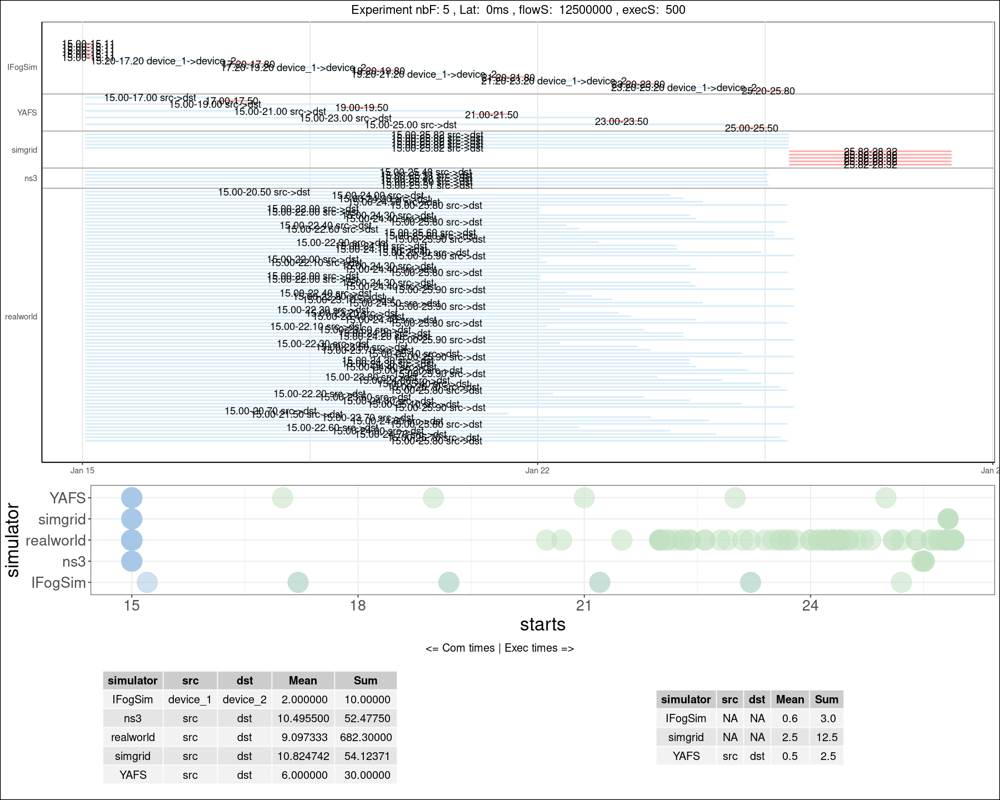

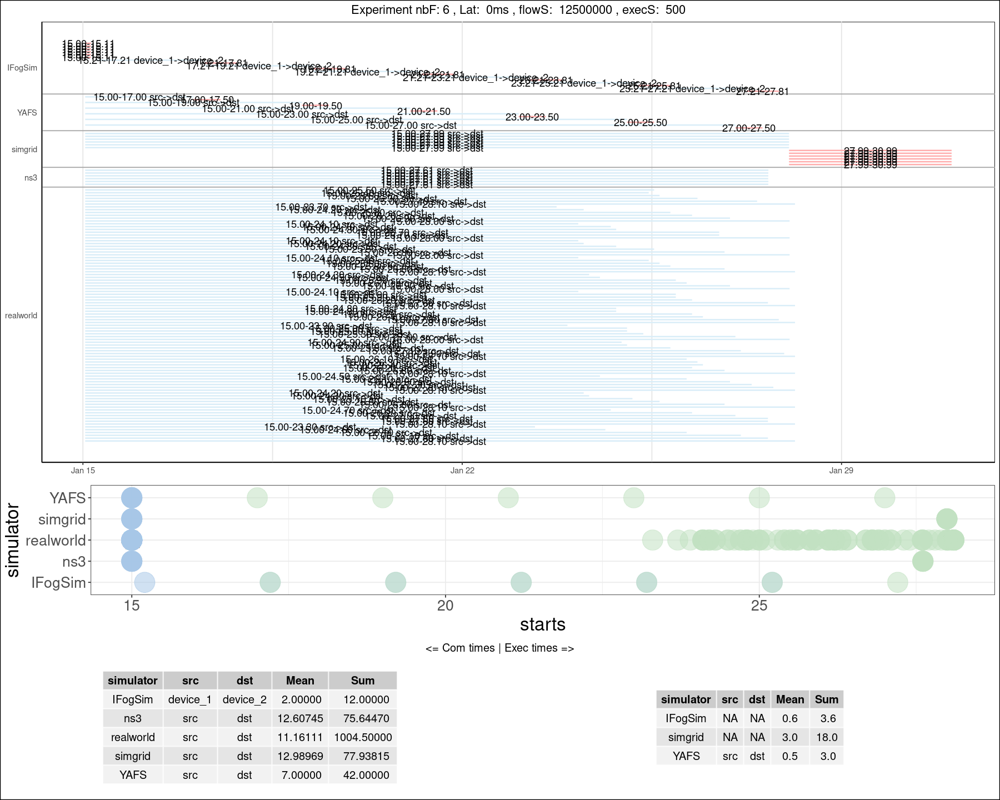

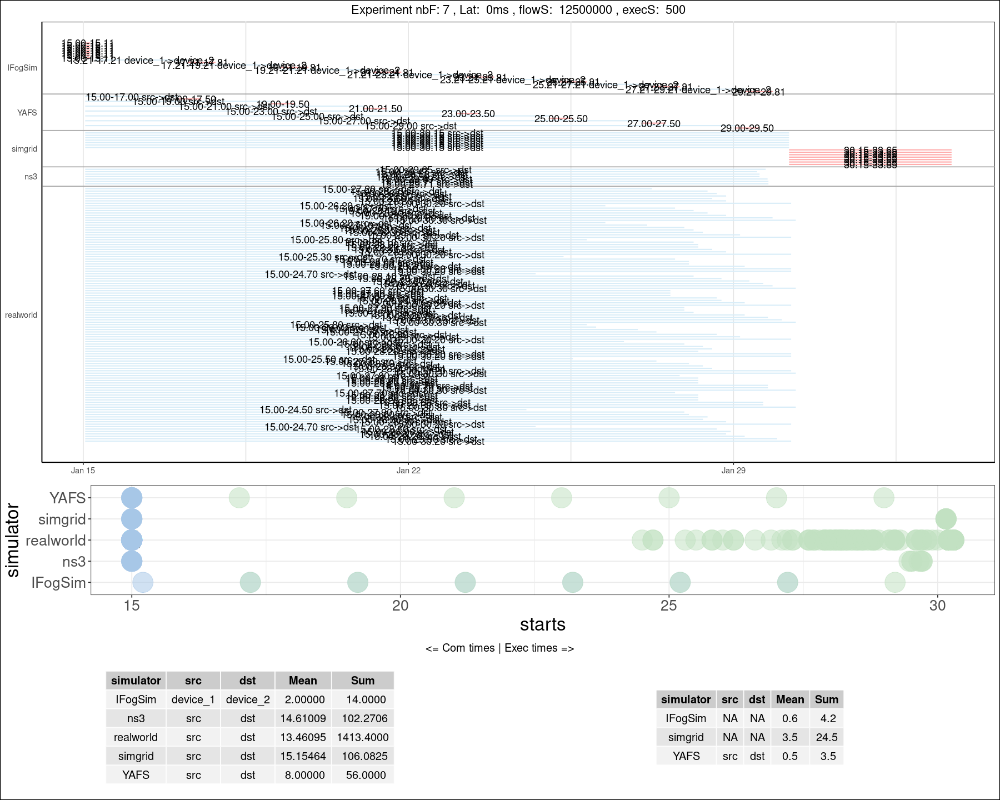

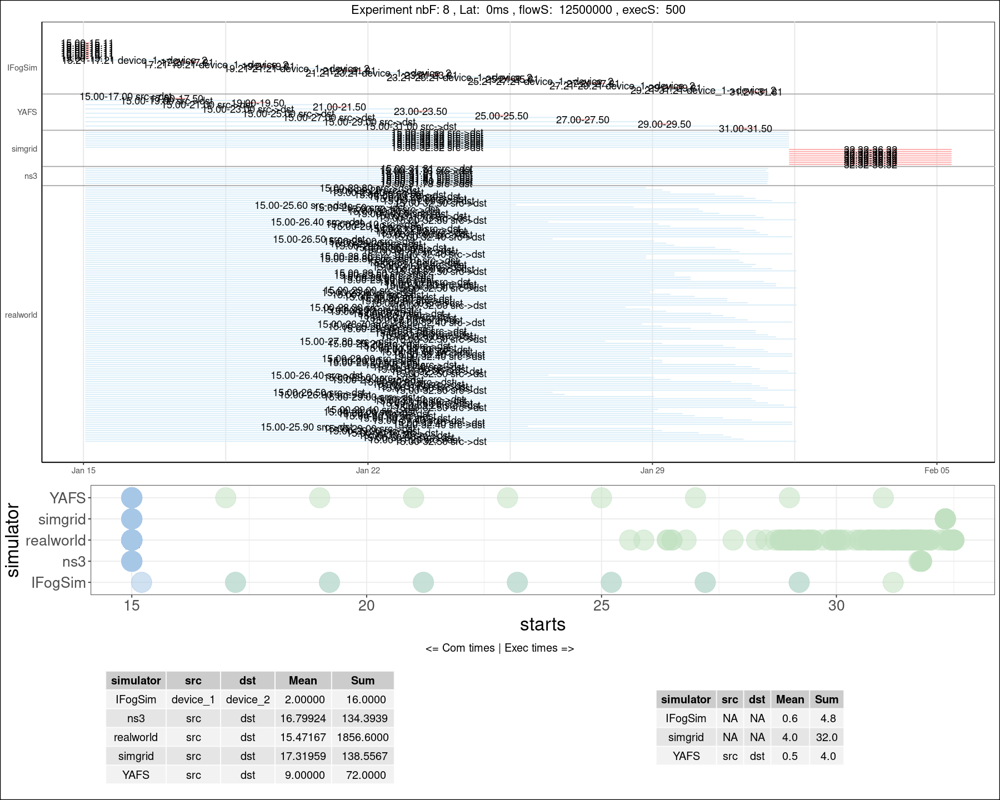

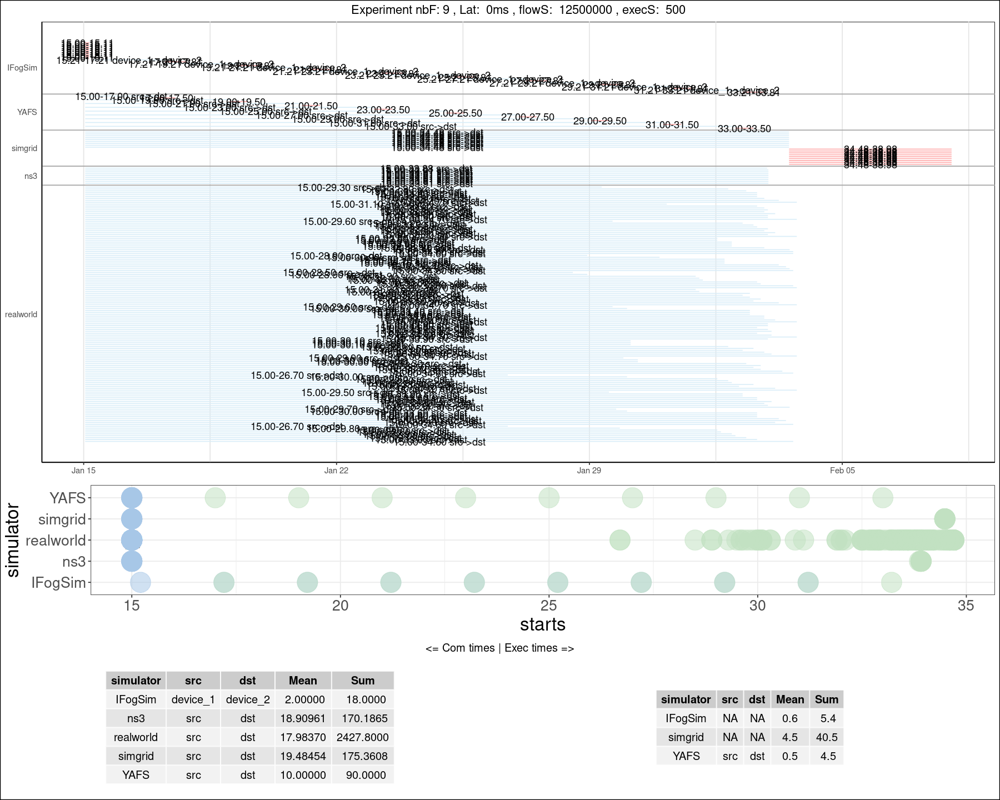

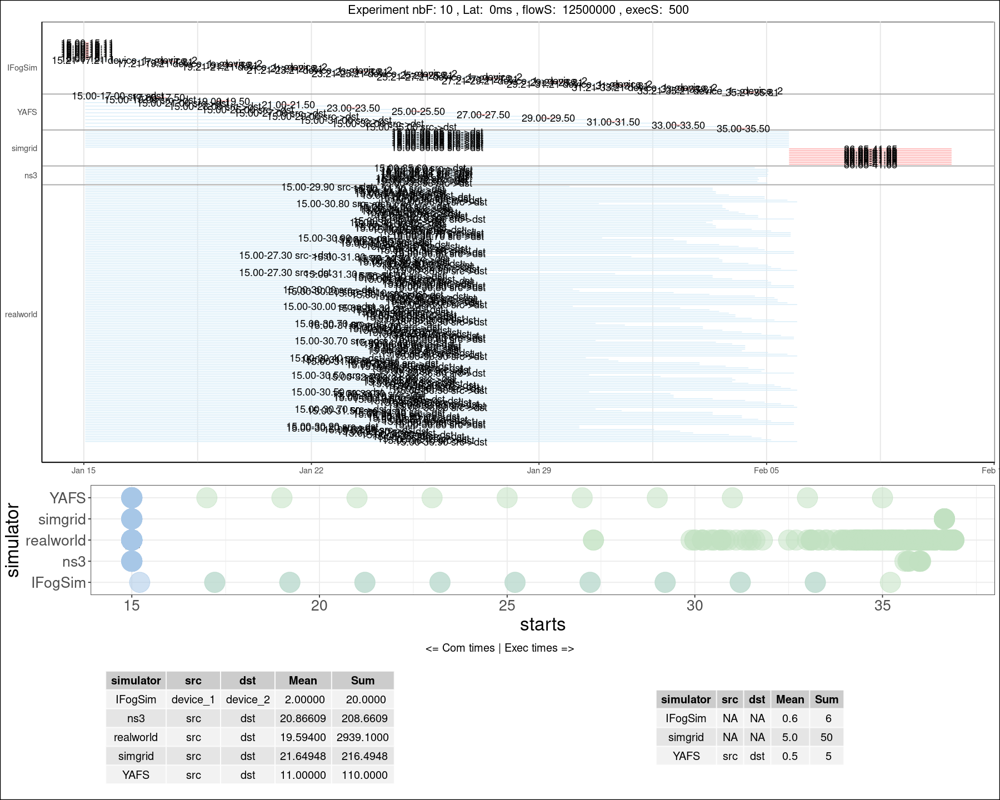

In [3]:

data <- as_tibble(read.csv("./res1Hop-net.csv"))
data2 <- as_tibble(read.csv("./test_rw.csv"))
data <- rbind(data, data2)
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))
    
    dnet <- ds %>% filter(type=="net") %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')

    tbl <- tableGrob(dnet, rows = NULL)
    dstart <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (src=="device_1"),
                                                           simulator!="IFogSim" ~ TRUE))
    dend <- ds %>% filter(type!="exec") %>% filter(case_when(simulator=='IFogSim' ~ (dst=="device_2"),
                                                       simulator!="IFogSim" ~ TRUE))

    # stats exec
    dExec <- ds %>% filter(type=="exec", starts>15) %>% group_by(simulator,src,dst) %>%
        summarize(Mean = mean(ends-starts, na.rm=TRUE), Sum=sum(ends-starts, na.rm=TRUE), .groups = 'drop')
    options(repr.matrix.max.rows=600, repr.matrix.max.cols=200)
    tbl2 <- tableGrob(dExec, rows = NULL)

    
    p2 <- ggplot() + geom_point(data=dstart, aes(x=starts,y=simulator),color="#A7C7E788", size=10)+
        geom_point(data=dend, aes(x=ends,y=simulator), color="#C1E1C188", size=10)+theme_bw()+theme(text = element_text(size = 20))
    grid.arrange(p,p2,grid.arrange(top="<= Com times | Exec times =>",tbl,tbl2,nrow=1), nrow=3, heights=c(3,1,1))
    grid.rect(width = 1, height = 1, gp = gpar(lwd = 2, col = "black", fill = NA))
}




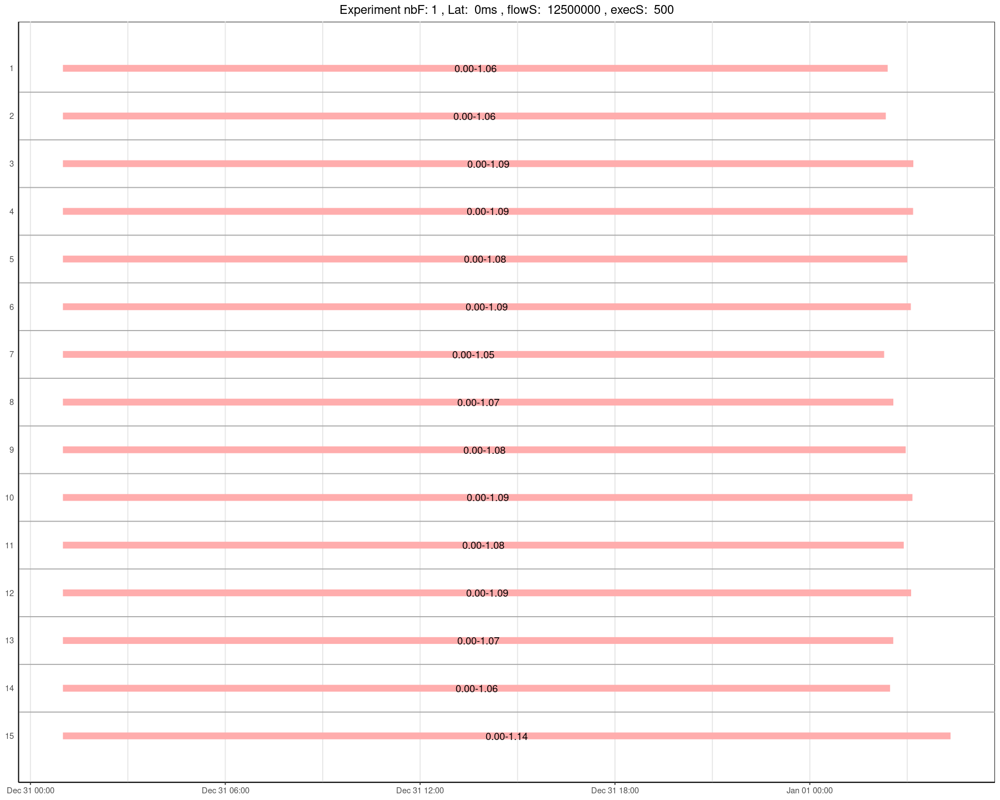

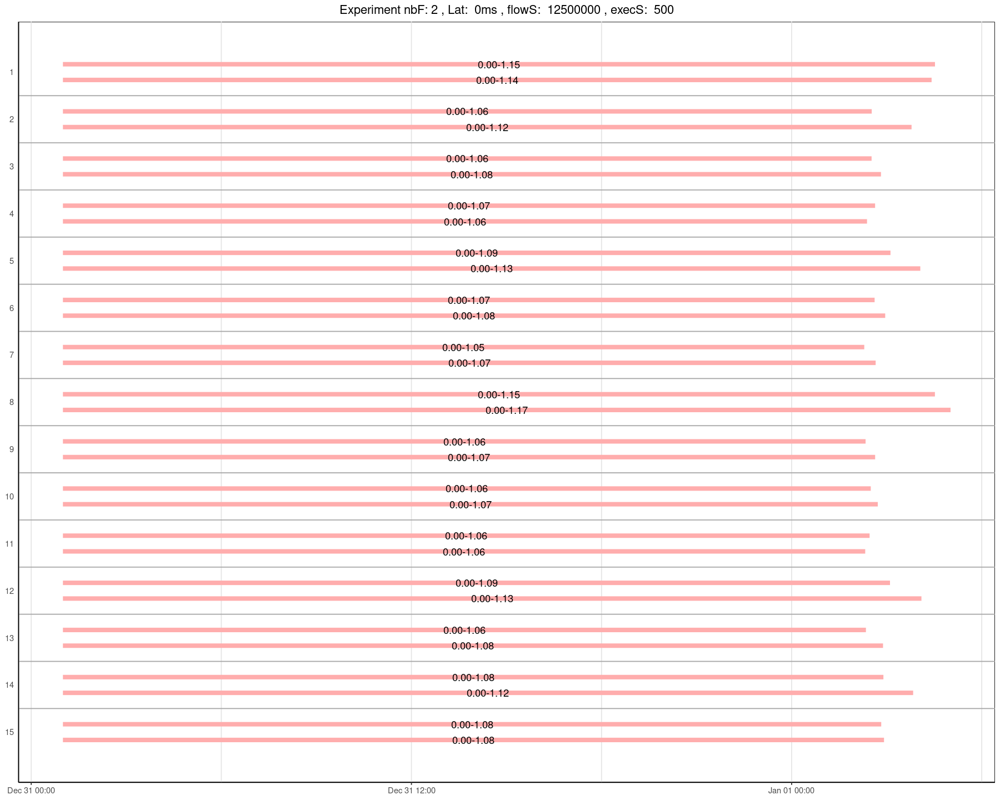

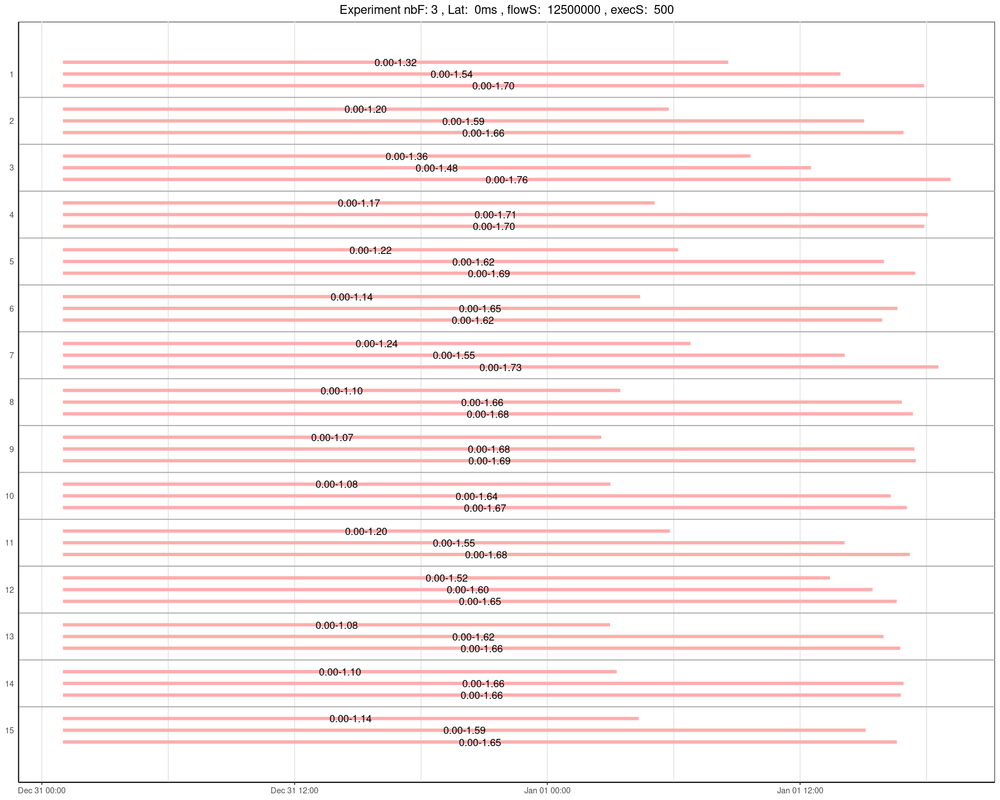

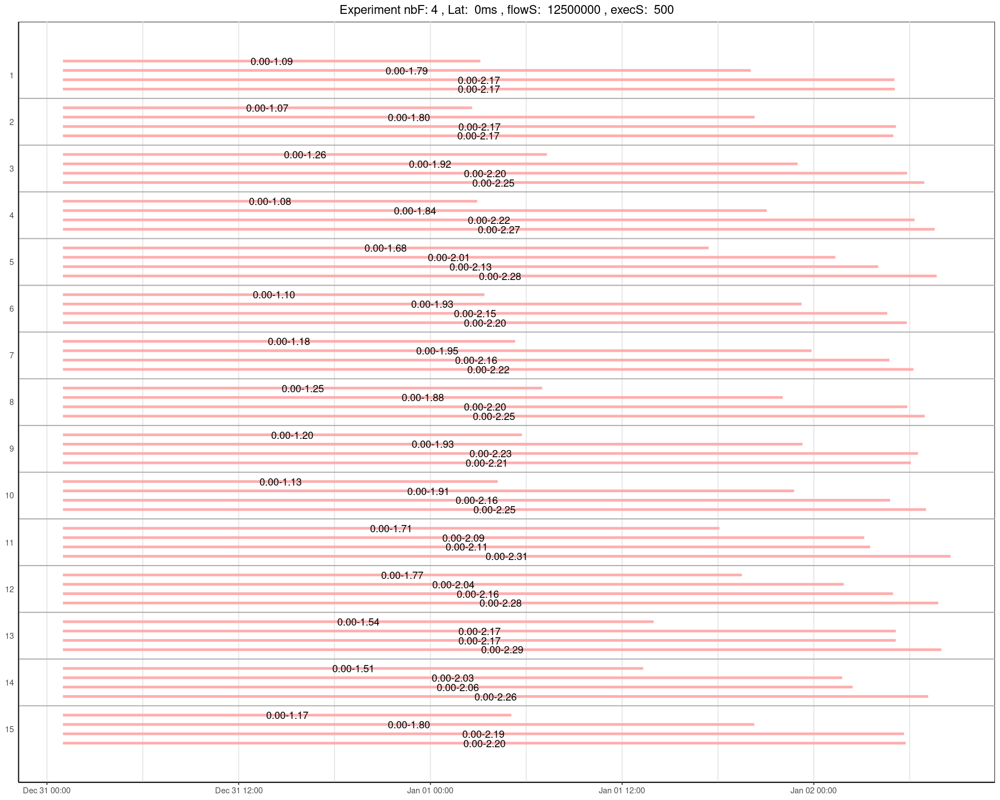

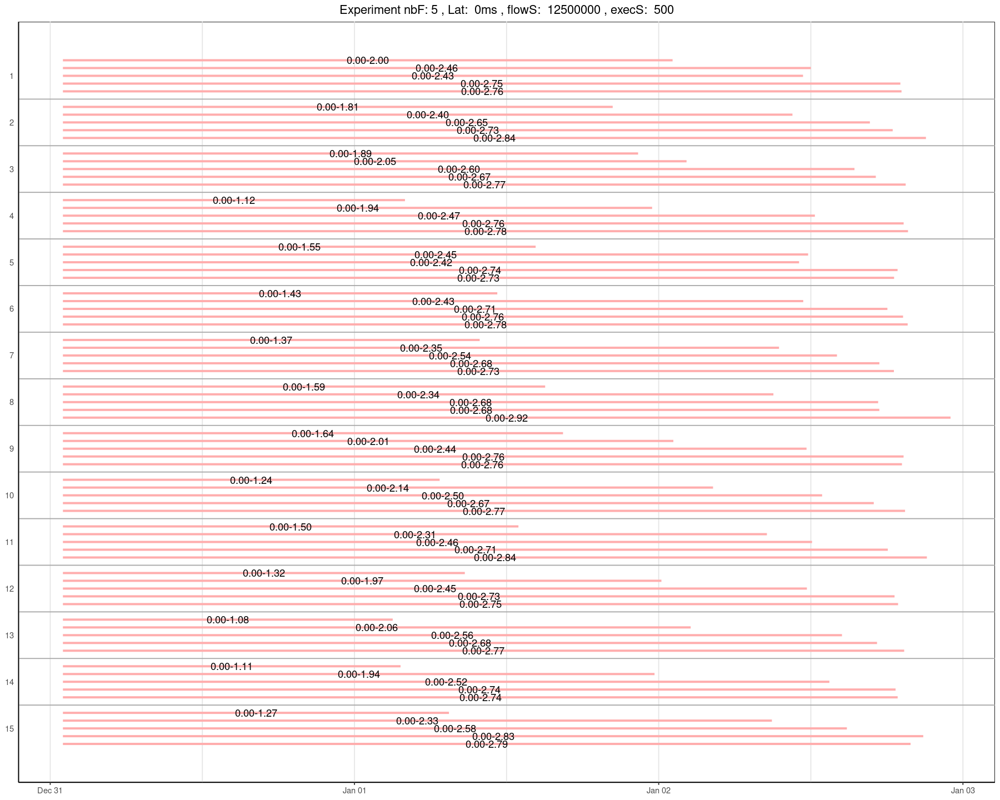

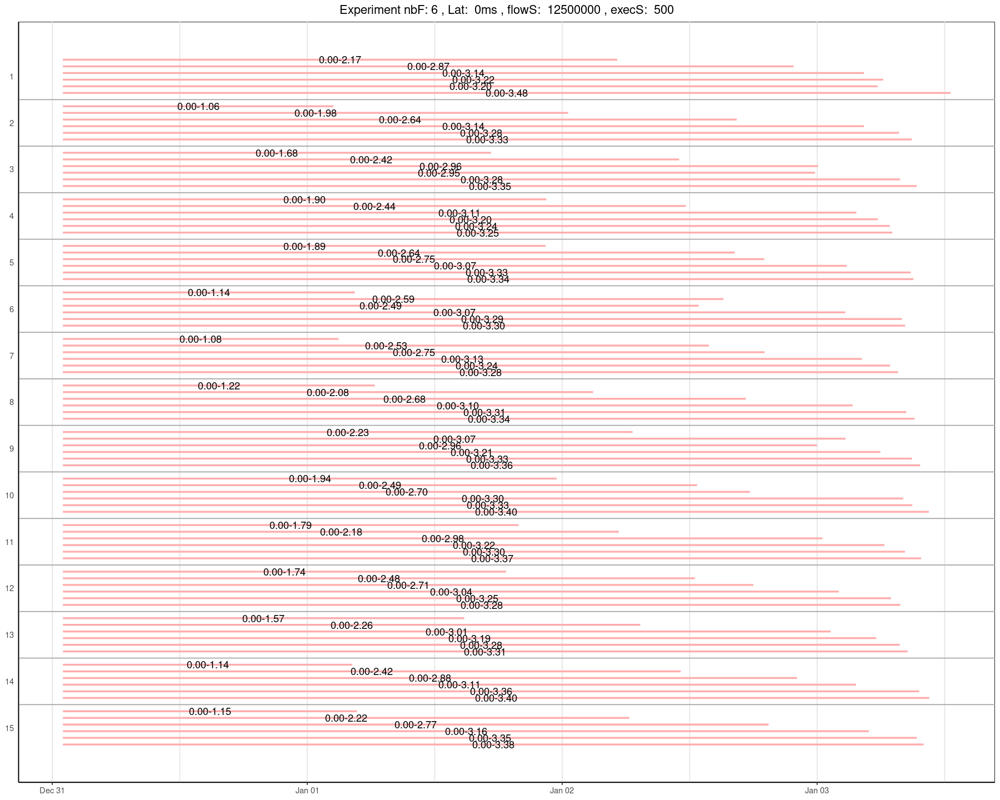

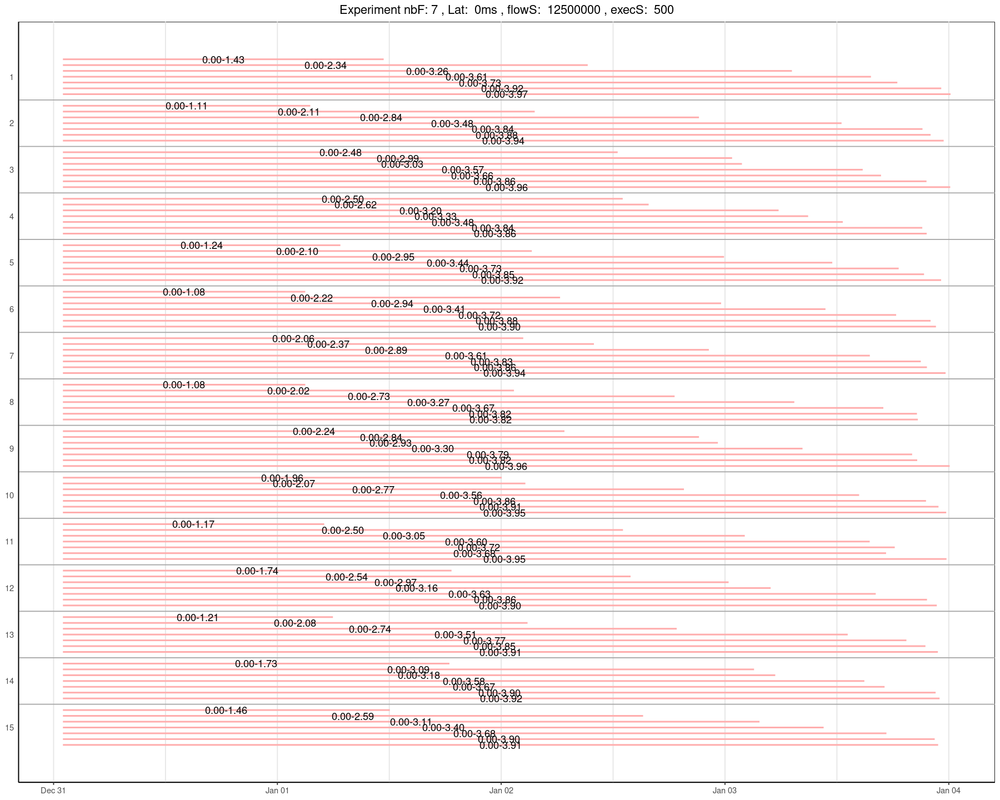

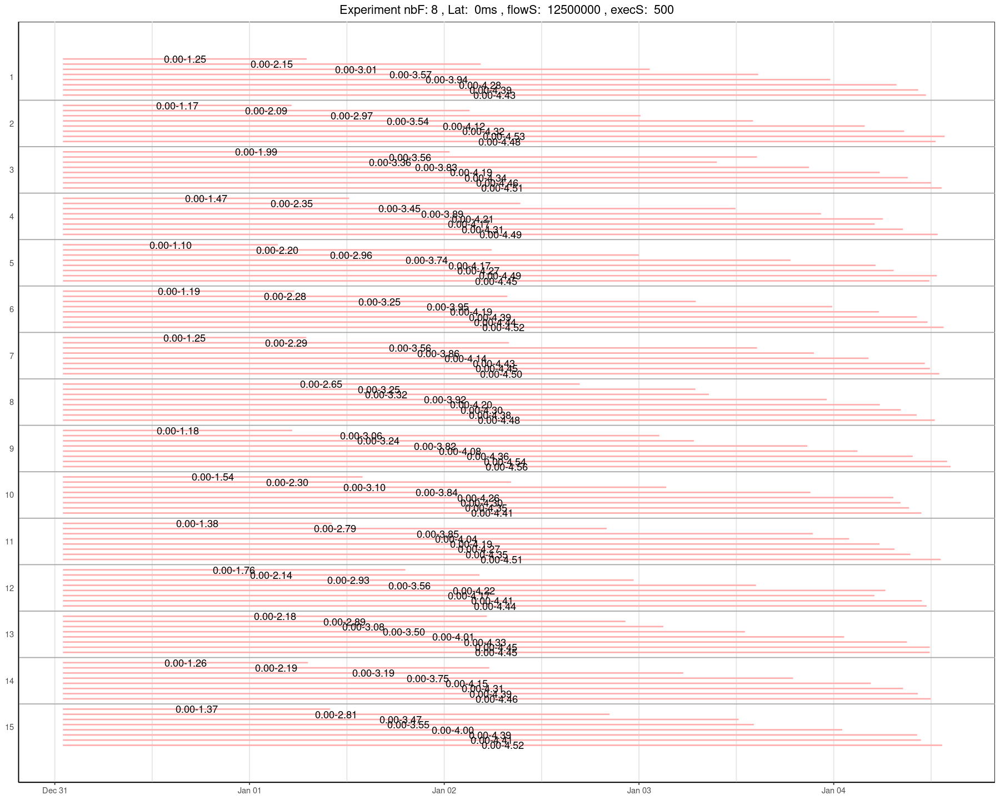

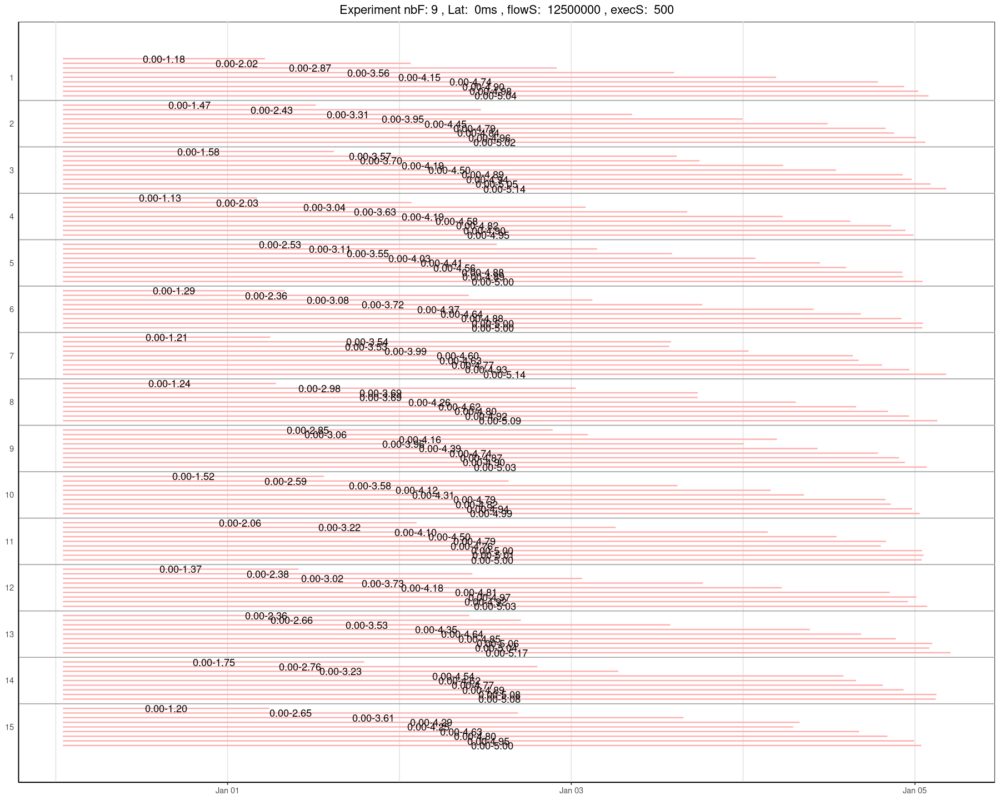

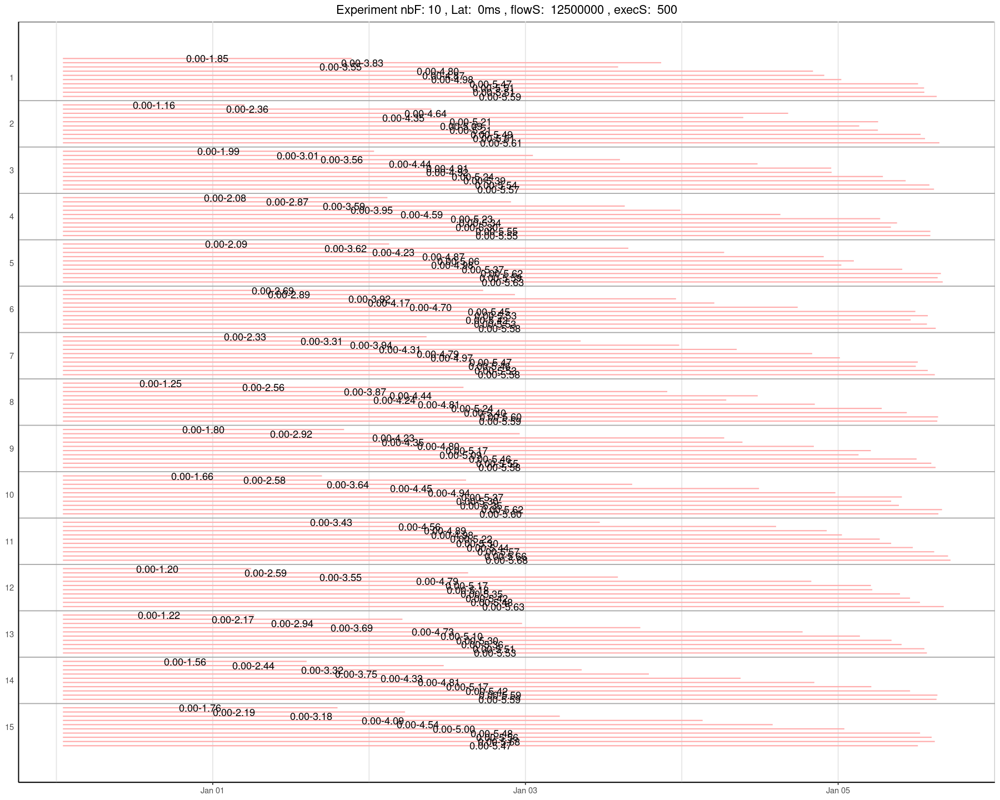

In [22]:


data <- as_tibble(read.csv("./test_rw_exec_sc.csv"))
data <- as_tibble(read.csv("./test_rw_exec_dc.csv"))

data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2)," ",src,"->",dst,sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
#data
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)

options(repr.plot.width=15, repr.plot.height=12)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "seed",
        col.event = "event",
        col.color = "color",
        optimize_y = FALSE,
        title=paste("Experiment nbF:",ds[1,"nbF"],", Lat: ",ds[1,"lat"],", flowS: ",ds[1,"flowS"],", execS: ",ds[1,"execCost"]))


    plot(p)
}




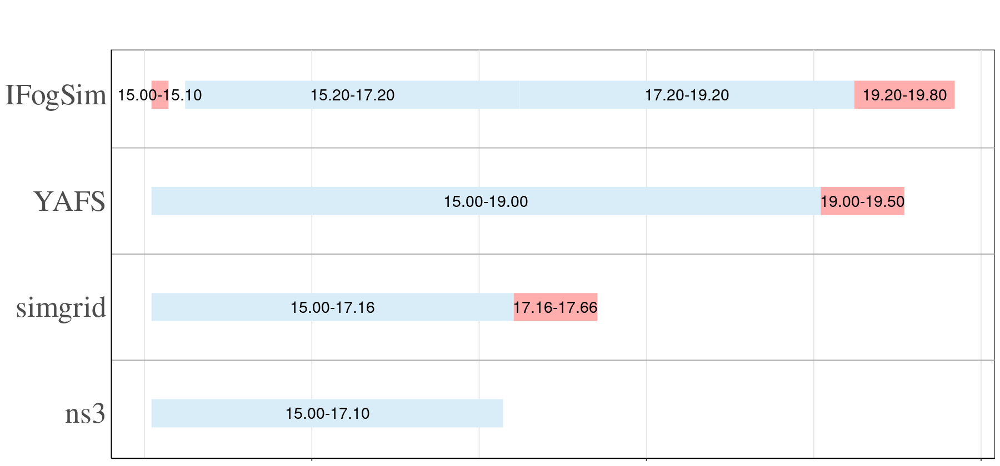

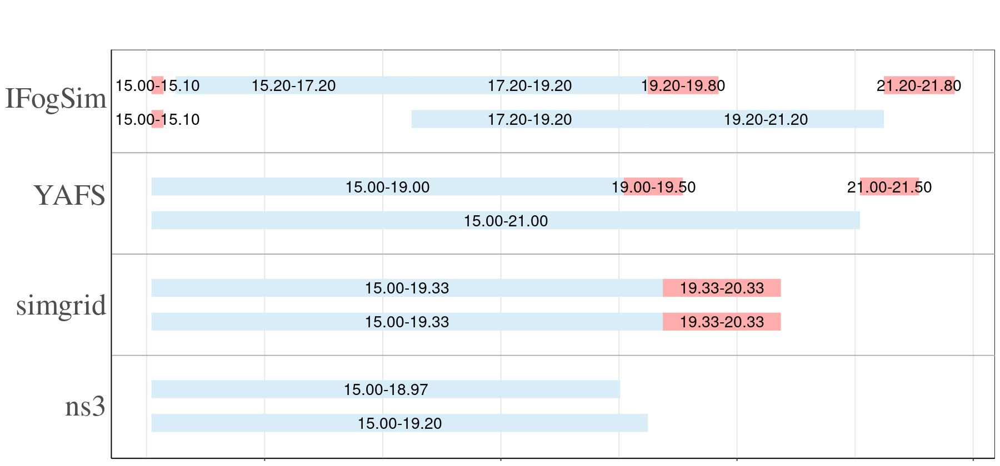

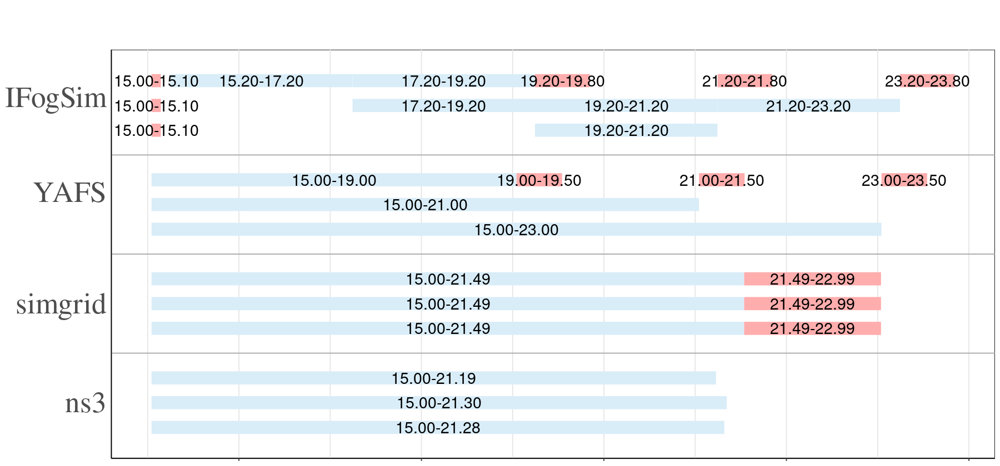

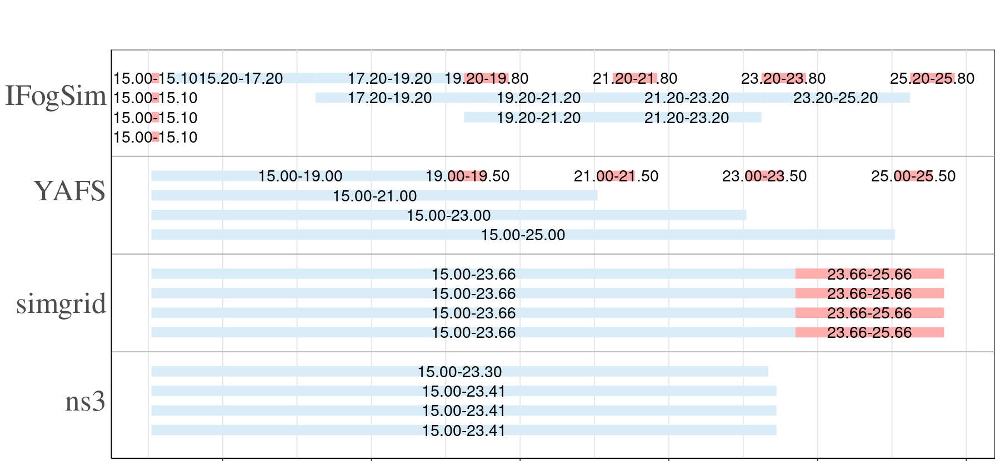

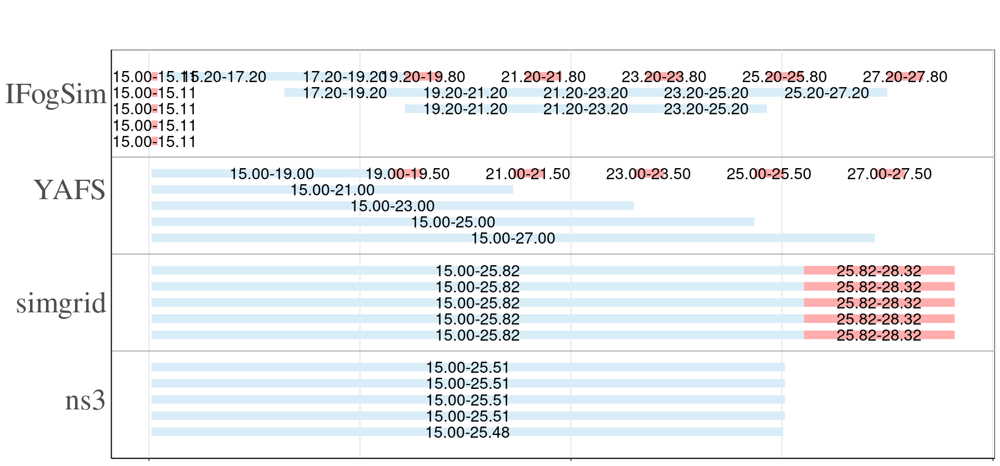

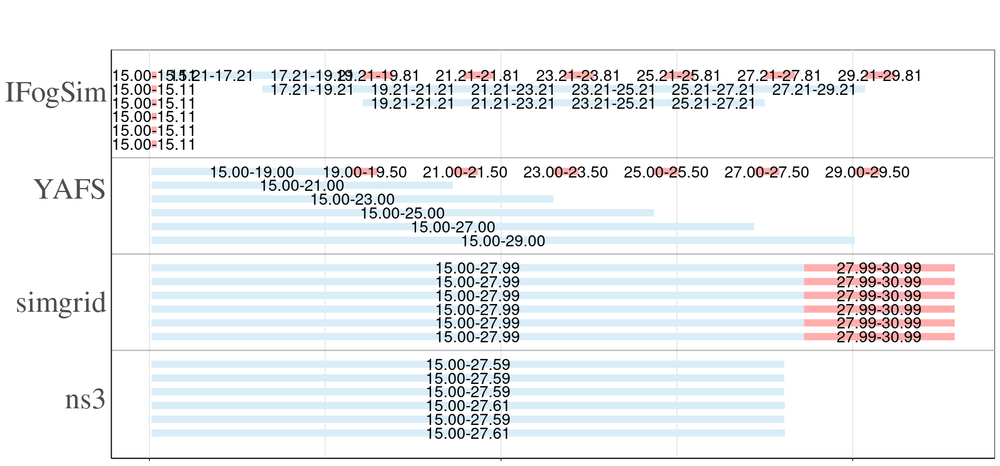

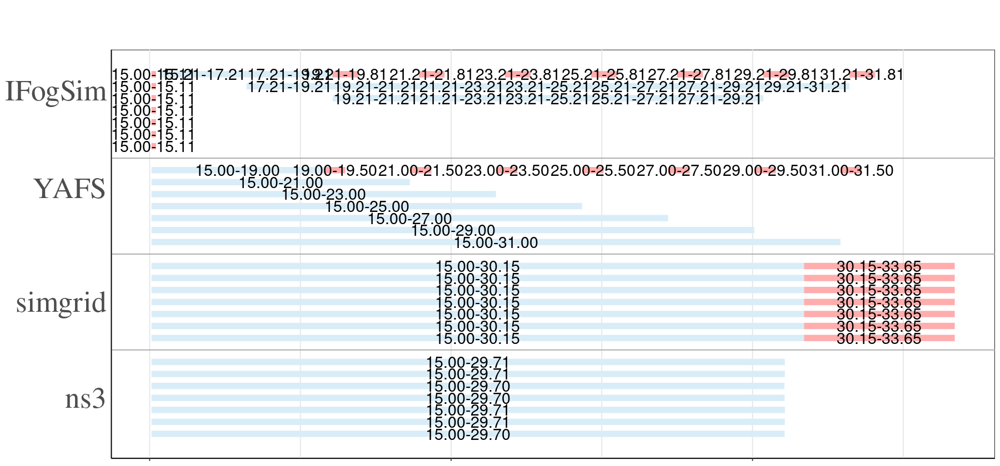

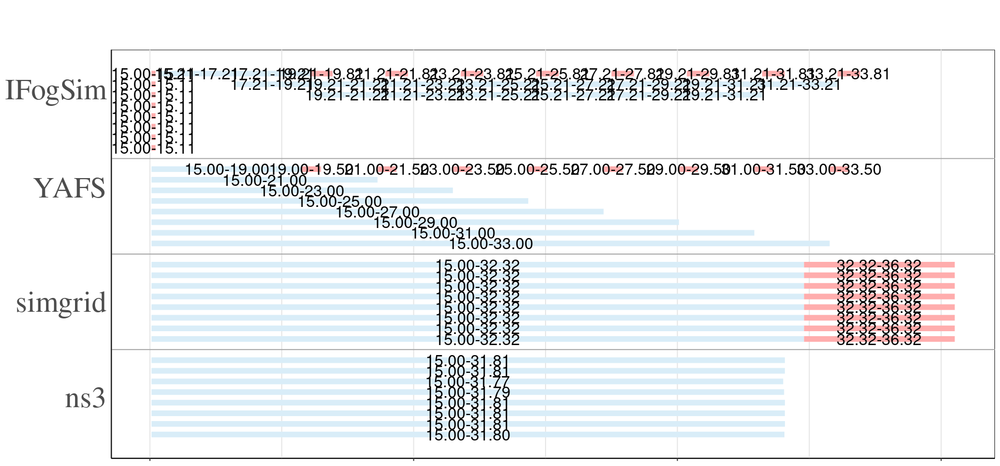

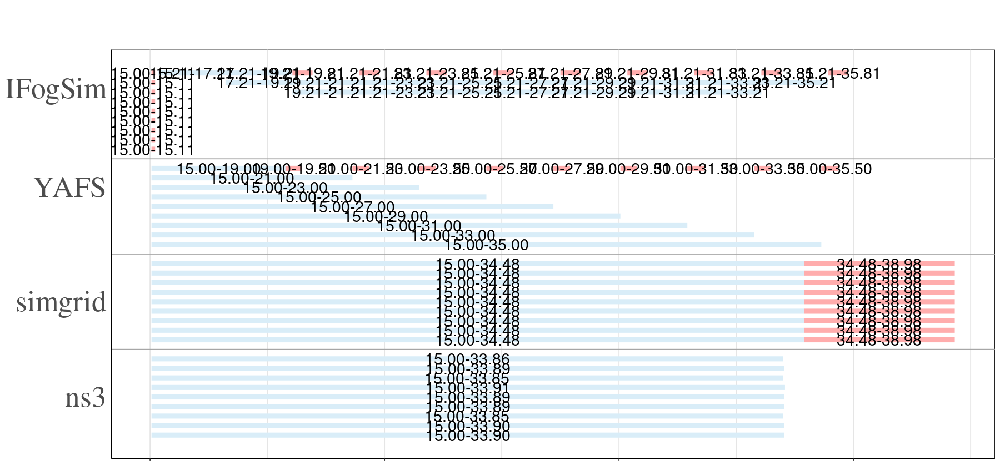

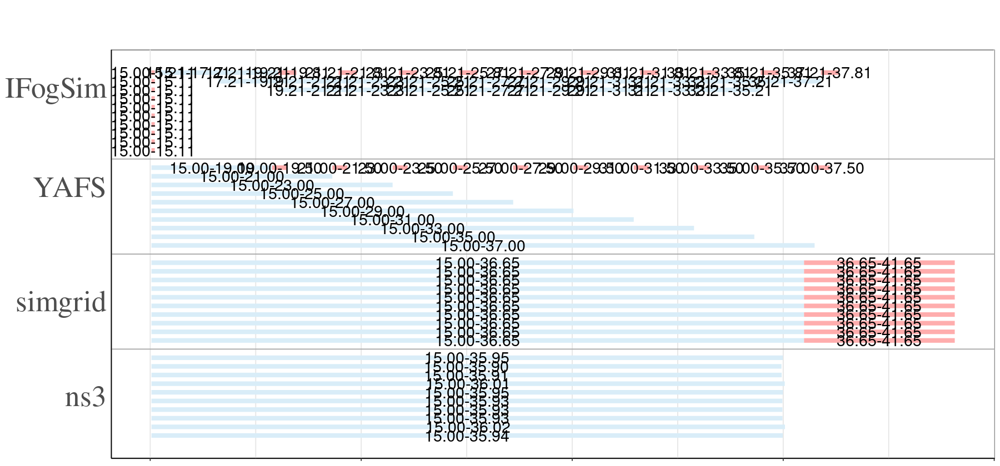

In [68]:

data <- as_tibble(read.csv("./res2Hop-net.csv"))
data <- data %>% mutate(event=ifelse(type == "exec",
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep=""),
                        paste(format(round(start, 2), nsmall = 2),"-",format(round(end, 2), nsmall = 2),sep="")))
data <- data %>% 
  mutate(starts = data$start, ends=data$end)%>%
  mutate(start = as.Date(data$start, origin="2000-12-31"), end = as.Date(data$end, origin="2000-12-31"))%>%
  mutate(color = ifelse(type == "exec","#FFADAD","#D9EDF8"))%>%
  filter(src!="sensor_0" | type=="exec", src!="sensor_1"| type=="exec", src!="sensor_2"| type=="exec", src!="sensor_3"| type=="exec", src!="sensor_4"| type=="exec", src!="sensor_5"| type=="exec", src!="sensor_6" | type=="exec", src!="sensor_7"| type=="exec", src!="sensor_8"| type=="exec", src!="sensor_9"| type=="exec", src!="sensor_10"|type=="exec")
dataS <- data %>% group_by(lat,execCost,flowS, nbF)
dataS <- group_split(dataS)
#print(data)

options(repr.plot.width=15, repr.plot.height=7)

lplots = list()
i = 1
for (ds in dataS)
{
    p <- gg_vistime(ds, col.start="start", 
        col.end="end",
        col.group = "simulator",
        col.event = "event",
        col.color = "color",
        optimize_y = TRUE,
        title="") +   
  theme(text = element_text(size=40, family = "serif"), axis.text.x=element_blank())
  p$layers[[4]]$aes_params$size <- 6
    plot(p)
}
